In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import textwrap
import warnings
warnings.filterwarnings('ignore')

In [4]:
spotify = pd.read_csv('spotify_tracks.csv')
data_description = pd.read_csv('spotify_data_description.csv')

In [7]:
data_description

,Column Name,Description
0,track_id,A unique identifier for the track on Spotify.
1,track_name,The title of the song.
2,artist_name,The name of the artist(s) who performed the song.
3,year,The release year of the song.
4,popularity,"A measure of how popular a track is, ranging f..."
5,artwork_url,A URL pointing to the album artwork for the tr...
6,album_name,The name of the album the track belongs to.
7,acousticness,A confidence measure indicating whether the tr...
8,danceability,A measure of how suitable a track is for danci...
9,duration_ms,The duration of the track in milliseconds.


In [10]:
spotify.shape

(62317, 27)

In [13]:
# Top 5 rows
spotify.head()

,track_id,track_name,artist_name,year,popularity,artwork_url,album_name,acousticness,danceability,duration_ms,...,tempo,time_signature,valence,track_url,language,popularity_bucket,PC1,PC2,PC3,cluster
0,2r0ROhr7pRN4MXDMT1fEmd,"Leo Das Entry (From ""Leo"")",Anirudh Ravichander,2024,59,https://i.scdn.co/image/ab67616d0000b273ce9c65...,"Leo Das Entry (From ""Leo"")",0.0241,0.753,97297.0,...,110.997,4.0,0.459,https://open.spotify.com/track/2r0ROhr7pRN4MXD...,Tamil,41-60,-1.342800,-0.520260,-0.361765,4
1,4I38e6Dg52a2o2a8i5Q5PW,AAO KILLELLE,"Anirudh Ravichander, Pravin Mani, Vaishali Sri...",2024,47,https://i.scdn.co/image/ab67616d0000b273be1b03...,AAO KILLELLE,0.0851,0.780,207369.0,...,164.995,3.0,0.821,https://open.spotify.com/track/4I38e6Dg52a2o2a...,Tamil,41-60,-2.014332,-0.369601,0.011681,1
2,59NoiRhnom3lTeRFaBzOev,Mayakiriye Sirikiriye - Orchestral EDM,"Anirudh Ravichander, Anivee, Alvin Bruno",2024,35,https://i.scdn.co/image/ab67616d0000b27334a1dd...,Mayakiriye Sirikiriye (Orchestral EDM),0.0311,0.457,82551.0,...,169.996,4.0,0.598,https://open.spotify.com/track/59NoiRhnom3lTeR...,Tamil,21-40,-0.264179,-0.794272,-0.994757,4
3,5uUqRQd385pvLxC8JX3tXn,Scene Ah Scene Ah - Experimental EDM Mix,"Anirudh Ravichander, Bharath Sankar, Kabilan, ...",2024,24,https://i.scdn.co/image/ab67616d0000b27332e623...,Scene Ah Scene Ah (Experimental EDM Mix),0.2270,0.718,115831.0,...,169.996,4.0,0.362,https://open.spotify.com/track/5uUqRQd385pvLxC...,Tamil,21-40,-0.978450,0.467098,-2.626894,0
4,1KaBRg2xgNeCljmyxBH1mo,Gundellonaa X I Am A Disco Dancer - Mashup,"Anirudh Ravichander, Benny Dayal, Leon James, ...",2024,22,https://i.scdn.co/image/ab67616d0000b2735a59b6...,Gundellonaa X I Am a Disco Dancer (Mashup),0.0153,0.689,129621.0,...,128.961,4.0,0.593,https://open.spotify.com/track/1KaBRg2xgNeCljm...,Tamil,21-40,-1.423365,-0.714373,-1.202821,4


In [16]:
# Bottom 5 rows
spotify.tail()

,track_id,track_name,artist_name,year,popularity,artwork_url,album_name,acousticness,danceability,duration_ms,...,tempo,time_signature,valence,track_url,language,popularity_bucket,PC1,PC2,PC3,cluster
62312,3eHDwMQYPEziy2DWRBNoLv,Sani - G.O.A.T Remix,"Arvind Raj, Sheezay, Music Kitchen, FSPROD Vin...",2021,30,https://i.scdn.co/image/ab67616d0000b273819d23...,Sani (G.O.A.T Remix),0.08490,0.877,359718.0,...,100.024,4.0,0.504,https://open.spotify.com/track/3eHDwMQYPEziy2D...,Tamil,21-40,-1.231267,1.770880,-0.501572,1
62313,5hHtCqkNv5eo99OrEFFcgS,Life of Bachelor,"A H Kaashif, Navakkarai Naveen Prabanjam, Asal...",2021,30,https://i.scdn.co/image/ab67616d0000b2736cd651...,Bachelor (Original Motion Picture Soundtrack),0.07880,0.833,154364.0,...,110.041,4.0,0.524,https://open.spotify.com/track/5hHtCqkNv5eo99O...,Tamil,21-40,-1.246871,-0.211071,-0.397002,1
62314,08foF9YHgKmIgOy3xMWRZy,Yo Baby,"Rakesh Ambigapathy, Asal Kolaar, MC Vickey",2021,18,https://i.scdn.co/image/ab67616d0000b27300da25...,Yo Baby,0.00918,0.842,234000.0,...,122.038,4.0,0.669,https://open.spotify.com/track/08foF9YHgKmIgOy...,Tamil,0-20,-1.802180,0.276486,0.147055,1
62315,2wLFbVlQGKJSd9lwzwL47F,Fast Fast Vadiley,"Asal Kolaar, Priyadarshan Balasubramanian",2021,1,https://i.scdn.co/image/ab67616d0000b273e051e1...,Arjuna Phalguna,0.10100,0.682,180807.0,...,74.993,4.0,0.439,https://open.spotify.com/track/2wLFbVlQGKJSd9l...,Tamil,0-20,-1.200654,0.397561,-1.381202,1
62316,5OYxwYeFfumMTAoAdVeet3,"Moonu Moonu Moonu (From ""3:33"")","Harshavardhan Rameshwar, G. V. Prakash, Dharma...",2021,1,https://i.scdn.co/image/ab67616d0000b273efd671...,"Moonu Moonu Moonu (From ""3:33"")",0.18600,0.817,202667.0,...,89.975,4.0,0.837,https://open.spotify.com/track/5OYxwYeFfumMTAo...,Tamil,0-20,-2.134159,0.194929,-0.532886,1


In [19]:
# Complete details(columns) of 1st row
spotify.head(1).T

,0
track_id,2r0ROhr7pRN4MXDMT1fEmd
track_name,"Leo Das Entry (From ""Leo"")"
artist_name,Anirudh Ravichander
year,2024
popularity,59
artwork_url,https://i.scdn.co/image/ab67616d0000b273ce9c65...
album_name,"Leo Das Entry (From ""Leo"")"
acousticness,0.0241
danceability,0.753
duration_ms,97297.0


In [22]:
spotify.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62317 entries, 0 to 62316
Data columns (total 27 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   track_id           62317 non-null  object 
 1   track_name         62317 non-null  object 
 2   artist_name        62317 non-null  object 
 3   year               62317 non-null  int64  
 4   popularity         62317 non-null  int64  
 5   artwork_url        62317 non-null  object 
 6   album_name         62317 non-null  object 
 7   acousticness       62317 non-null  float64
 8   danceability       62317 non-null  float64
 9   duration_ms        62317 non-null  float64
 10  energy             62317 non-null  float64
 11  instrumentalness   62317 non-null  float64
 12  key                62317 non-null  float64
 13  liveness           62317 non-null  float64
 14  loudness           62317 non-null  float64
 15  mode               62317 non-null  float64
 16  speechiness        623

In [25]:
# Convert year (int64) into datetime (YYYY-01-01)
spotify["year"] = pd.to_datetime(spotify["year"], format="%Y")

In [28]:
# Duration in seconds
spotify["duration_sec"] = spotify["duration_ms"] / 1000

In [31]:
# Energy-to-Danceability Ratio
spotify["energy_dance_ratio"] = spotify["energy"] / (spotify["danceability"] + 1e-6)

In [34]:
# Decade
spotify["decade"] = ((spotify["year"].dt.year // 10) * 10).astype("int64")

In [37]:
# Mood Category (based on valence & energy)
def mood_category(row):
    if row["valence"] >= 0.5 and row["energy"] >= 0.5:
        return "Happy/Excited"
    elif row["valence"] < 0.5 and row["energy"] >= 0.5:
        return "Angry/Intense"
    elif row["valence"] < 0.5 and row["energy"] < 0.5:
        return "Sad/Calm"
    else:
        return "Peaceful/Chill"

spotify["mood"] = spotify.apply(mood_category, axis=1)


In [40]:
# Remove rows where language is "Unknown"
spotify = spotify[spotify["language"] != "Unknown"].reset_index(drop=True)

In [43]:
# Define invalid conditions
invalid_condition = (
    (spotify['key'] == -1) |
    (spotify['mode'] == -1) |
    (spotify['tempo'] == -1) |
    (spotify['time_signature'] == -1) |
    (spotify['loudness'] == -100000)  # unrealistic loudness
)

# Extract invalid rows
invalid_rows = spotify[invalid_condition]

# Print number of invalid rows and the rows themselves
print(f"Number of invalid rows: {len(invalid_rows)}")


Number of invalid rows: 35


In [46]:
# Keep only valid rows
spotify = spotify[~invalid_condition].reset_index(drop=True)

In [49]:
spotify.shape

(49277, 31)

In [52]:
spotify.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49277 entries, 0 to 49276
Data columns (total 31 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   track_id            49277 non-null  object        
 1   track_name          49277 non-null  object        
 2   artist_name         49277 non-null  object        
 3   year                49277 non-null  datetime64[ns]
 4   popularity          49277 non-null  int64         
 5   artwork_url         49277 non-null  object        
 6   album_name          49277 non-null  object        
 7   acousticness        49277 non-null  float64       
 8   danceability        49277 non-null  float64       
 9   duration_ms         49277 non-null  float64       
 10  energy              49277 non-null  float64       
 11  instrumentalness    49277 non-null  float64       
 12  key                 49277 non-null  float64       
 13  liveness            49277 non-null  float64   

In [55]:
# Top 5 rows
spotify.head()

,track_id,track_name,artist_name,year,popularity,artwork_url,album_name,acousticness,danceability,duration_ms,...,language,popularity_bucket,PC1,PC2,PC3,cluster,duration_sec,energy_dance_ratio,decade,mood
0,2r0ROhr7pRN4MXDMT1fEmd,"Leo Das Entry (From ""Leo"")",Anirudh Ravichander,2024-01-01,59,https://i.scdn.co/image/ab67616d0000b273ce9c65...,"Leo Das Entry (From ""Leo"")",0.0241,0.753,97297.0,...,Tamil,41-60,-1.342800,-0.520260,-0.361765,4,97.297,1.288179,2020,Angry/Intense
1,4I38e6Dg52a2o2a8i5Q5PW,AAO KILLELLE,"Anirudh Ravichander, Pravin Mani, Vaishali Sri...",2024-01-01,47,https://i.scdn.co/image/ab67616d0000b273be1b03...,AAO KILLELLE,0.0851,0.780,207369.0,...,Tamil,41-60,-2.014332,-0.369601,0.011681,1,207.369,1.016665,2020,Happy/Excited
2,59NoiRhnom3lTeRFaBzOev,Mayakiriye Sirikiriye - Orchestral EDM,"Anirudh Ravichander, Anivee, Alvin Bruno",2024-01-01,35,https://i.scdn.co/image/ab67616d0000b27334a1dd...,Mayakiriye Sirikiriye (Orchestral EDM),0.0311,0.457,82551.0,...,Tamil,21-40,-0.264179,-0.794272,-0.994757,4,82.551,1.074396,2020,Peaceful/Chill
3,5uUqRQd385pvLxC8JX3tXn,Scene Ah Scene Ah - Experimental EDM Mix,"Anirudh Ravichander, Bharath Sankar, Kabilan, ...",2024-01-01,24,https://i.scdn.co/image/ab67616d0000b27332e623...,Scene Ah Scene Ah (Experimental EDM Mix),0.2270,0.718,115831.0,...,Tamil,21-40,-0.978450,0.467098,-2.626894,0,115.831,0.877436,2020,Angry/Intense
4,1KaBRg2xgNeCljmyxBH1mo,Gundellonaa X I Am A Disco Dancer - Mashup,"Anirudh Ravichander, Benny Dayal, Leon James, ...",2024-01-01,22,https://i.scdn.co/image/ab67616d0000b2735a59b6...,Gundellonaa X I Am a Disco Dancer (Mashup),0.0153,0.689,129621.0,...,Tamil,21-40,-1.423365,-0.714373,-1.202821,4,129.621,1.085630,2020,Happy/Excited


In [58]:
# Bottom 5 rows
spotify.tail()

,track_id,track_name,artist_name,year,popularity,artwork_url,album_name,acousticness,danceability,duration_ms,...,language,popularity_bucket,PC1,PC2,PC3,cluster,duration_sec,energy_dance_ratio,decade,mood
49272,3eHDwMQYPEziy2DWRBNoLv,Sani - G.O.A.T Remix,"Arvind Raj, Sheezay, Music Kitchen, FSPROD Vin...",2021-01-01,30,https://i.scdn.co/image/ab67616d0000b273819d23...,Sani (G.O.A.T Remix),0.08490,0.877,359718.0,...,Tamil,21-40,-1.231267,1.770880,-0.501572,1,359.718,0.534777,2020,Peaceful/Chill
49273,5hHtCqkNv5eo99OrEFFcgS,Life of Bachelor,"A H Kaashif, Navakkarai Naveen Prabanjam, Asal...",2021-01-01,30,https://i.scdn.co/image/ab67616d0000b2736cd651...,Bachelor (Original Motion Picture Soundtrack),0.07880,0.833,154364.0,...,Tamil,21-40,-1.246871,-0.211071,-0.397002,1,154.364,0.827130,2020,Happy/Excited
49274,08foF9YHgKmIgOy3xMWRZy,Yo Baby,"Rakesh Ambigapathy, Asal Kolaar, MC Vickey",2021-01-01,18,https://i.scdn.co/image/ab67616d0000b27300da25...,Yo Baby,0.00918,0.842,234000.0,...,Tamil,0-20,-1.802180,0.276486,0.147055,1,234.000,0.908550,2020,Happy/Excited
49275,2wLFbVlQGKJSd9lwzwL47F,Fast Fast Vadiley,"Asal Kolaar, Priyadarshan Balasubramanian",2021-01-01,1,https://i.scdn.co/image/ab67616d0000b273e051e1...,Arjuna Phalguna,0.10100,0.682,180807.0,...,Tamil,0-20,-1.200654,0.397561,-1.381202,1,180.807,1.262461,2020,Angry/Intense
49276,5OYxwYeFfumMTAoAdVeet3,"Moonu Moonu Moonu (From ""3:33"")","Harshavardhan Rameshwar, G. V. Prakash, Dharma...",2021-01-01,1,https://i.scdn.co/image/ab67616d0000b273efd671...,"Moonu Moonu Moonu (From ""3:33"")",0.18600,0.817,202667.0,...,Tamil,0-20,-2.134159,0.194929,-0.532886,1,202.667,1.105262,2020,Happy/Excited


In [61]:
print("Distribution of Numerical Variables:\n")

num_col = ['popularity', 'duration_sec', 'key', 'tempo', 'acousticness', 'loudness', 'danceability', 'energy', 'time_signature', 'speechiness', 'valence', 'instrumentalness', 'liveness', 'mode', 'decade', 'energy_dance_ratio']

i = 1

for col in num_col:
    print(f"{i}. Distribution of {col.upper()}\n")
    i += 1
    # Central tendency
    print(f"Mean      : {spotify[col].mean():.2f}")
    print(f"Median    : {spotify[col].median():.2f}")

    if col in ['popularity', 'key', 'mode', 'time_signature', 'decade', 'energy']:
        print(f"Mode      : {spotify[col].mode().tolist()}")

    # Dispersion
    print(f"Std Dev   : {spotify[col].std():.2f}")
    print(f"Min       : {spotify[col].min():.4f}")
    print(f"25% (Q1)  : {spotify[col].quantile(0.25):.2f}")
    print(f"50% (Q2)  : {spotify[col].quantile(0.50):.2f}")  # same as median
    print(f"75% (Q3)  : {spotify[col].quantile(0.75):.2f}")
    print(f"Max       : {spotify[col].max():.4f}")

    # Skewness & Kurtosis
    print(f"Skewness  : {spotify[col].skew():.2f}")
    print(f"Kurtosis  : {spotify[col].kurt():.2f}")

    print("="*60)
    print()


Distribution of Numerical Variables:

1. Distribution of POPULARITY

Mean      : 16.18
Median    : 8.00
Mode      : [0]
Std Dev   : 19.08
Min       : 0.0000
25% (Q1)  : 0.00
50% (Q2)  : 8.00
75% (Q3)  : 28.00
Max       : 93.0000
Skewness  : 1.17
Kurtosis  : 0.51

2. Distribution of DURATION_SEC

Mean      : 233.52
Median    : 228.84
Std Dev   : 102.41
Min       : 10.0270
25% (Q1)  : 188.89
50% (Q2)  : 228.84
75% (Q3)  : 276.71
Max       : 4581.4830
Skewness  : 10.32
Kurtosis  : 314.23

3. Distribution of KEY

Mean      : 5.10
Median    : 5.00
Mode      : [0.0]
Std Dev   : 3.56
Min       : 0.0000
25% (Q1)  : 2.00
50% (Q2)  : 5.00
75% (Q3)  : 8.00
Max       : 11.0000
Skewness  : 0.06
Kurtosis  : -1.27

4. Distribution of TEMPO

Mean      : 118.08
Median    : 118.34
Std Dev   : 28.44
Min       : 0.0000
25% (Q1)  : 96.01
50% (Q2)  : 118.34
75% (Q3)  : 135.03
Max       : 232.1980
Skewness  : 0.36
Kurtosis  : -0.15

5. Distribution of ACOUSTICNESS

Mean      : 0.35
Median    : 0.26
Std Dev  

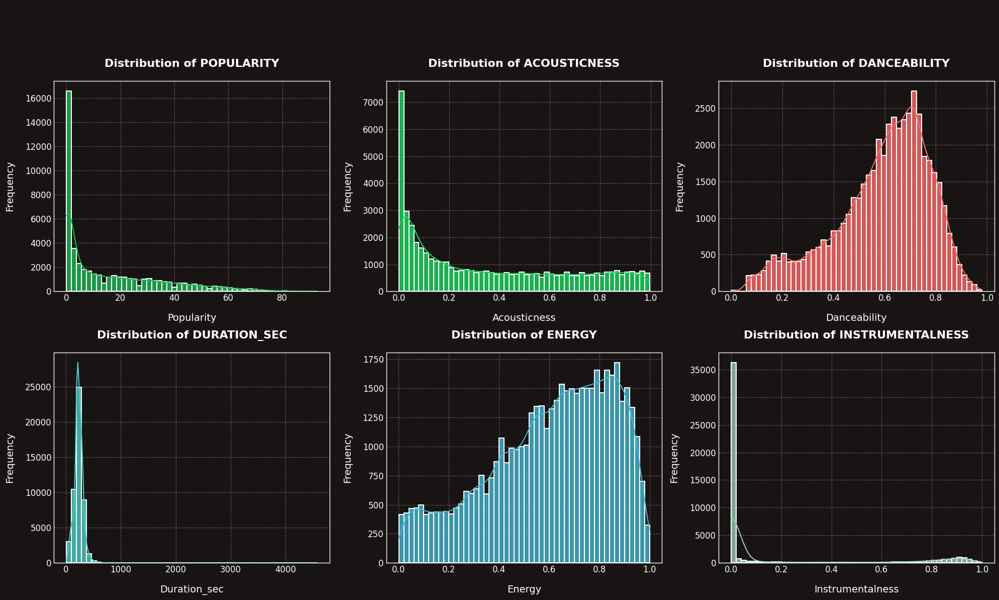

In [64]:
# --- Define the numerical columns to plot ---

columns_to_plot = ['popularity', 'acousticness', 'danceability', 'duration_sec', 'energy', 'instrumentalness']

# Define Spotify-inspired color palette
spotify_colors = ['#1DB954', '#1ED760', '#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7', '#DDA0DD']

# Set a modern plotting style
plt.style.use('seaborn-v0_8-darkgrid')

# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 12)) # Increased figsize for better visibility
axes = axes.flatten() # Flatten the 2x3 array of axes for easy iteration

fig.suptitle('Distribution of Key Numerical Variables (Histograms with KDE)', fontsize=22, y=1.02, fontweight='bold', color='#191414') # Spotify black

# For BG color - Spotify dark theme
fig.patch.set_facecolor('#191414')  # Spotify dark background

# Loop through each column and plot its histogram with KDE
for i, col in enumerate(columns_to_plot):
    # Use sns.histplot for histogram and KDE with Spotify-inspired colors
    sns.histplot(data=spotify, x=col, kde=True, ax=axes[i], bins=50, 
                color=spotify_colors[i % len(spotify_colors)], 
                edgecolor='white', alpha=0.8, linewidth=1.5)

    # Set title and labels for each subplot
    axes[i].set_title(f'Distribution of {col.upper()}', fontsize=16, pad=20, fontweight='bold', color='white')
    axes[i].set_xlabel(col.capitalize(), fontsize=14, labelpad=15, color='white')
    axes[i].set_ylabel('Frequency', fontsize=14, labelpad=15, color='white')

    # Axis color - dark theme
    axes[i].set_facecolor('#191414')  # Spotify dark background
    axes[i].tick_params(colors='white', labelsize=12)
    
    # Customize grid
    axes[i].grid(True, linestyle='--', alpha=0.3, color='white')
    
    # Add subtle border
    for spine in axes[i].spines.values():
        spine.set_edgecolor('white')
        spine.set_linewidth(1)

# Adjust layout to prevent titles/labels from overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # [left, bottom, right, top] for padding

# Display the plot
plt.show()

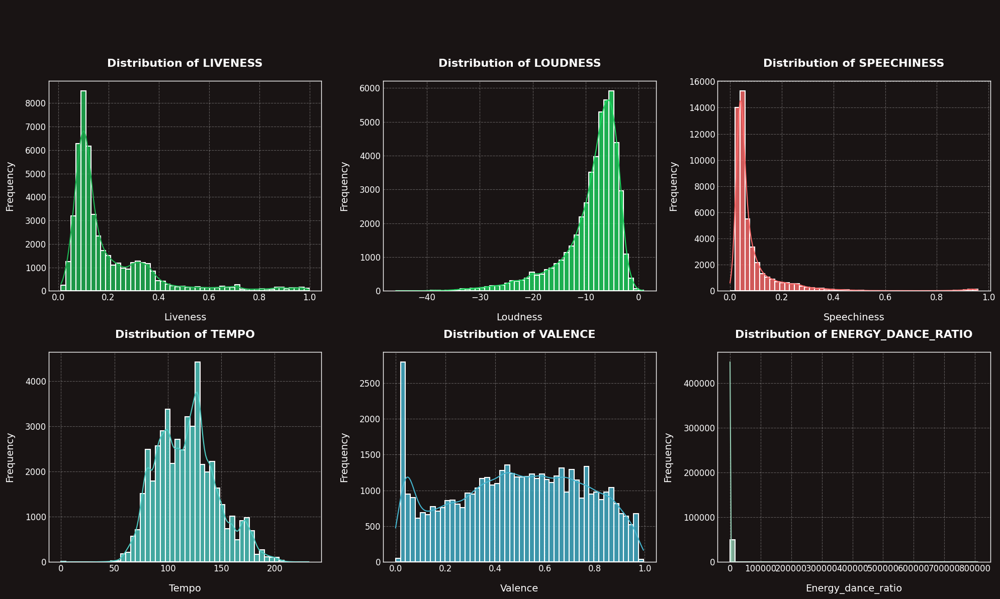

In [67]:
# --- Define the numerical columns to plot ---

columns_to_plot = ['liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'energy_dance_ratio']

# Define Spotify-inspired color palette
spotify_colors = ['#1DB954', '#1ED760', '#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7', '#DDA0DD']

# Set a modern plotting style
plt.style.use('seaborn-v0_8-darkgrid')

# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 12)) # Increased figsize for better visibility
axes = axes.flatten() # Flatten the 2x3 array of axes for easy iteration

fig.suptitle('Distribution of Key Numerical Variables (Histograms with KDE)', fontsize=22, y=1.02, fontweight='bold', color='#191414') # Spotify black

# For BG color - Spotify dark theme
fig.patch.set_facecolor('#191414')  # Spotify dark background

# Loop through each column and plot its histogram with KDE
for i, col in enumerate(columns_to_plot):
    # Use sns.histplot for histogram and KDE with Spotify-inspired colors
    sns.histplot(data=spotify, x=col, kde=True, ax=axes[i], bins=50, 
                color=spotify_colors[i % len(spotify_colors)], 
                edgecolor='white', alpha=0.8, linewidth=1.5)

    # Set title and labels for each subplot
    axes[i].set_title(f'Distribution of {col.upper()}', fontsize=16, pad=20, fontweight='bold', color='white')
    axes[i].set_xlabel(col.capitalize(), fontsize=14, labelpad=15, color='white')
    axes[i].set_ylabel('Frequency', fontsize=14, labelpad=15, color='white')

    # Axis color - dark theme
    axes[i].set_facecolor('#191414')  # Spotify dark background
    axes[i].tick_params(colors='white', labelsize=12)
    
    # Customize grid
    axes[i].grid(True, linestyle='--', alpha=0.3, color='white')
    
    # Add subtle border
    for spine in axes[i].spines.values():
        spine.set_edgecolor('white')
        spine.set_linewidth(1)

# Adjust layout to prevent titles/labels from overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # [left, bottom, right, top] for padding

# Display the plot
plt.show()

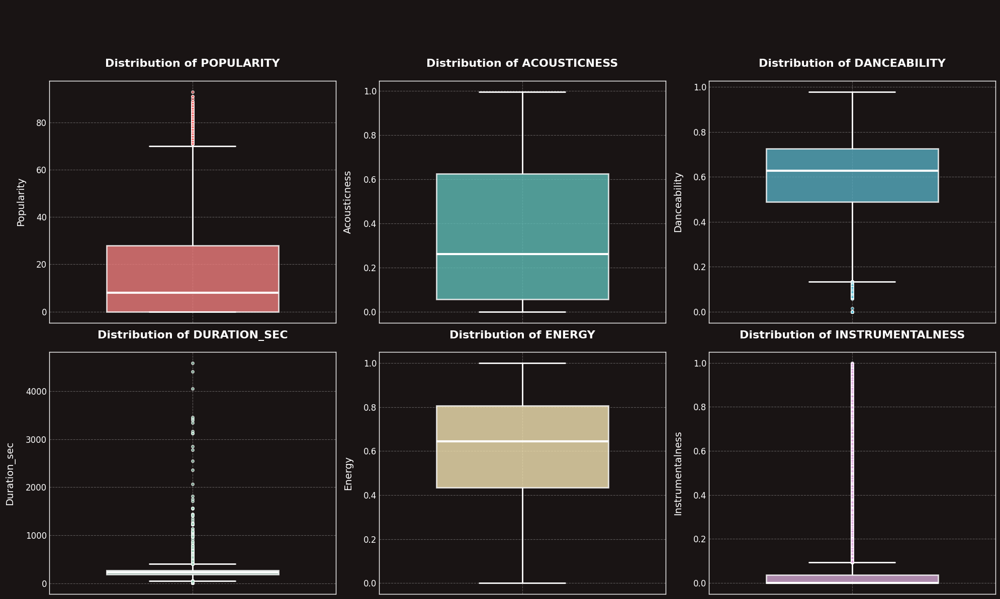

In [70]:
# --- Define the numerical columns to plot ---

columns_to_plot = ['popularity', 'acousticness', 'danceability', 'duration_sec', 'energy', 'instrumentalness']

# Define vibrant color palette for box plots
box_colors = ['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7', '#DDA0DD']

# Set a modern plotting style
plt.style.use('seaborn-v0_8-darkgrid')

# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 12)) # Increased figsize for better visibility
axes = axes.flatten() # Flatten the 2x3 array of axes for easy iteration

fig.suptitle('Box Plots of Key Numerical Variables (Outliers & Quartiles)', fontsize=22, y=1.02, fontweight='bold', color='#191414') # Spotify black

# For BG color - Spotify dark theme
fig.patch.set_facecolor('#191414')  # Spotify dark background

# Loop through each column and plot its box plot
for i, col in enumerate(columns_to_plot):
    # Use sns.boxplot for box plots with vibrant colors
    sns.boxplot(data=spotify, y=col, ax=axes[i], color=box_colors[i], width=0.6, 
                boxprops=dict(alpha=0.8, linewidth=2, edgecolor='white'),
                whiskerprops=dict(linewidth=2, color='white'),
                capprops=dict(linewidth=2, color='white'),
                medianprops=dict(linewidth=3, color='white'),
                flierprops=dict(marker='o', markerfacecolor=box_colors[i], 
                              markeredgecolor='white', markersize=4, alpha=0.7))

    # Set title and labels for each subplot
    axes[i].set_title(f'Distribution of {col.upper()}', fontsize=16, pad=20, fontweight='bold', color='white')
    axes[i].set_xlabel('') # No x-label needed as it's a single box plot
    axes[i].set_ylabel(col.capitalize(), fontsize=14, labelpad=15, color='white')

    # Axis color - dark theme
    axes[i].set_facecolor('#191414')  # Spotify dark background
    axes[i].tick_params(colors='white', labelsize=12)
    
    # Customize grid
    axes[i].grid(True, linestyle='--', alpha=0.3, color='white')
    
    # Add subtle border
    for spine in axes[i].spines.values():
        spine.set_edgecolor('white')
        spine.set_linewidth(1)

# Adjust layout to prevent titles/labels from overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # [left, bottom, right, top] for padding

# Display the plot
plt.show()

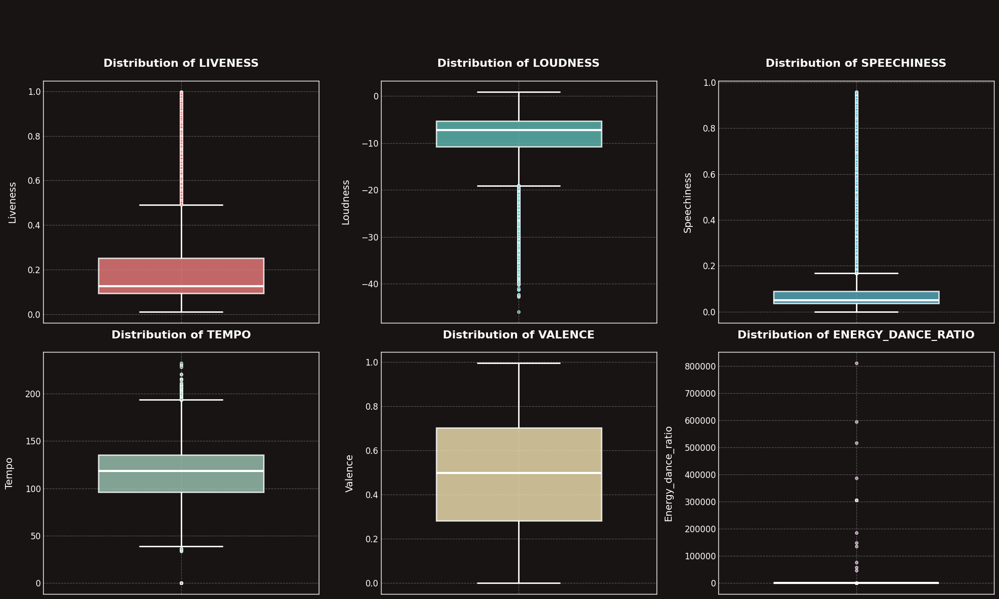

In [73]:
# --- Define the numerical columns to plot ---

columns_to_plot = ['liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'energy_dance_ratio']

# Define vibrant color palette for box plots
box_colors = ['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7', '#DDA0DD']

# Set a modern plotting style
plt.style.use('seaborn-v0_8-darkgrid')

# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20, 12)) # Increased figsize for better visibility
axes = axes.flatten() # Flatten the 2x3 array of axes for easy iteration

fig.suptitle('Box Plots of Key Numerical Variables (Outliers & Quartiles)', fontsize=22, y=1.02, fontweight='bold', color='#191414') # Spotify black

# For BG color - Spotify dark theme
fig.patch.set_facecolor('#191414')  # Spotify dark background

# Loop through each column and plot its box plot
for i, col in enumerate(columns_to_plot):
    # Use sns.boxplot for box plots with vibrant colors
    sns.boxplot(data=spotify, y=col, ax=axes[i], color=box_colors[i], width=0.6, 
                boxprops=dict(alpha=0.8, linewidth=2, edgecolor='white'),
                whiskerprops=dict(linewidth=2, color='white'),
                capprops=dict(linewidth=2, color='white'),
                medianprops=dict(linewidth=3, color='white'),
                flierprops=dict(marker='o', markerfacecolor=box_colors[i], 
                              markeredgecolor='white', markersize=4, alpha=0.7))

    # Set title and labels for each subplot
    axes[i].set_title(f'Distribution of {col.upper()}', fontsize=16, pad=20, fontweight='bold', color='white')
    axes[i].set_xlabel('') # No x-label needed as it's a single box plot
    axes[i].set_ylabel(col.capitalize(), fontsize=14, labelpad=15, color='white')

    # Axis color - dark theme
    axes[i].set_facecolor('#191414')  # Spotify dark background
    axes[i].tick_params(colors='white', labelsize=12)
    
    # Customize grid
    axes[i].grid(True, linestyle='--', alpha=0.3, color='white')
    
    # Add subtle border
    for spine in axes[i].spines.values():
        spine.set_edgecolor('white')
        spine.set_linewidth(1)

# Adjust layout to prevent titles/labels from overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # [left, bottom, right, top] for padding

# Display the plot
plt.show()

In [76]:
# Distribution of Popularity

print("\n--- Distribution of Popularity ---\n")
print("A. Top Popularities\n")
print(spotify['popularity'].value_counts().head(50))
print("\n" + "="*50)
print("A. Bottom Popularities\n")
print(spotify['popularity'].value_counts().tail(43))
print("\n" + "="*50)

# Dividing Popularity into segments

# Define bins and labels
bins = [0, 20, 40, 60, 80, 100]
labels = ['Very Low (0-20)', 'Low (21-40)', 'Medium (41-60)', 'High (61-80)', 'Very High (81-100)']

# Create a new column for popularity category
spotify['popularity_segment'] = pd.cut(spotify['popularity'], bins=bins, labels=labels, include_lowest=True)

print("\n--- Distribution of Popularity Segments ---\n")
print(spotify['popularity_segment'].value_counts())
print("\n" + "="*50)

# Distribution of Key

print("\n--- Distribution of Keys ---\n")
print(spotify['key'].value_counts())
print("\n" + "="*50)

# Distribution of Mode

print("\n--- Distribution of Modes ---\n")
print(spotify['mode'].value_counts())
print("\n" + "="*50)

# Distribution of Time Signature

print("\n--- Distribution of Time Signatues ---\n")
print(spotify['time_signature'].value_counts())
print("\n" + "="*50)

# Distribution of Decade

print("\n--- Distribution of Decades ---\n")
print(spotify['decade'].value_counts())


--- Distribution of Popularity ---

A. Top Popularities

popularity
0     13351
1      3251
2      2069
3      1504
4      1202
5      1092
6       948
7       860
8       849
9       826
11      729
10      705
14      691
12      681
17      663
13      657
18      654
15      614
19      606
22      589
21      588
16      582
20      573
23      549
26      540
30      527
28      526
31      517
24      514
25      483
27      476
32      467
29      466
34      451
33      437
35      430
38      404
37      402
36      394
39      373
40      353
43      341
42      339
47      338
41      338
44      318
45      296
46      276
49      263
50      262
Name: count, dtype: int64

A. Bottom Popularities

popularity
48    262
52    224
53    224
51    222
55    218
54    211
57    204
56    178
58    175
59    169
61    157
60    153
65    129
62    124
66    122
67    116
63    116
64    107
69     99
68     99
70     72
73     70
71     69
72     56
74     46
75     42
77     33

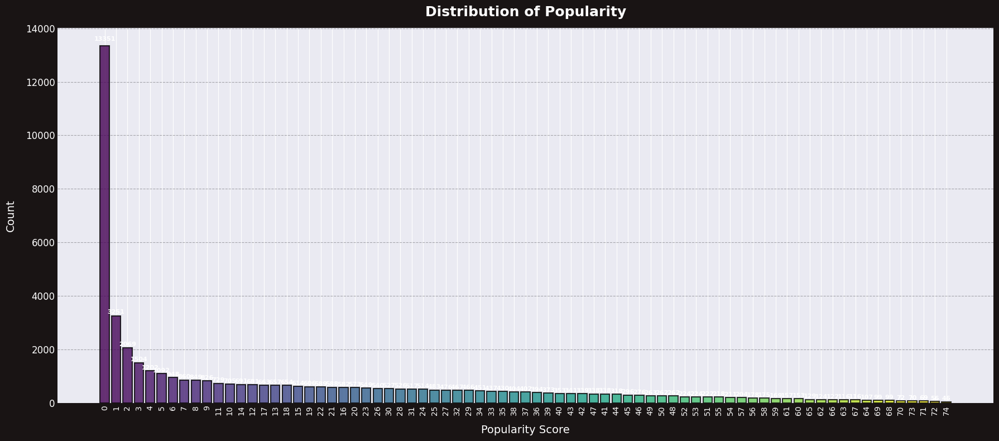

In [85]:
# Visualizing the Popularity distribution
top = spotify['popularity'].value_counts().head(75).sort_values(ascending=False)  # ensures top 10 by count

# Define gradient color palette
colors = plt.cm.viridis(np.linspace(0, 1, len(top)))

plt.figure(figsize=(18,8), facecolor='#191414')
bars = plt.bar(range(len(top)), top.values, color=colors, edgecolor='black', linewidth=1.5, alpha=0.8)

plt.title('Distribution of Popularity', fontsize=18, pad=15, fontweight='bold', color='white')
plt.xlabel('Popularity Score', fontsize=14, labelpad=12, color='white')
plt.ylabel('Count', fontsize=14, labelpad=12, color='white')
plt.xticks(range(len(top)), top.index, rotation=90, color='white', fontsize=10)
plt.yticks(color='white', fontsize=12)

# Customize grid
plt.grid(True, linestyle='--', alpha=0.3, color='black', axis='y')

# Add value labels on bars
for i, bar in enumerate(bars):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + height*0.01,
             f'{int(height)}', ha='center', va='bottom', color='white', fontsize=8, fontweight='bold')

plt.tight_layout()
plt.show()

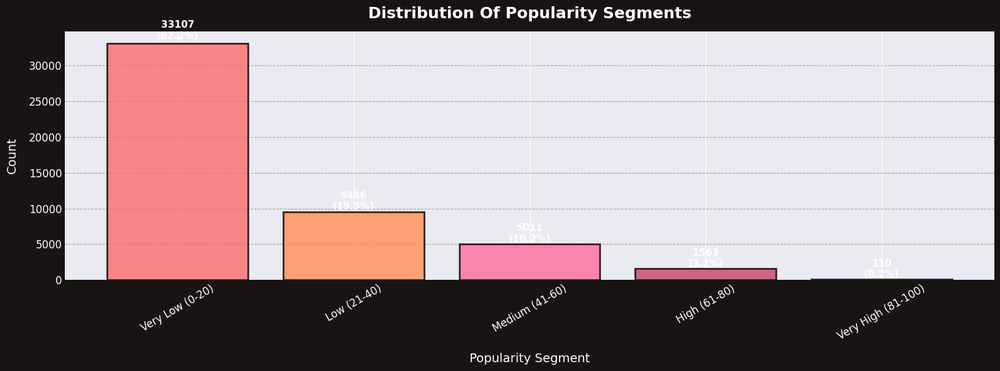

In [94]:
# Visualizing the Popularity Segment distribution
segment_counts = spotify['popularity_segment'].value_counts()
segment_colors = ['#FF6B6B', '#FF8E53', '#FF6B9D', '#C44569', '#F8B500']

plt.figure(figsize=(16,6), facecolor='#191414')
bars = plt.bar(range(len(segment_counts)), segment_counts.values, 
               color=segment_colors, edgecolor='black', linewidth=2, alpha=0.8)

plt.title('Distribution Of Popularity Segments', fontsize=18, fontweight='bold', pad=15, color='white')
plt.xlabel('Popularity Segment', fontsize=14, labelpad=12, color='white')
plt.ylabel('Count', fontsize=14, labelpad=12, color='white')
plt.xticks(range(len(segment_counts)), segment_counts.index, rotation=30, color='white', fontsize=12)
plt.yticks(color='white', fontsize=12)

# Customize grid
plt.grid(True, linestyle='--', alpha=0.3, color='black', axis='y')

# Add percentage labels on bars
total = sum(segment_counts.values)
for i, bar in enumerate(bars):
    height = bar.get_height()
    percentage = (height / total) * 100
    plt.text(bar.get_x() + bar.get_width()/2., height + height*0.01,
             f'{int(height)}\n({percentage:.1f}%)', ha='center', va='bottom', 
             color='white', fontsize=11, fontweight='bold')

plt.tight_layout()
plt.show()

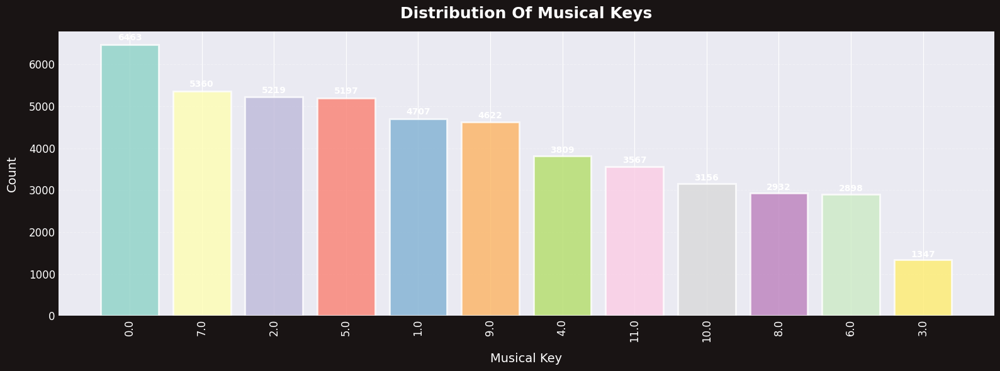

In [97]:
# Visualizing the Key distribution
key_counts = spotify['key'].value_counts()
key_colors = plt.cm.Set3(np.linspace(0, 1, len(key_counts)))

plt.figure(figsize=(16,6), facecolor='#191414')
bars = plt.bar(range(len(key_counts)), key_counts.values, 
               color=key_colors, edgecolor='white', linewidth=2, alpha=0.8)

plt.title('Distribution Of Musical Keys', fontsize=18, pad=15, fontweight='bold', color='white')
plt.xlabel('Musical Key', fontsize=14, labelpad=12, color='white')
plt.ylabel('Count', fontsize=14, labelpad=12, color='white')
plt.xticks(range(len(key_counts)), key_counts.index, rotation=90, color='white', fontsize=12)
plt.yticks(color='white', fontsize=12)

# Customize grid
plt.grid(True, linestyle='--', alpha=0.3, color='white', axis='y')

# Add value labels on bars
for i, bar in enumerate(bars):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + height*0.01,
             f'{int(height)}', ha='center', va='bottom', color='white', fontsize=10, fontweight='bold')

plt.tight_layout()
plt.show()

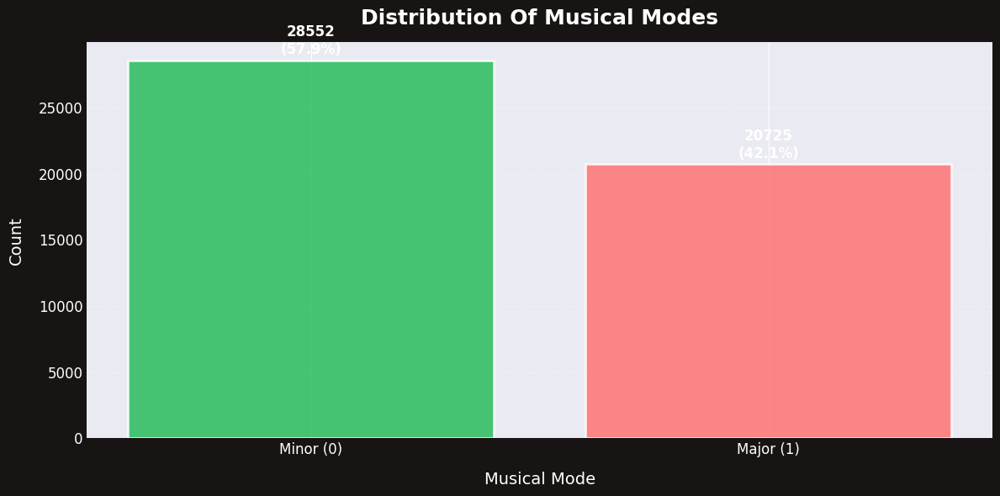

In [100]:
# Visualizing the Mode distribution
mode_counts = spotify['mode'].value_counts()
mode_colors = ['#1DB954', '#FF6B6B']  # Green for Major, Red for Minor

plt.figure(figsize=(12,6), facecolor='#191414')
bars = plt.bar(range(len(mode_counts)), mode_counts.values, 
               color=mode_colors, edgecolor='white', linewidth=2, alpha=0.8)

plt.title('Distribution Of Musical Modes', fontsize=18, pad=15, fontweight='bold', color='white')
plt.xlabel('Musical Mode', fontsize=14, labelpad=12, color='white')
plt.ylabel('Count', fontsize=14, labelpad=12, color='white')
plt.xticks(range(len(mode_counts)), ['Minor (0)', 'Major (1)'], color='white', fontsize=12)
plt.yticks(color='white', fontsize=12)

# Customize grid
plt.grid(True, linestyle='--', alpha=0.3, color='white', axis='y')

# Add percentage labels on bars
total = sum(mode_counts.values)
for i, bar in enumerate(bars):
    height = bar.get_height()
    percentage = (height / total) * 100
    plt.text(bar.get_x() + bar.get_width()/2., height + height*0.01,
             f'{int(height)}\n({percentage:.1f}%)', ha='center', va='bottom', 
             color='white', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

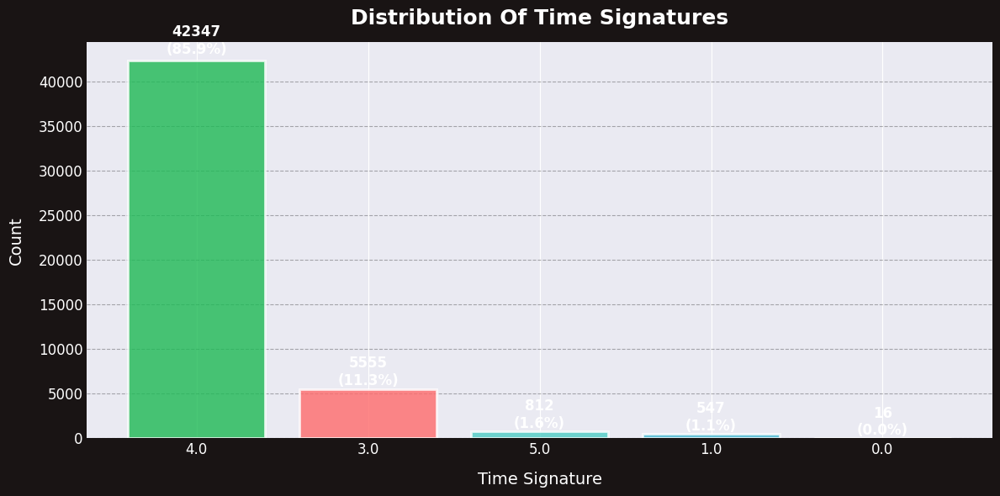

In [103]:
# Visualizing the Time Signature distribution
time_sig_counts = spotify['time_signature'].value_counts()
time_sig_colors = ['#1DB954', '#FF6B6B', '#4ECDC4', '#45B7D1']

plt.figure(figsize=(12,6), facecolor='#191414')
bars = plt.bar(range(len(time_sig_counts)), time_sig_counts.values, 
               color=time_sig_colors, edgecolor='white', linewidth=2, alpha=0.8)

plt.title('Distribution Of Time Signatures', fontsize=18, pad=15, fontweight='bold', color='white')
plt.xlabel('Time Signature', fontsize=14, labelpad=12, color='white')
plt.ylabel('Count', fontsize=14, labelpad=12, color='white')
plt.xticks(range(len(time_sig_counts)), time_sig_counts.index, color='white', fontsize=12)
plt.yticks(color='white', fontsize=12)

# Customize grid
plt.grid(True, linestyle='--', alpha=0.3, color='black', axis='y')

# Add percentage labels on bars
total = sum(time_sig_counts.values)
for i, bar in enumerate(bars):
    height = bar.get_height()
    percentage = (height / total) * 100
    plt.text(bar.get_x() + bar.get_width()/2., height + height*0.01,
             f'{int(height)}\n({percentage:.1f}%)', ha='center', va='bottom', 
             color='white', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

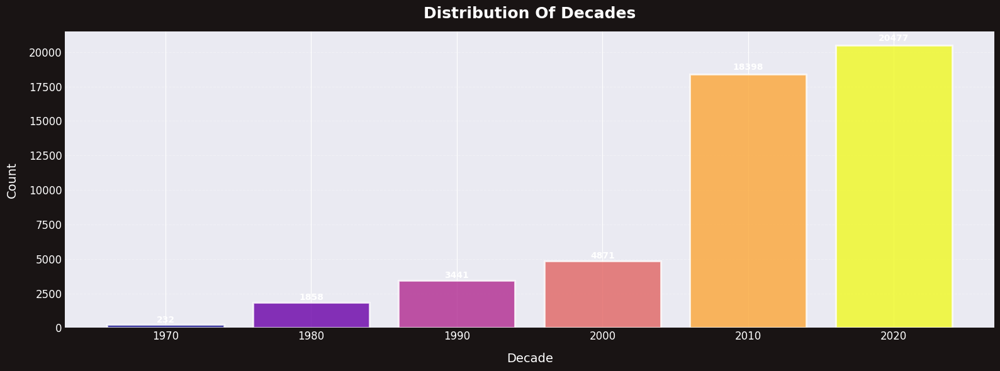

In [106]:
# Visualizing the Decade distribution
decade_counts = spotify['decade'].value_counts().sort_index()
decade_colors = plt.cm.plasma(np.linspace(0, 1, len(decade_counts)))

plt.figure(figsize=(16,6), facecolor='#191414')
bars = plt.bar(range(len(decade_counts)), decade_counts.values, 
               color=decade_colors, edgecolor='white', linewidth=2, alpha=0.8)

plt.title('Distribution Of Decades', fontsize=18, pad=15, fontweight='bold', color='white')
plt.xlabel('Decade', fontsize=14, labelpad=12, color='white')
plt.ylabel('Count', fontsize=14, labelpad=12, color='white')
plt.xticks(range(len(decade_counts)), decade_counts.index, color='white', fontsize=12)
plt.yticks(color='white', fontsize=12)

# Customize grid
plt.grid(True, linestyle='--', alpha=0.3, color='white', axis='y')

# Add value labels on bars
for i, bar in enumerate(bars):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + height*0.01,
             f'{int(height)}', ha='center', va='bottom', color='white', fontsize=10, fontweight='bold')

plt.tight_layout()
plt.show()

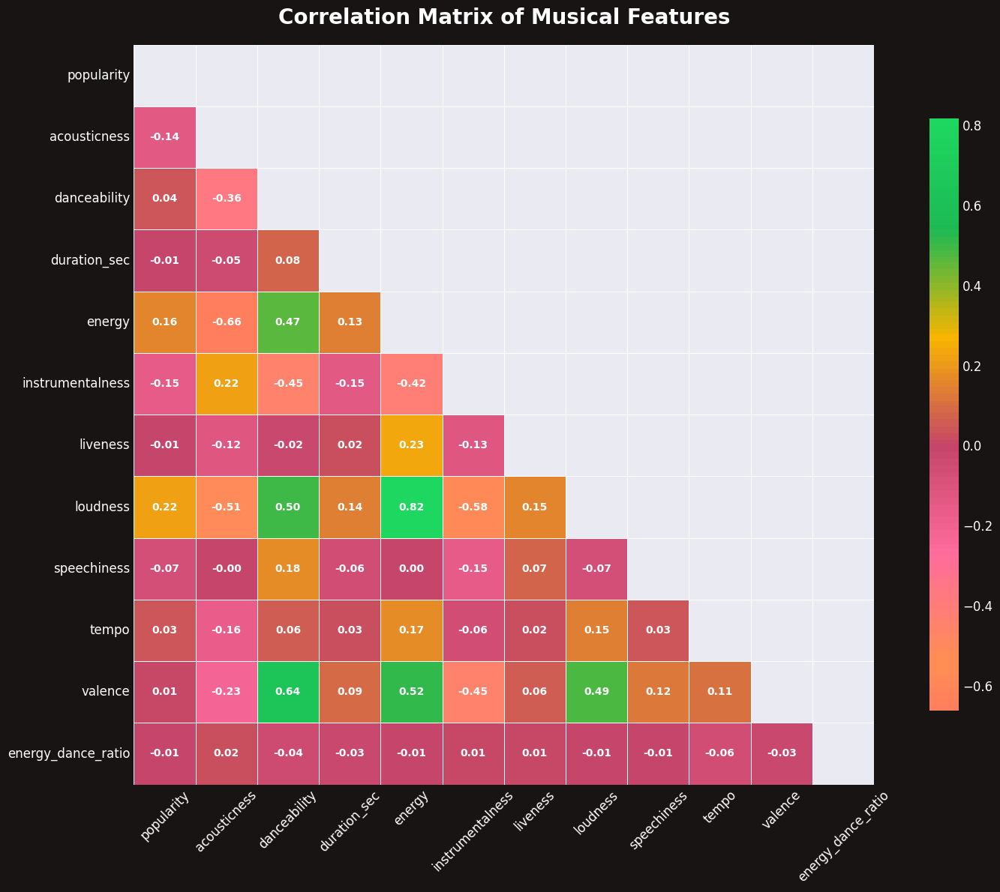

In [109]:
# Correlation Analysis - Heatmap
# Select numerical columns for correlation analysis
numerical_cols = ['popularity', 'acousticness', 'danceability', 'duration_sec', 'energy', 
                 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 
                 'valence', 'energy_dance_ratio']

# Calculate correlation matrix
correlation_matrix = spotify[numerical_cols].corr()

# Create the heatmap
plt.figure(figsize=(16, 12), facecolor='#191414')

# Create custom colormap
from matplotlib.colors import LinearSegmentedColormap
colors = ['#FF6B6B', '#FF8E53', '#FF6B9D', '#C44569', '#F8B500', '#1DB954', '#1ED760']
n_bins = 100
cmap = LinearSegmentedColormap.from_list('spotify', colors, N=n_bins)

# Create heatmap
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))  # Mask upper triangle
sns.heatmap(correlation_matrix, mask=mask, annot=True, cmap=cmap, center=0,
            square=True, linewidths=0.5, cbar_kws={"shrink": .8}, 
            fmt='.2f', annot_kws={'size': 10, 'color': 'white', 'weight': 'bold'})

plt.title('Correlation Matrix of Musical Features', fontsize=20, pad=20, fontweight='bold', color='white')
plt.xticks(color='white', fontsize=12, rotation=45)
plt.yticks(color='white', fontsize=12, rotation=0)

# Customize colorbar
cbar = plt.gcf().axes[-1]
cbar.tick_params(colors='white', labelsize=12)
cbar.set_label('Correlation Coefficient')
cbar.yaxis.label.set_color('white')
cbar.yaxis.label.set_fontsize(14)
cbar.yaxis.label.set_fontweight('bold')

plt.tight_layout()
plt.show()


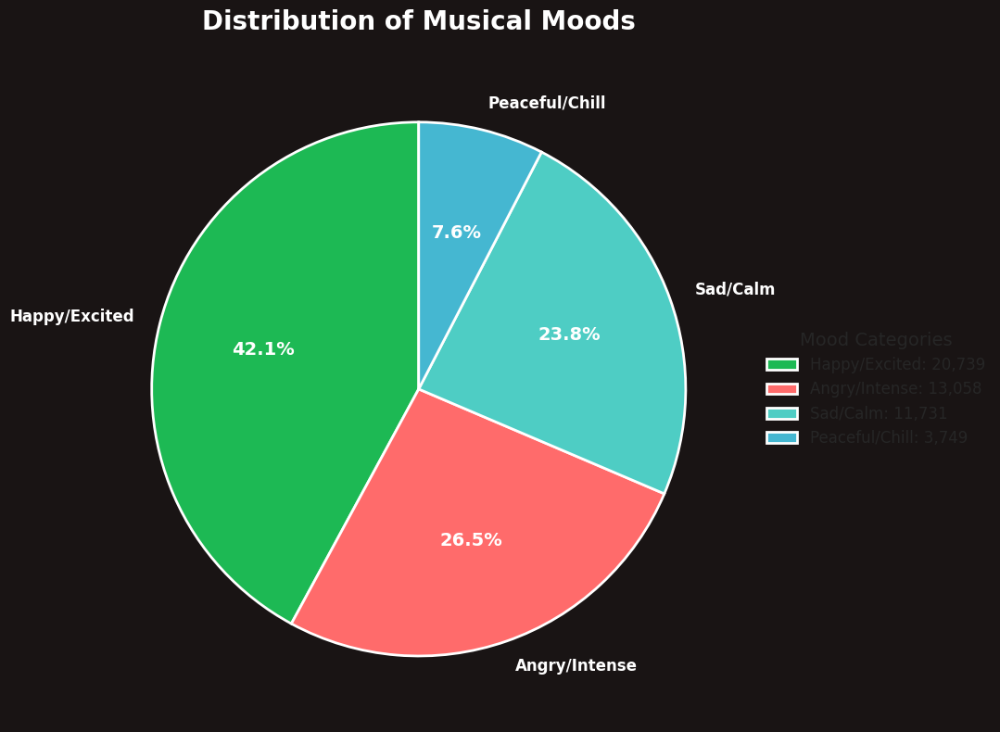

In [112]:
# Mood Analysis Visualization
mood_counts = spotify['mood'].value_counts()
mood_colors = {'Happy/Excited': '#1DB954', 'Angry/Intense': '#FF6B6B', 
               'Sad/Calm': '#4ECDC4', 'Peaceful/Chill': '#45B7D1'}

# Create pie chart
plt.figure(figsize=(12, 8), facecolor='#191414')

# Create pie chart
wedges, texts, autotexts = plt.pie(mood_counts.values, labels=mood_counts.index, 
                                   colors=[mood_colors[mood] for mood in mood_counts.index],
                                   autopct='%1.1f%%', startangle=90, 
                                   textprops={'color': 'white', 'fontsize': 12, 'fontweight': 'bold'},
                                   wedgeprops={'edgecolor': 'white', 'linewidth': 2})

# Customize percentage text
for autotext in autotexts:
    autotext.set_color('white')
    autotext.set_fontsize(14)
    autotext.set_fontweight('bold')

plt.title('Distribution of Musical Moods', fontsize=20, pad=20, fontweight='bold', color='white')

# Add legend
plt.legend(wedges, [f'{mood}: {count:,}' for mood, count in mood_counts.items()],
          title="Mood Categories", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1),
          title_fontsize=14, fontsize=12, facecolor='#191414', edgecolor='white')

plt.tight_layout()
plt.show()


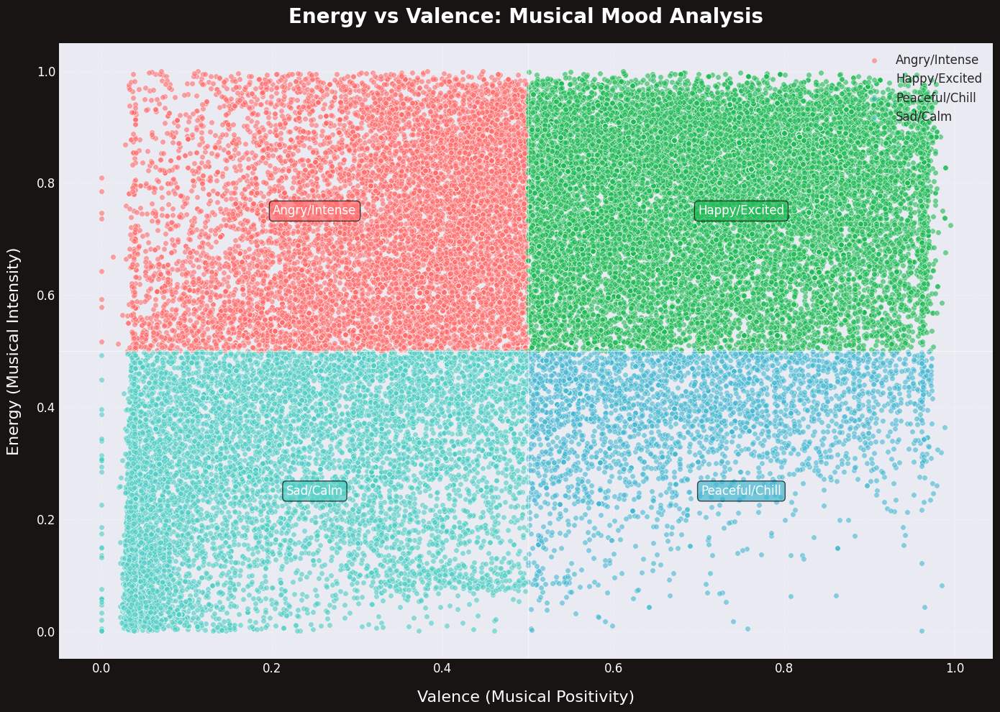

In [118]:
# Energy vs Valence Scatter Plot with Mood-based Coloring
plt.figure(figsize=(14, 10), facecolor='#191414')

# Define mood colors
mood_colors = {'Happy/Excited': '#1DB954', 'Angry/Intense': '#FF6B6B', 
               'Sad/Calm': '#4ECDC4', 'Peaceful/Chill': '#45B7D1'}

# Create scatter plot for each mood
for mood in spotify['mood'].unique():
    mood_data = spotify[spotify['mood'] == mood]
    plt.scatter(mood_data['valence'], mood_data['energy'], 
               c=mood_colors[mood], label=mood, alpha=0.6, s=30, edgecolors='white', linewidth=0.5)

plt.title('Energy vs Valence: Musical Mood Analysis', fontsize=20, pad=20, fontweight='bold', color='white')
plt.xlabel('Valence (Musical Positivity)', fontsize=16, labelpad=15, color='white')
plt.ylabel('Energy (Musical Intensity)', fontsize=16, labelpad=15, color='white')

# Customize axes
plt.xticks(color='white', fontsize=12)
plt.yticks(color='white', fontsize=12)

# Add grid
plt.grid(True, linestyle='--', alpha=0.3, color='white')

# Add quadrant lines
plt.axhline(y=0.5, color='white', linestyle='-', alpha=0.5, linewidth=1)
plt.axvline(x=0.5, color='white', linestyle='-', alpha=0.5, linewidth=1)

# Add quadrant labels
plt.text(0.25, 0.25, 'Sad/Calm', fontsize=12, color='white', ha='center', va='center', 
         bbox=dict(boxstyle="round,pad=0.3", facecolor='#4ECDC4', alpha=0.7))
plt.text(0.75, 0.25, 'Peaceful/Chill', fontsize=12, color='white', ha='center', va='center',
         bbox=dict(boxstyle="round,pad=0.3", facecolor='#45B7D1', alpha=0.7))
plt.text(0.25, 0.75, 'Angry/Intense', fontsize=12, color='white', ha='center', va='center',
         bbox=dict(boxstyle="round,pad=0.3", facecolor='#FF6B6B', alpha=0.7))
plt.text(0.75, 0.75, 'Happy/Excited', fontsize=12, color='white', ha='center', va='center',
         bbox=dict(boxstyle="round,pad=0.3", facecolor='#1DB954', alpha=0.7))

# Add legend
plt.legend(loc='upper right', fontsize=12, facecolor='#191414', edgecolor='white')

plt.tight_layout()
plt.show()


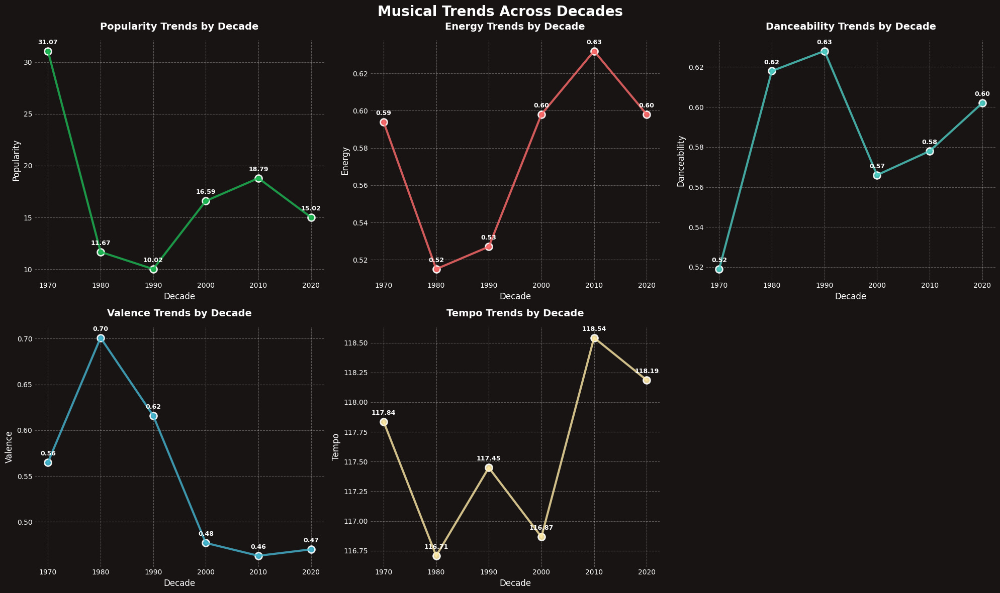

In [121]:
# Decade Trend Analysis
decade_stats = spotify.groupby('decade').agg({
    'popularity': 'mean',
    'energy': 'mean',
    'danceability': 'mean',
    'valence': 'mean',
    'tempo': 'mean'
}).round(3)

# Create subplots for trend analysis
fig, axes = plt.subplots(2, 3, figsize=(20, 12), facecolor='#191414')
axes = axes.flatten()

# Define colors for each metric
metric_colors = ['#1DB954', '#FF6B6B', '#4ECDC4', '#45B7D1', '#FFEAA7']

metrics = ['popularity', 'energy', 'danceability', 'valence', 'tempo']
metric_names = ['Popularity', 'Energy', 'Danceability', 'Valence', 'Tempo']

for i, (metric, name) in enumerate(zip(metrics, metric_names)):
    ax = axes[i]
    
    # Create line plot with gradient colors
    x = decade_stats.index
    y = decade_stats[metric]
    
    # Plot line with gradient
    for j in range(len(x)-1):
        ax.plot([x[j], x[j+1]], [y.iloc[j], y.iloc[j+1]], 
               color=metric_colors[i], linewidth=3, alpha=0.8)
    
    # Add scatter points
    ax.scatter(x, y, c=metric_colors[i], s=100, edgecolors='white', linewidth=2, alpha=0.9)
    
    # Customize subplot
    ax.set_title(f'{name} Trends by Decade', fontsize=14, fontweight='bold', color='white', pad=15)
    ax.set_xlabel('Decade', fontsize=12, color='white')
    ax.set_ylabel(name, fontsize=12, color='white')
    ax.tick_params(colors='white', labelsize=10)
    ax.grid(True, linestyle='--', alpha=0.3, color='white')
    ax.set_facecolor('#191414')
    
    # Add value labels on points
    for j, (decade, value) in enumerate(zip(x, y)):
        ax.annotate(f'{value:.2f}', (decade, value), 
                   textcoords="offset points", xytext=(0,10), ha='center',
                   color='white', fontsize=9, fontweight='bold')

# Remove the last empty subplot
fig.delaxes(axes[5])

plt.suptitle('Musical Trends Across Decades', fontsize=20, fontweight='bold', color='white', y=0.98)
plt.tight_layout()
plt.show()


In [124]:
# Make a copy for artist-level analysis
spotify_artists = spotify.copy()

# Split artist_name into list (assuming they are separated by commas)
spotify_artists['artist_name'] = spotify_artists['artist_name'].str.split(',')

# Explode the list so each artist gets its own row
spotify_artists = spotify_artists.explode('artist_name')

# Remove extra spaces around artist names
spotify_artists['artist_name'] = spotify_artists['artist_name'].str.strip()

# Now spotify_artists is ready for artist-level analysis


In [127]:
# Number of unique Artist, Language, Mood.

print("\n--- Number of Unique Values ---\n")
print(f"   Number of unique Artists: {spotify_artists['artist_name'].nunique()}")
print(f"   Number of unique Languages: {spotify['language'].nunique()}")
print(f"   Number of unique Moods: {spotify['mood'].nunique()}")
print("\n" + "="*50)

# Most frequent Artists (count/percentage).

print("\n--- Distribution of Artists ---\n")
print("\nA. Frequency:\n")
print(spotify_artists['artist_name'].value_counts())
# print("\n" + "="*50)
print("\nB. Percentage(%):\n")
print(spotify_artists['artist_name'].value_counts(normalize=True) * 100) # Multiply by 100 for percentage
print("\n" + "="*50)

# Most frequent Languages (count/percentage).

print("\n--- Distribution of Languages ---\n")
print("\nA. Frequency:\n")
print(spotify['language'].value_counts())
# print("\n" + "="*50)
print("\nB. Percentage(%):\n")
print(spotify['language'].value_counts(normalize=True) * 100) # Multiply by 100 for percentage
print("\n" + "="*50)

# Most frequent Moods (count/percentage).

print("\n--- Frequency of Moods ---\n")
print("\nA. Frequency:\n")
print(spotify['mood'].value_counts())
# print("\n" + "="*50)
print("\nB. Percentage(%)\n")
print(spotify['mood'].value_counts(normalize=True) * 100) # Multiply by 100 for percentage


--- Number of Unique Values ---

   Number of unique Artists: 6413
   Number of unique Languages: 6
   Number of unique Moods: 4


--- Distribution of Artists ---


A. Frequency:

artist_name
Ilaiyaraaja                3945
Yuvan Shankar Raja         1994
Arijit Singh               1893
Anirudh Ravichander        1714
Madonna                    1542
                           ... 
Bhuvana                       1
Shubha                        1
R. Parthiban                  1
Atha Ali Azad                 1
Dharmaseelan Udaiyappan       1
Name: count, Length: 6413, dtype: int64

B. Percentage(%):

artist_name
Ilaiyaraaja                4.422894
Yuvan Shankar Raja         2.235551
Arijit Singh               2.122316
Anirudh Ravichander        1.921632
Madonna                    1.728796
                             ...   
Bhuvana                    0.001121
Shubha                     0.001121
R. Parthiban               0.001121
Atha Ali Azad              0.001121
Dharmaseelan Udaiyappan

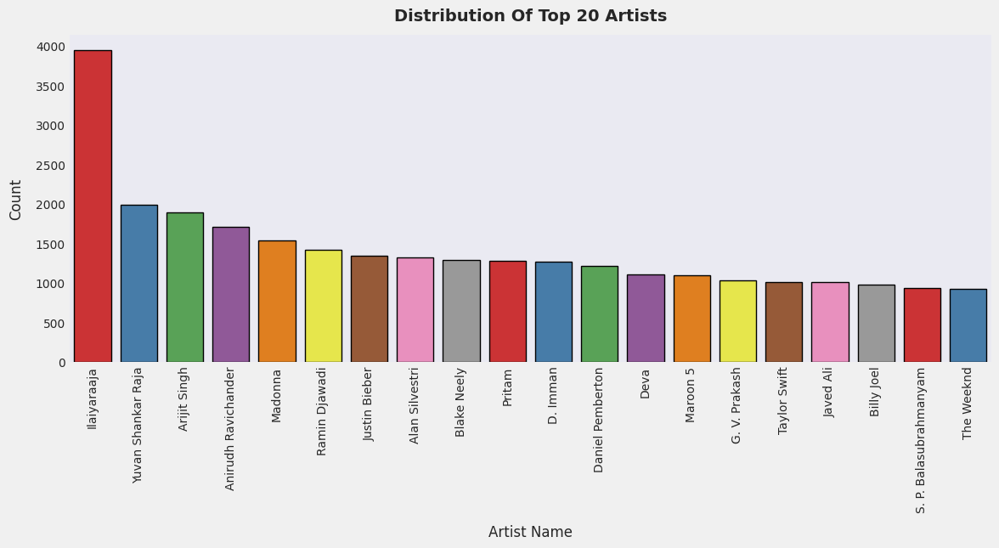

In [130]:
# Visualizing the distribution of Artists

top_artists = spotify_artists['artist_name'].value_counts().head(20)

# Plot
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top_artists.index, y=top_artists.values, palette='Set1', edgecolor='black')

plt.title('Distribution Of Top 20 Artists', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Artist Name', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

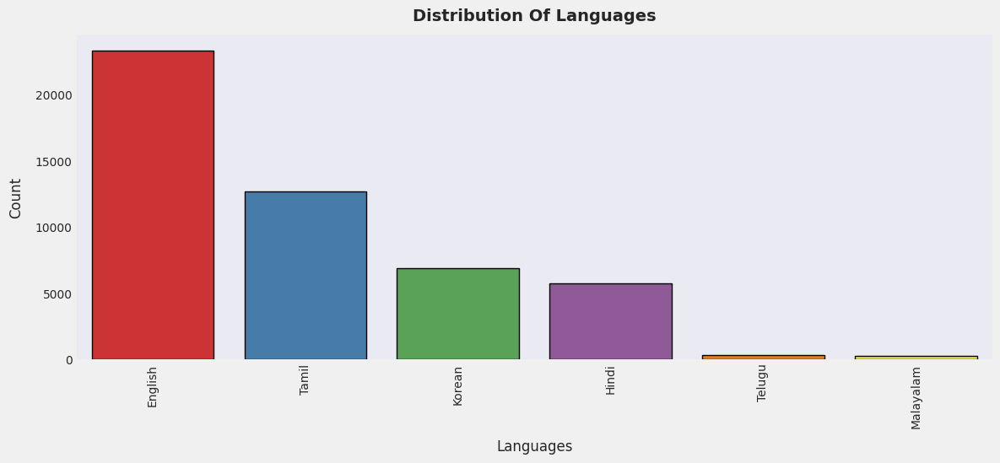

In [133]:
# Visualizing the distribution of Languages

plt.figure(figsize = (14,5), facecolor='#f0f0f0')
sns.barplot(spotify['language'].value_counts() , palette = 'Set1' , edgecolor = 'black' , order = spotify['language'].value_counts().index)

plt.title('Distribution Of Languages', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

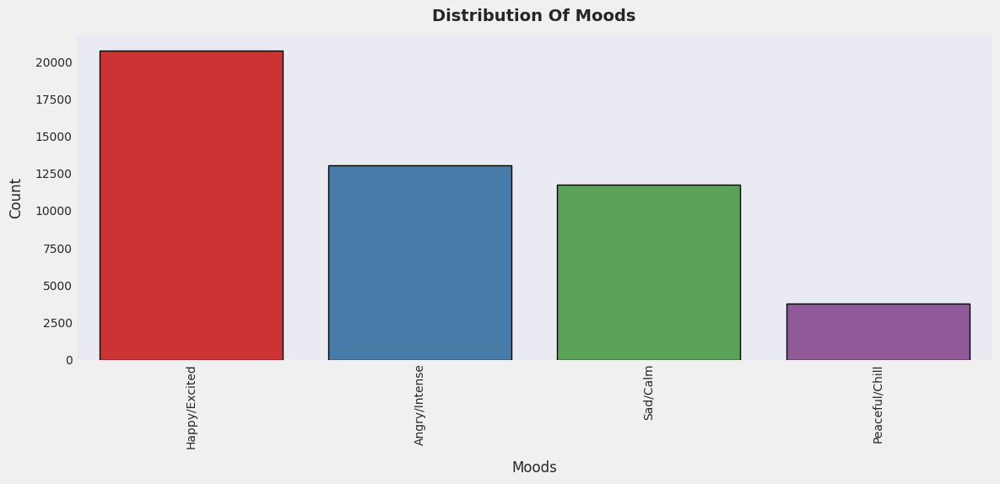

In [136]:
# Visualizing the distribution Moods

plt.figure(figsize = (14,5), facecolor='#f0f0f0')
sns.barplot(spotify['mood'].value_counts() , palette = 'Set1' , edgecolor = 'black' , order = spotify['mood'].value_counts().index)

plt.title('Distribution Of Moods', fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Count', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

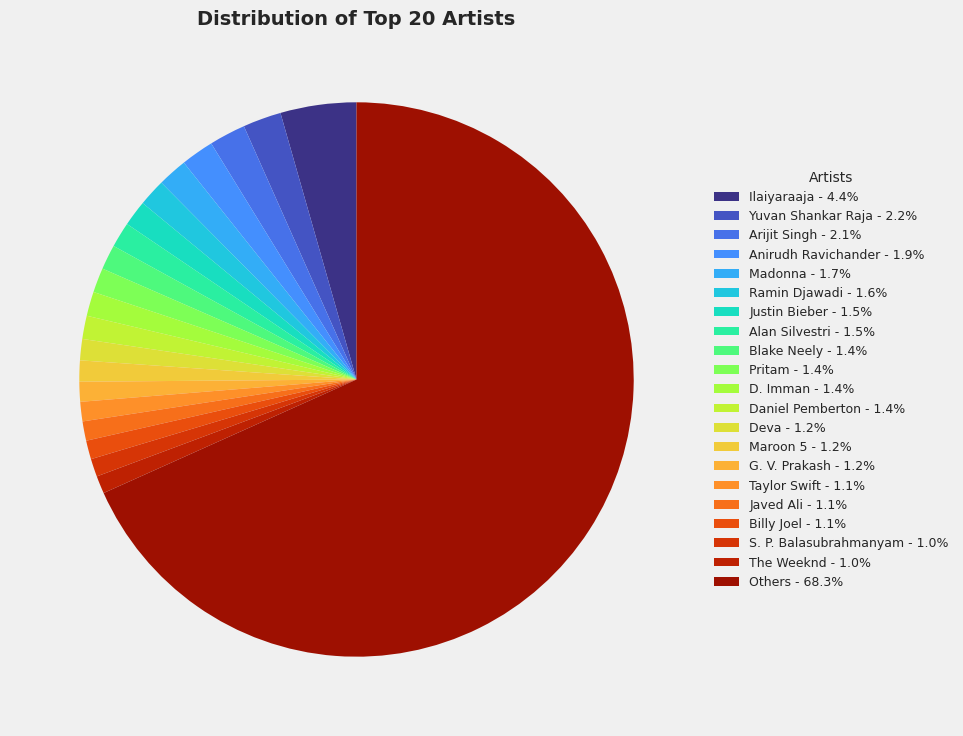

In [139]:
# Pie chart for Top 20 Artists + Others
count_artist_name = spotify_artists['artist_name'].value_counts()

# Keep top 20, rest as 'Others'
top20 = count_artist_name.head(20)
others = pd.Series(count_artist_name.iloc[20:].sum(), index=["Others"])
count_artist_name_final = pd.concat([top20, others])

# Plot
plt.figure(figsize=(14,9), facecolor='#f0f0f0')
wedges, texts = plt.pie(count_artist_name_final, startangle=90, colors=sns.color_palette("turbo", len(count_artist_name_final)))

# Prepare labels with percentage values
labels = [f"{artist} - {val:.1f}%" for artist, val in zip(count_artist_name_final.index, count_artist_name_final / count_artist_name_final.sum() * 100)]

# Add legend
plt.legend(wedges, labels, title="Artists", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=9)

plt.title("Distribution of Top 20 Artists", fontsize=14, fontweight="bold")
plt.show()

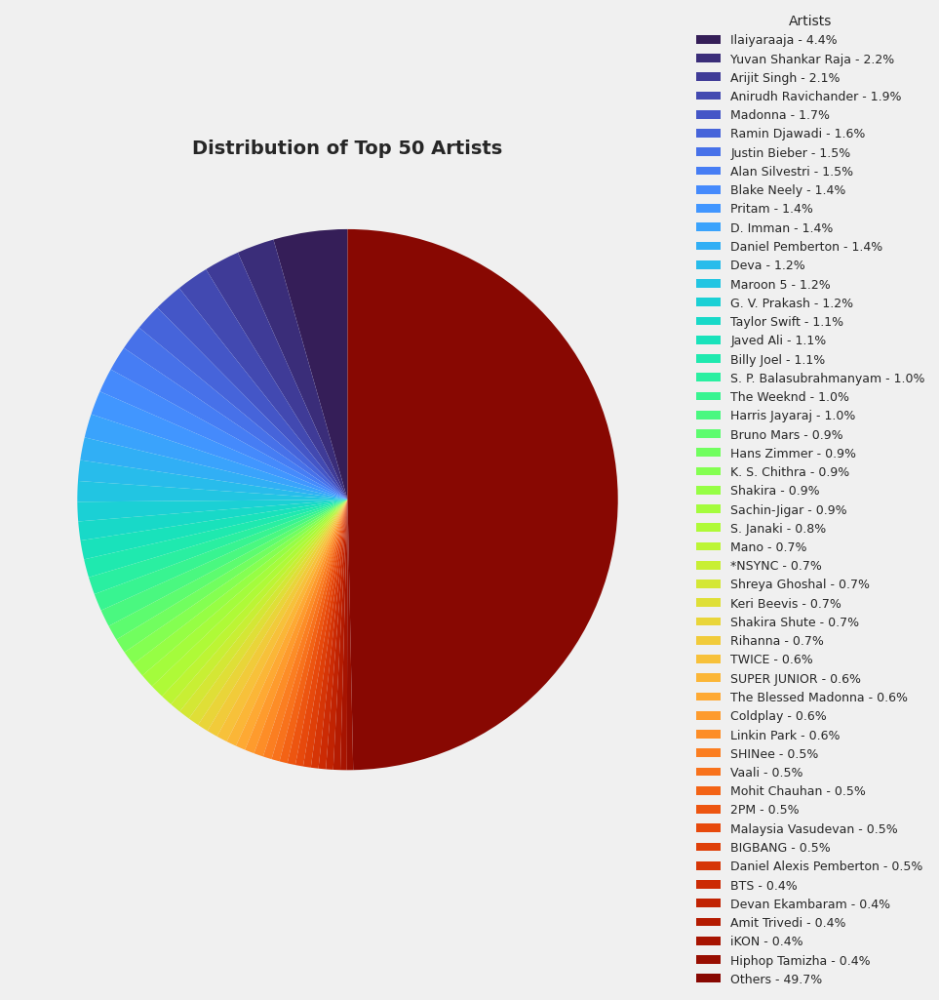

In [142]:
# Pie chart for Top 50 Artists + Others
count_artist_name = spotify_artists['artist_name'].value_counts()

# Keep top 50, rest as 'Others'
top50 = count_artist_name.head(50)
others = pd.Series(count_artist_name.iloc[50:].sum(), index=["Others"])
count_artist_name_final = pd.concat([top50, others])

# Plot
plt.figure(figsize=(9,9), facecolor='#f0f0f0')
wedges, texts = plt.pie(count_artist_name_final, startangle=90, colors=sns.color_palette("turbo", len(count_artist_name_final)))

# Prepare labels with percentage values
labels = [f"{artist} - {val:.1f}%" for artist, val in zip(count_artist_name_final.index, count_artist_name_final / count_artist_name_final.sum() * 100)]

# Add legend
plt.legend(wedges, labels, title="Artists", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=9)

plt.title("Distribution of Top 50 Artists", fontsize=14, fontweight="bold")
plt.show()

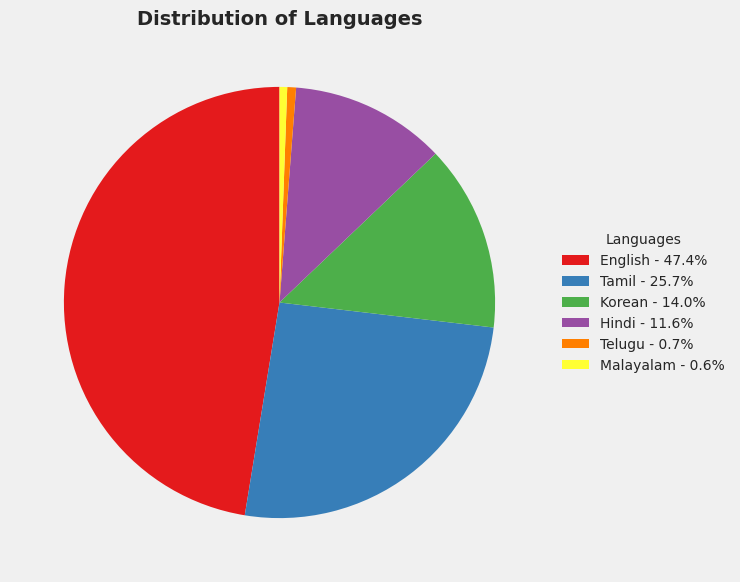

In [145]:
# Pie chart for Languages

plt.figure(figsize=(7,7), facecolor='#f0f0f0')
wedges, texts = plt.pie(spotify['language'].value_counts(), startangle=90, colors=sns.color_palette("Set1", len(spotify['language'].value_counts())))

# Prepare labels with percentage values
labels = [f"{lang} - {val:.1f}%" for lang, val in zip(spotify['language'].value_counts().index, spotify['language'].value_counts()/spotify['language'].value_counts().sum()*100)]

# Add legend with labels + percentages
plt.legend(wedges, labels, title="Languages", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.title("Distribution of Languages", fontsize=14, fontweight="bold")
plt.show()

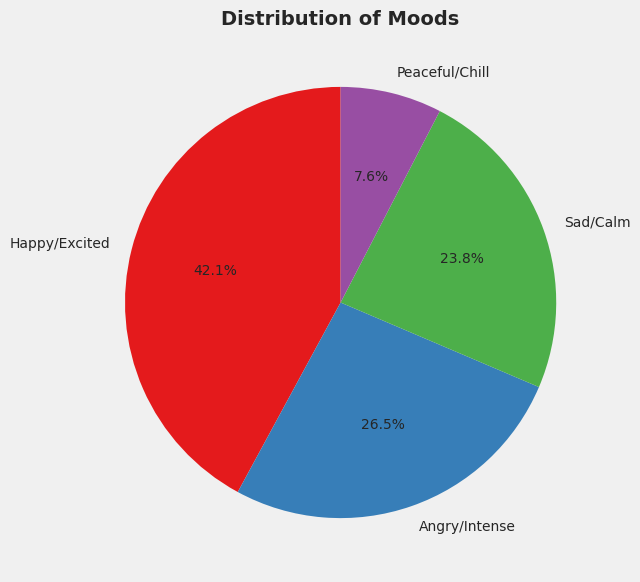

In [148]:
# Example: Pie chart for Moods

plt.figure(figsize=(7,7), facecolor='#f0f0f0')
plt.pie(spotify['mood'].value_counts(), labels=spotify['mood'].value_counts().index, autopct='%1.1f%%', startangle=90, colors=sns.color_palette("Set1", len(spotify['mood'].value_counts())))
plt.title("Distribution of Moods", fontsize=14, fontweight="bold")
plt.show()

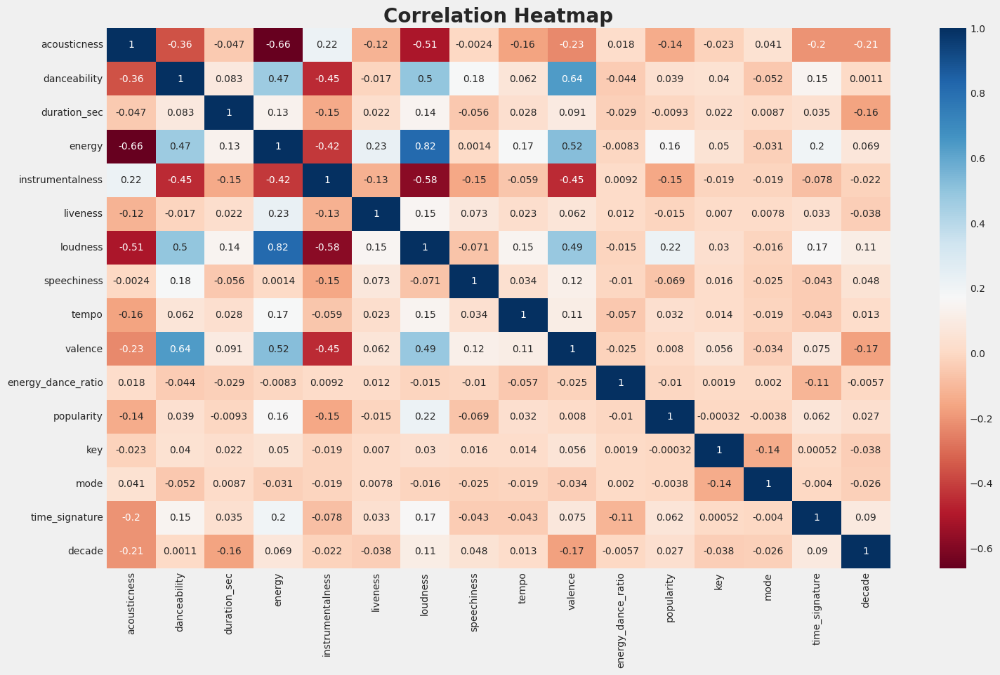

In [151]:
columns = [ 'acousticness', 'danceability', 'duration_sec', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'energy_dance_ratio', 'popularity', 'key', 'mode', 'time_signature', 'decade']


plt.figure(figsize=(18, 10), facecolor='#f0f0f0')
sns.heatmap(spotify[columns].corr(method='pearson') , annot = True , cmap = 'RdBu')

plt.title('Correlation Heatmap', fontsize=20, fontweight='bold')
plt.show()

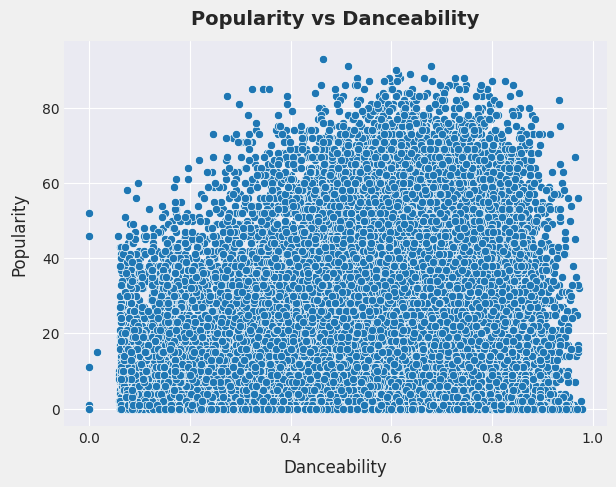

In [154]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="danceability", y="popularity", color = '#1f77b4')
plt.title("Popularity vs Danceability", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Danceability', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

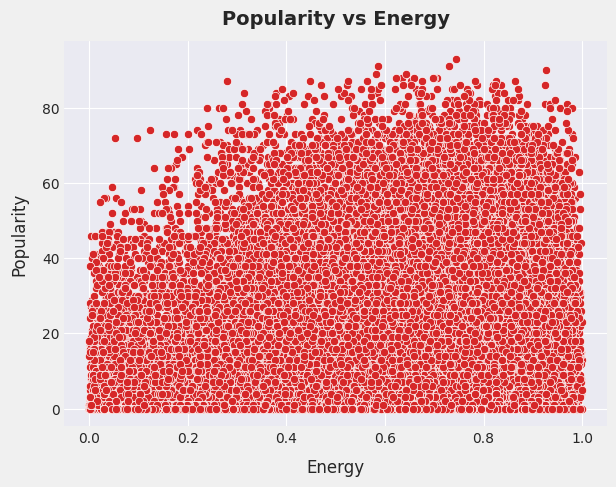

In [157]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="energy", y="popularity", color = '#d62728')
plt.title("Popularity vs Energy", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Energy', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

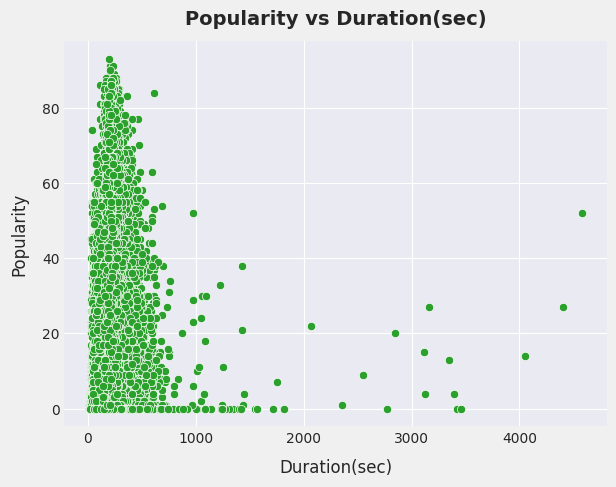

In [160]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="duration_sec", y="popularity", color = '#2ca02c')
plt.title("Popularity vs Duration(sec)", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Duration(sec)', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

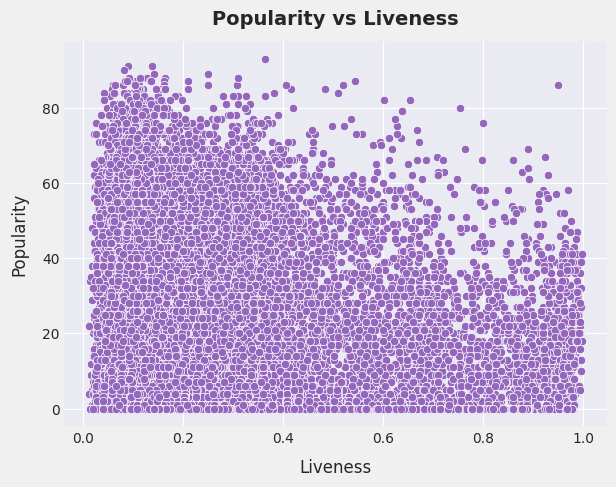

In [163]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="liveness", y="popularity", color = '#9467bd')
plt.title("Popularity vs Liveness", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Liveness', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

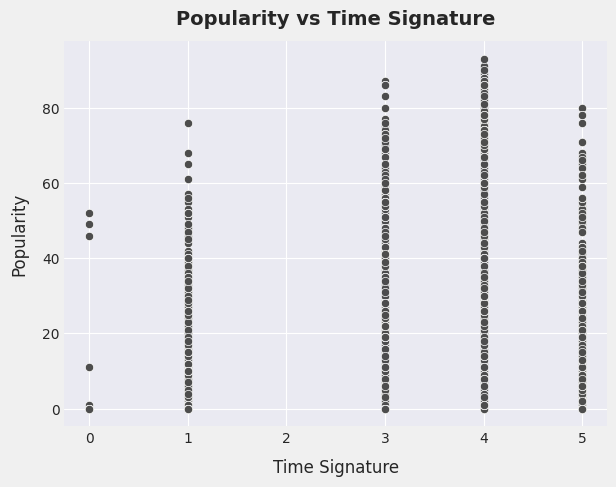

In [166]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="time_signature", y="popularity", color = '#4d4d4d')
plt.title("Popularity vs Time Signature", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Time Signature', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

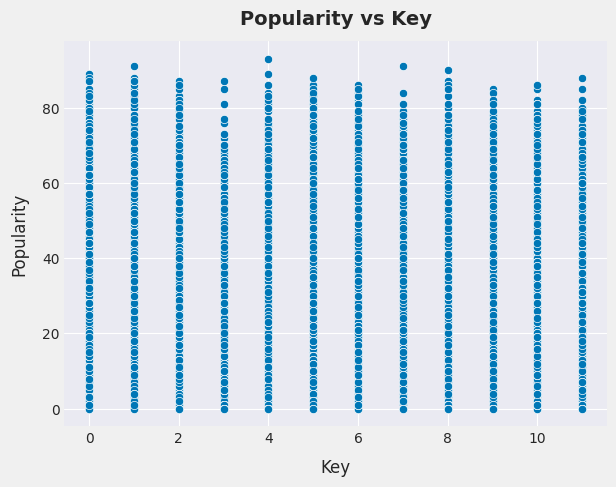

In [169]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="key", y="popularity", color = '#0077b6')
plt.title("Popularity vs Key", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Key', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

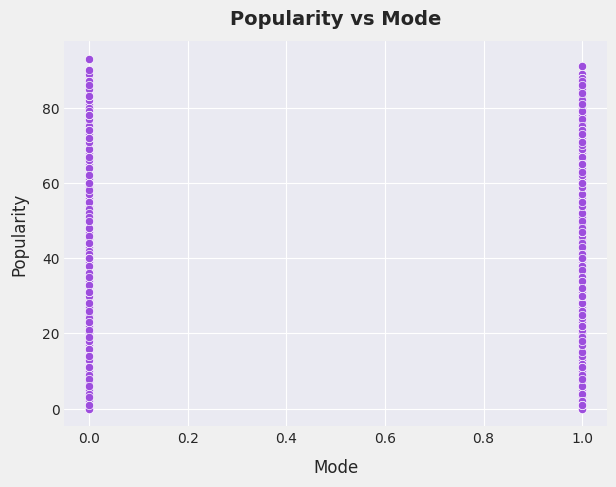

In [172]:

plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="mode", y="popularity", color = '#9d4edd')
plt.title("Popularity vs Mode", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Mode', fontsize = 12, labelpad = 10)
plt.ylabel('Popularity', fontsize = 12, labelpad = 10)
plt.show()

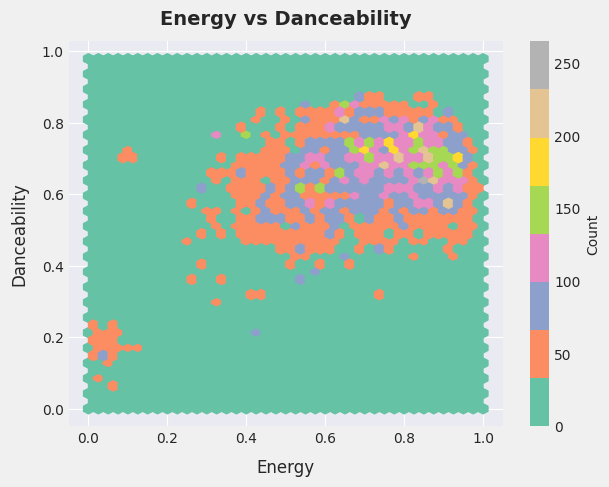

In [175]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["energy"], spotify["danceability"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Energy", fontsize = 12, labelpad = 10)
plt.ylabel("Danceability", fontsize = 12, labelpad = 10)
plt.title("Energy vs Danceability", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

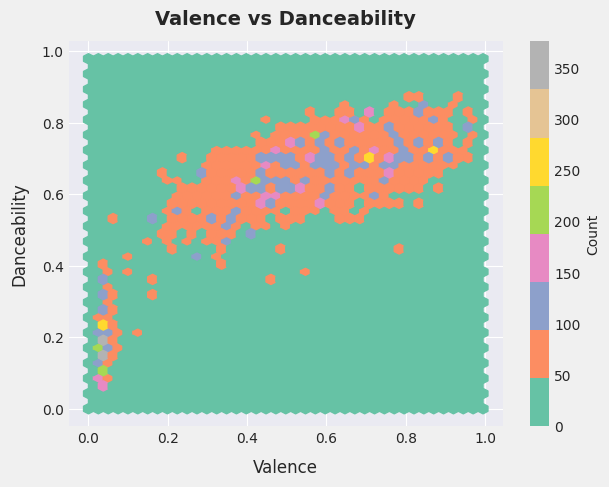

In [178]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["valence"], spotify["danceability"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Valence", fontsize = 12, labelpad = 10)
plt.ylabel("Danceability", fontsize = 12, labelpad = 10)
plt.title("Valence vs Danceability", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

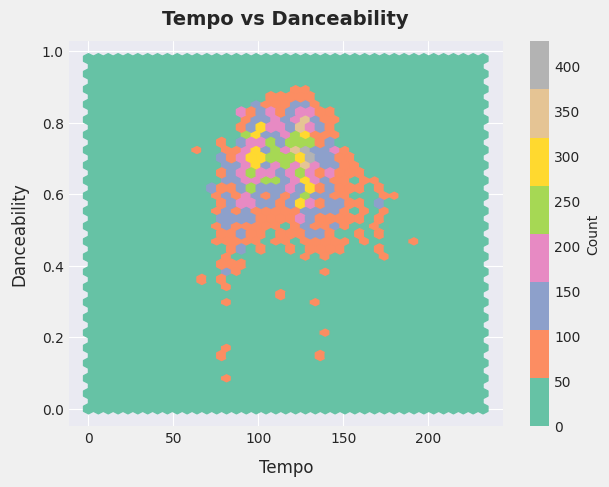

In [181]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["tempo"], spotify["danceability"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Tempo", fontsize = 12, labelpad = 10)
plt.ylabel("Danceability", fontsize = 12, labelpad = 10)
plt.title("Tempo vs Danceability", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

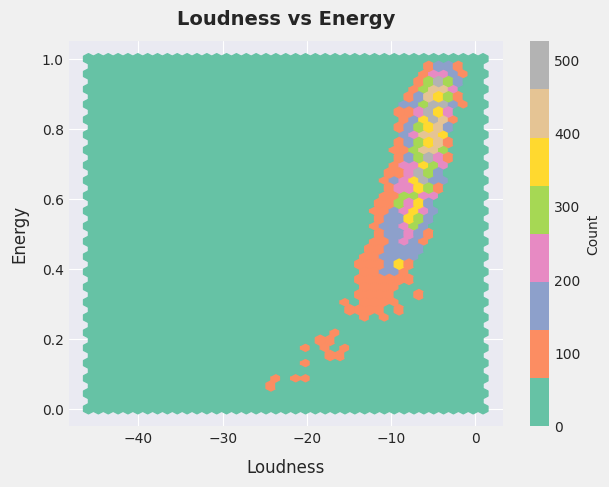

In [184]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["loudness"], spotify["energy"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Loudness", fontsize = 12, labelpad = 10)
plt.ylabel("Energy", fontsize = 12, labelpad = 10)
plt.title("Loudness vs Energy", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

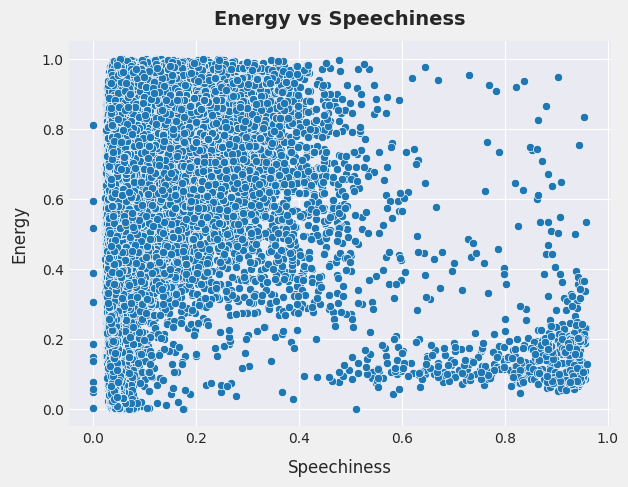

In [187]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="speechiness", y="energy", color = '#1f77b4')
plt.title("Energy vs Speechiness", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Speechiness', fontsize = 12, labelpad = 10)
plt.ylabel('Energy', fontsize = 12, labelpad = 10)
plt.show()

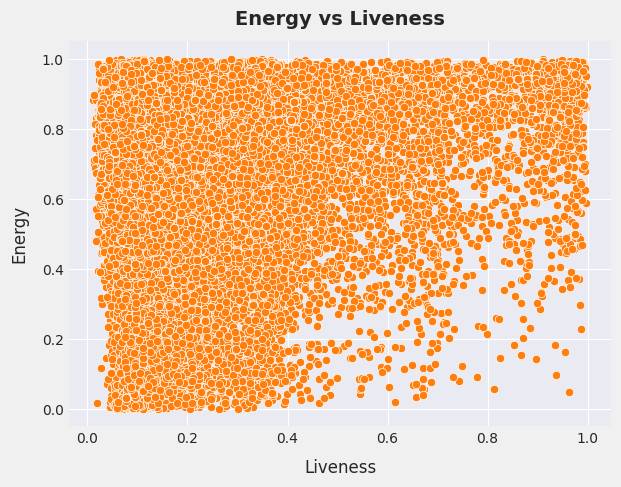

In [190]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="liveness", y="energy", color = '#ff7f0e')
plt.title("Energy vs Liveness", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Liveness', fontsize = 12, labelpad = 10)
plt.ylabel('Energy', fontsize = 12, labelpad = 10)
plt.show()

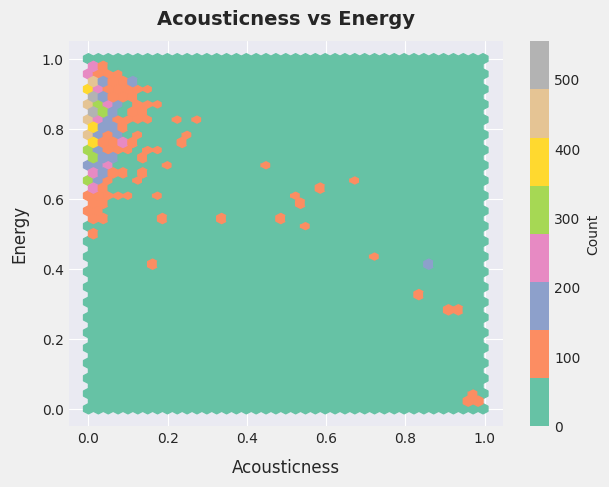

In [193]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["acousticness"], spotify["energy"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Acousticness", fontsize = 12, labelpad = 10)
plt.ylabel("Energy", fontsize = 12, labelpad = 10)
plt.title("Acousticness vs Energy", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

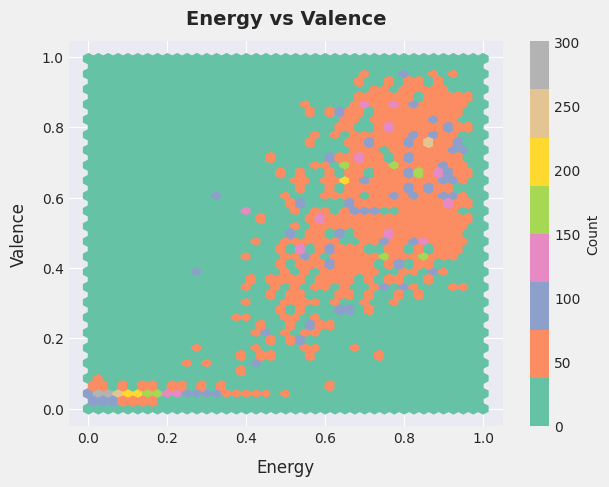

In [196]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["energy"], spotify["valence"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Energy", fontsize = 12, labelpad = 10)
plt.ylabel("Valence", fontsize = 12, labelpad = 10)
plt.title("Energy vs Valence", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

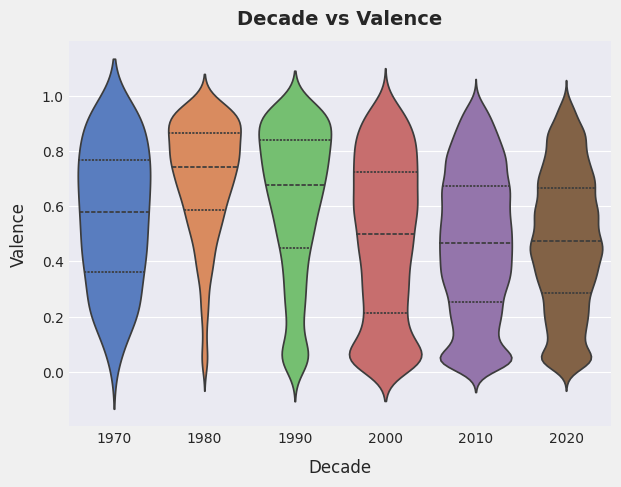

In [199]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.violinplot(data=spotify, x="decade", y="valence", palette="muted", inner="quartile")
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Valence", fontsize = 12, labelpad = 10)
plt.title("Decade vs Valence", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

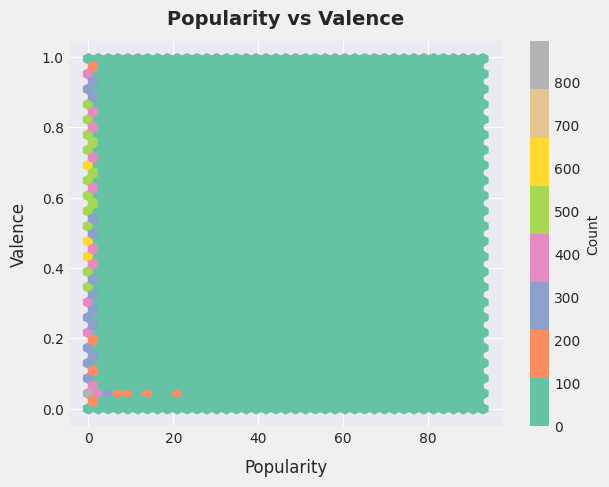

In [202]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["popularity"], spotify["valence"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Popularity", fontsize = 12, labelpad = 10)
plt.ylabel("Valence", fontsize = 12, labelpad = 10)
plt.title("Popularity vs Valence", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

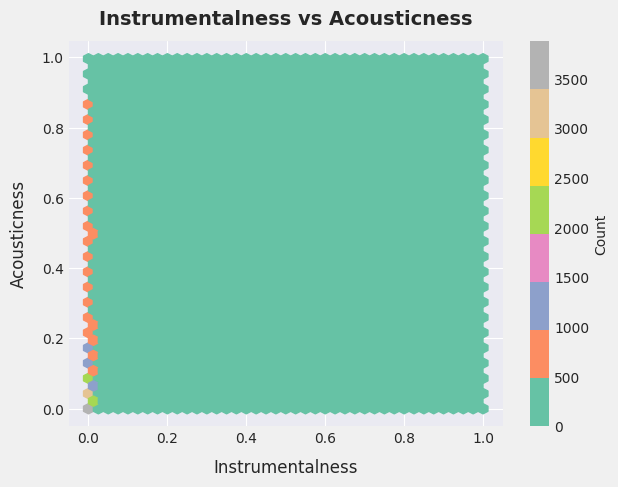

In [205]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["instrumentalness"], spotify["acousticness"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.ylabel("Acousticness", fontsize = 12, labelpad = 10)
plt.title("Instrumentalness vs Acousticness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

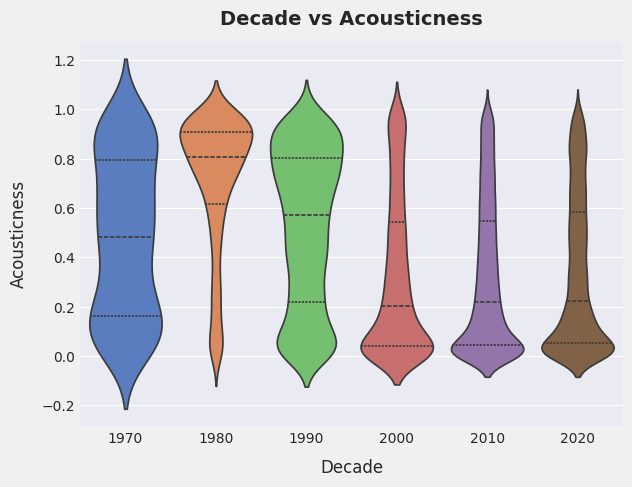

In [208]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.violinplot(data=spotify, x="decade", y="acousticness", palette="muted", inner="quartile")
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Acousticness", fontsize = 12, labelpad = 10)
plt.title("Decade vs Acousticness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

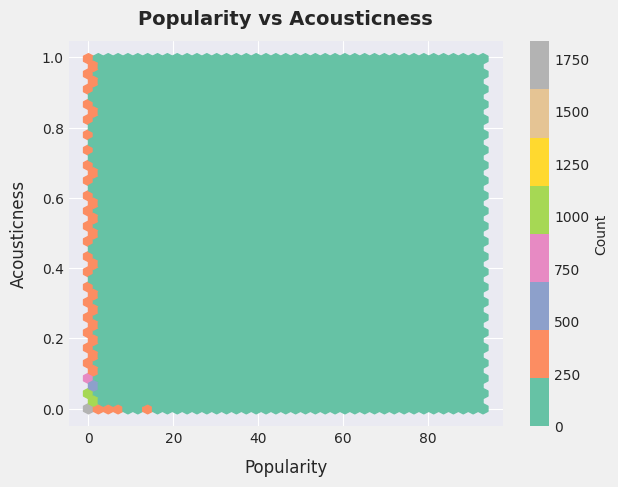

In [211]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["popularity"], spotify["acousticness"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Popularity", fontsize = 12, labelpad = 10)
plt.ylabel("Acousticness", fontsize = 12, labelpad = 10)
plt.title("Popularity vs Acousticness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

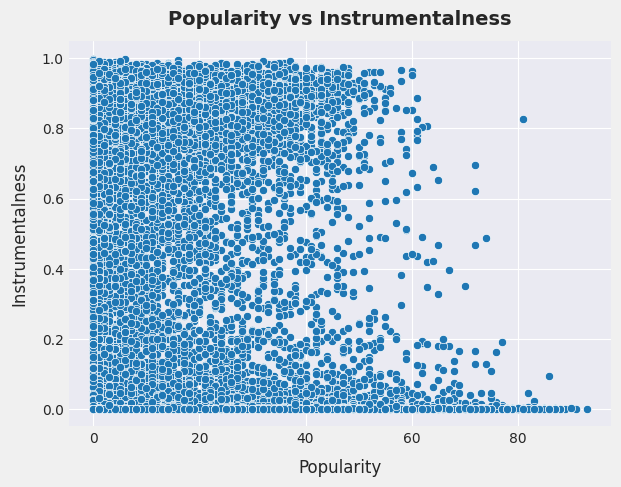

In [214]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="instrumentalness", color = '#1f77b4')
plt.xlabel("Popularity", fontsize = 12, labelpad = 10)
plt.ylabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.title("Popularity vs Instrumentalness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

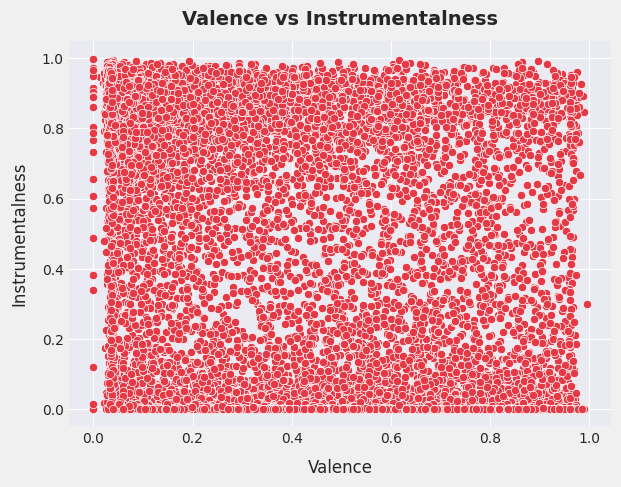

In [217]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="valence", y="instrumentalness", color = '#e63946')
plt.xlabel("Valence", fontsize = 12, labelpad = 10)
plt.ylabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.title("Valence vs Instrumentalness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

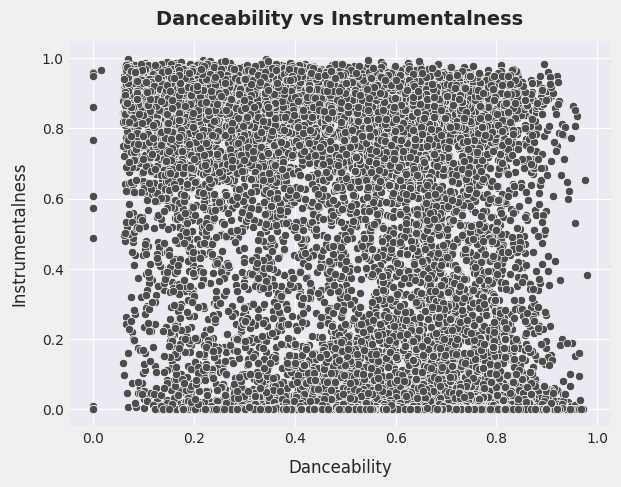

In [220]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="danceability", y="instrumentalness", color = '#4d4d4d')
plt.xlabel("Danceability", fontsize = 12, labelpad = 10)
plt.ylabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.title("Danceability vs Instrumentalness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

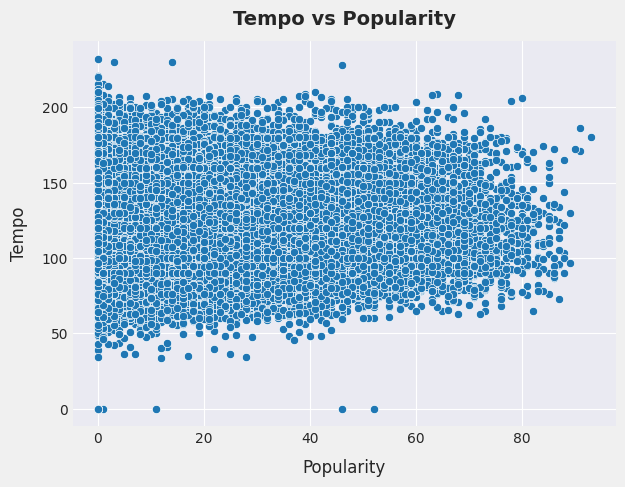

In [223]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="tempo", color = '#1f77b4')
plt.title("Tempo vs Popularity", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Popularity', fontsize = 12, labelpad = 10)
plt.ylabel('Tempo', fontsize = 12, labelpad = 10)
plt.show()

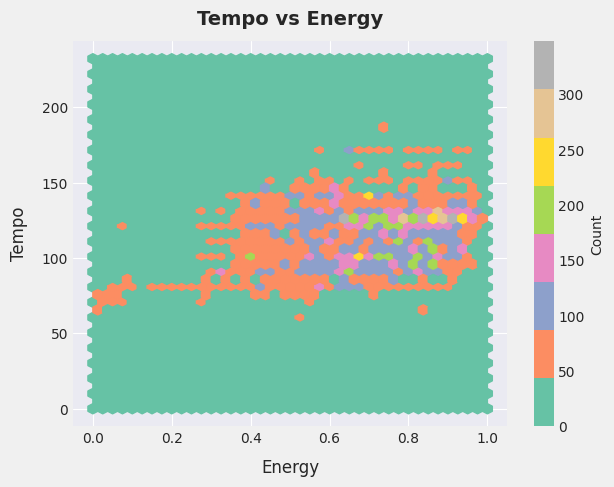

In [226]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["energy"], spotify["tempo"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.title("Tempo vs Energy", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Energy', fontsize = 12, labelpad = 10)
plt.ylabel('Tempo', fontsize = 12, labelpad = 10)
plt.show()

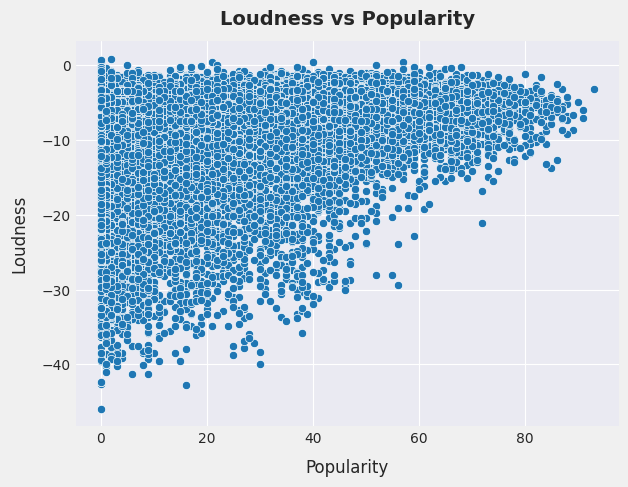

In [229]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="loudness", color = '#1f77b4')
plt.title("Loudness vs Popularity", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Popularity', fontsize = 12, labelpad = 10)
plt.ylabel('Loudness', fontsize = 12, labelpad = 10)
plt.show()

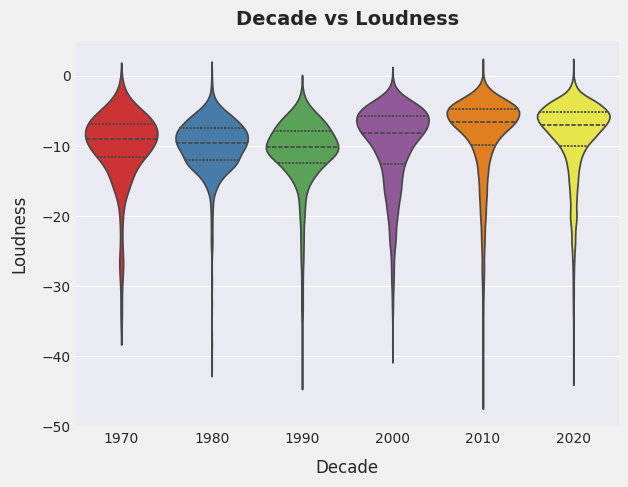

In [232]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.violinplot(data=spotify, x="decade", y="loudness", palette="Set1", inner="quartile")
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Loudness", fontsize = 12, labelpad = 10)
plt.title("Decade vs Loudness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

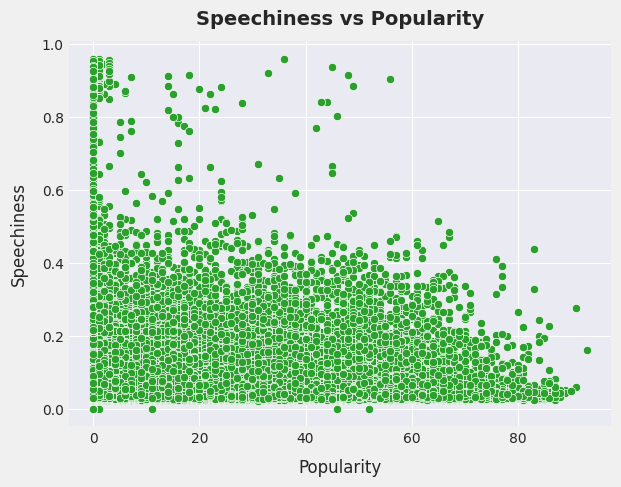

In [235]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="speechiness", color = '#2ca02c')
plt.title("Speechiness vs Popularity", fontsize = 14, pad = 12, fontweight='bold')
plt.xlabel('Popularity', fontsize = 12, labelpad = 10)
plt.ylabel('Speechiness', fontsize = 12, labelpad = 10)
plt.show()


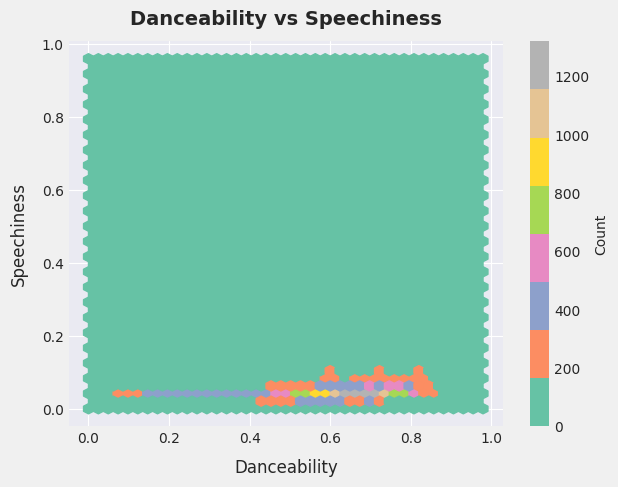

In [238]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
plt.hexbin(spotify["danceability"], spotify["speechiness"], gridsize=40, cmap="Set2")
plt.colorbar(label="Count")
plt.xlabel("Danceability", fontsize = 12, labelpad = 10)
plt.ylabel("Speechiness", fontsize = 12, labelpad = 10)
plt.title("Danceability vs Speechiness", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

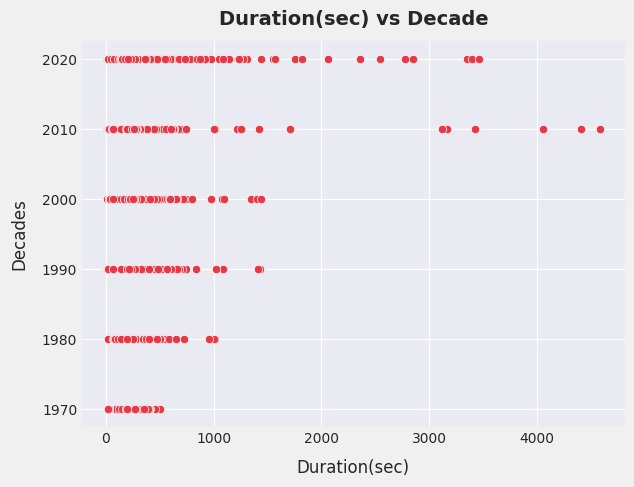

In [241]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="duration_sec", y="decade", color = '#e63946')
plt.xlabel("Duration(sec)", fontsize = 12, labelpad = 10)
plt.ylabel("Decades", fontsize = 12, labelpad = 10)
plt.title("Duration(sec) vs Decade", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

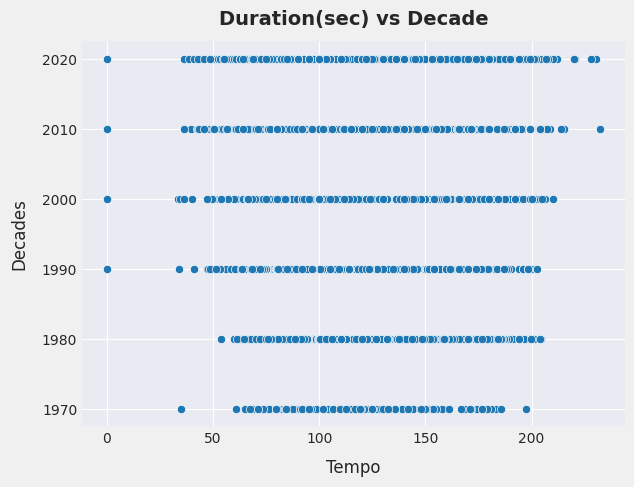

In [244]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="tempo", y="decade", color = '#1f77b4')
plt.xlabel("Tempo", fontsize = 12, labelpad = 10)
plt.ylabel("Decades", fontsize = 12, labelpad = 10)
plt.title("Duration(sec) vs Decade", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

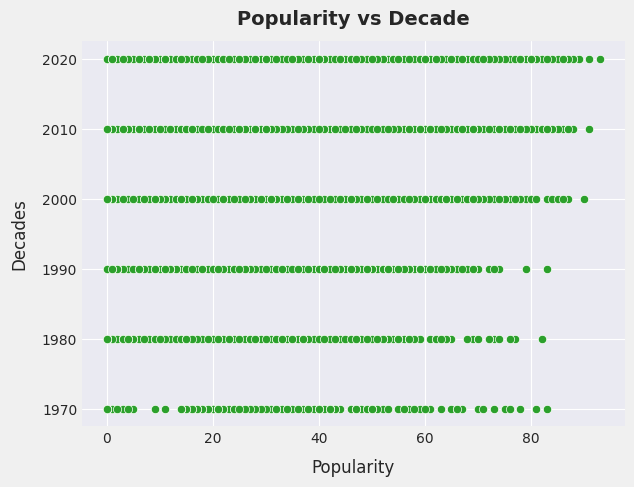

In [247]:
plt.figure(figsize=(7,5), facecolor="#f0f0f0")
sns.scatterplot(data=spotify, x="popularity", y="decade", color = '#2ca02c')
plt.xlabel("Popularity", fontsize = 12, labelpad = 10)
plt.ylabel("Decades", fontsize = 12, labelpad = 10)
plt.title("Popularity vs Decade", fontsize = 14, pad = 12, fontweight='bold')
plt.show()

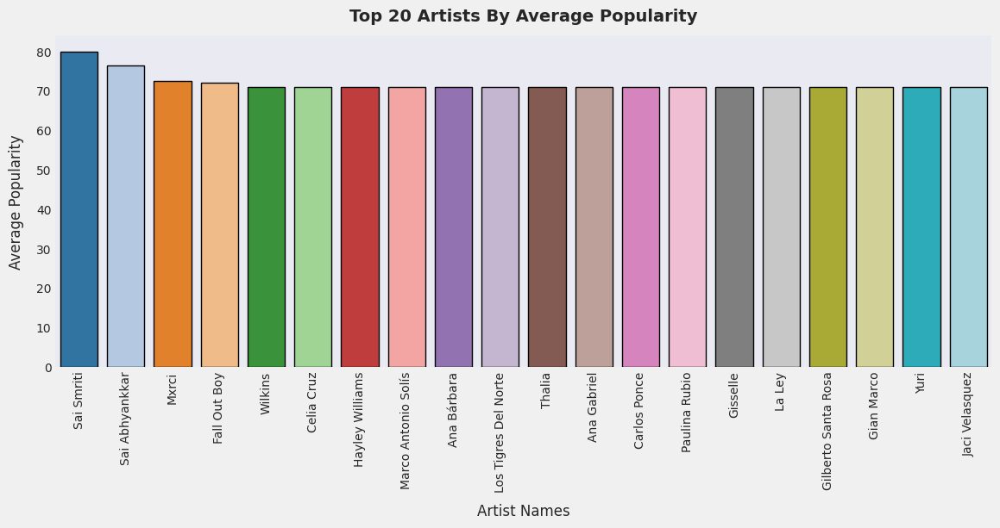

In [250]:
top20_artists = spotify_artists.groupby('artist_name')['popularity'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Popularity',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Popularity', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

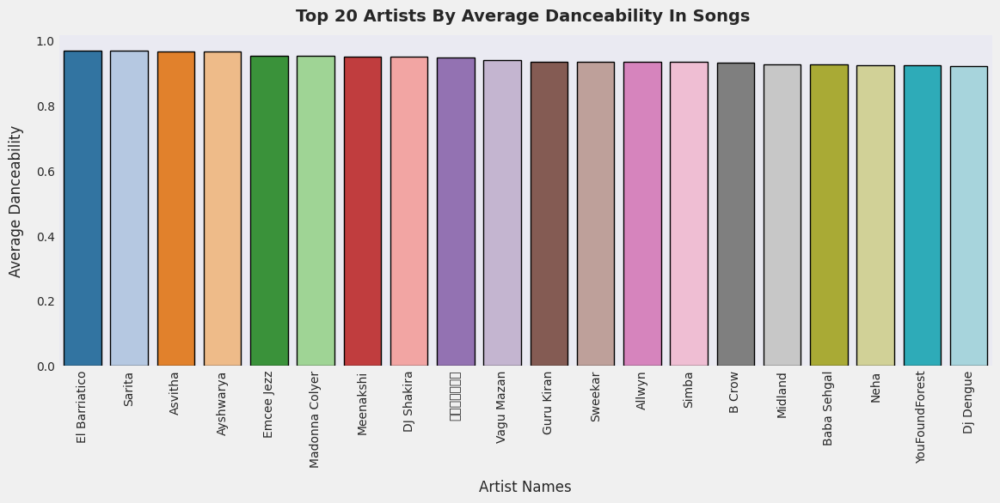

In [253]:
top20_artists = spotify_artists.groupby('artist_name')['danceability'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Danceability In Songs ',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Danceability', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

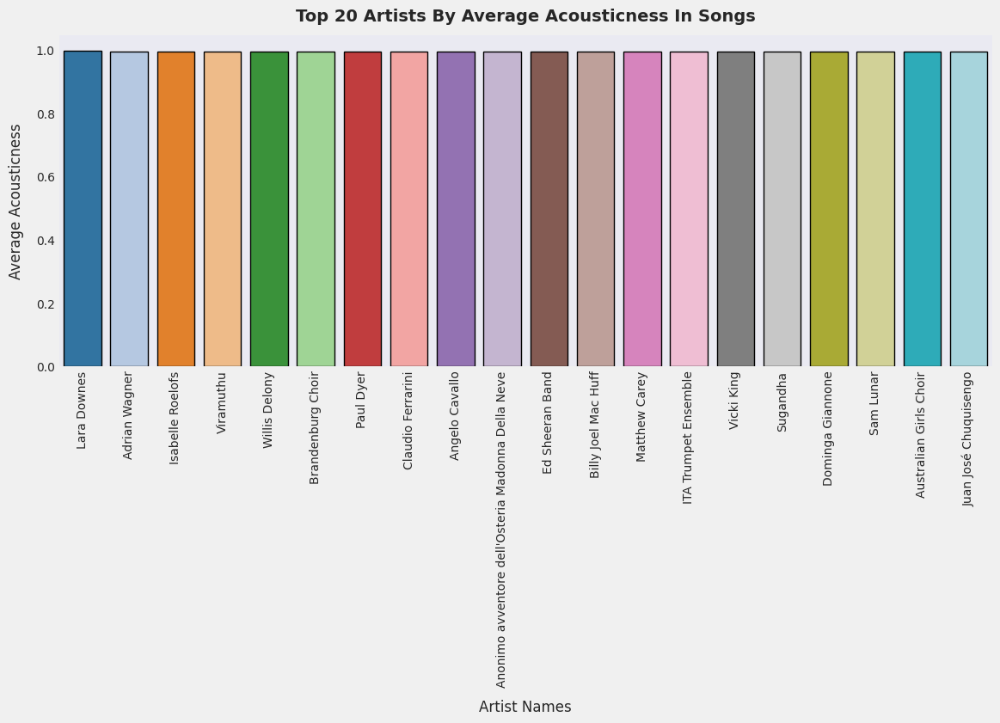

In [256]:
top20_artists = spotify_artists.groupby('artist_name')['acousticness'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Acousticness In Songs',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Acousticness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

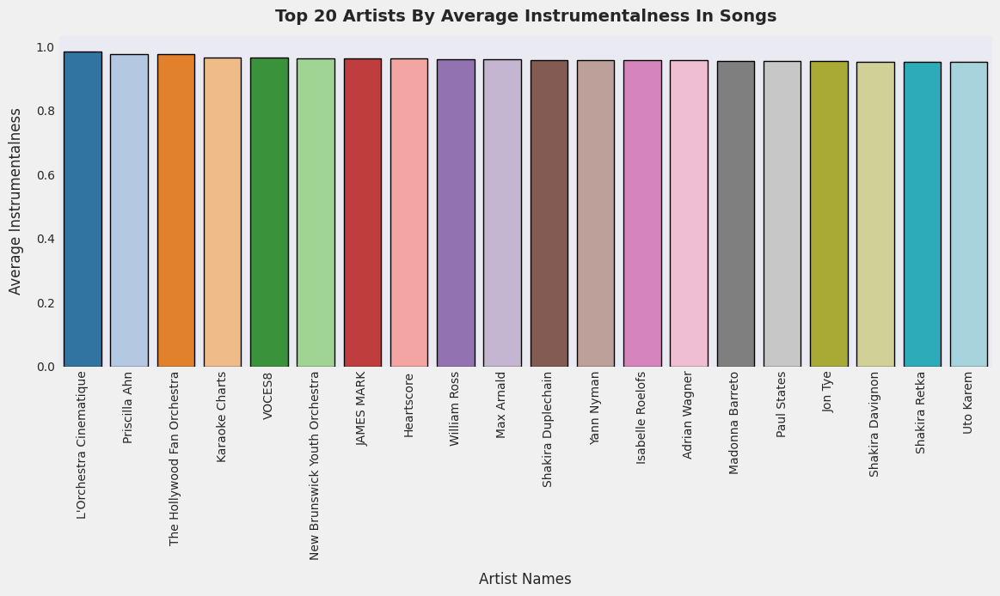

In [259]:
top20_artists = spotify_artists.groupby('artist_name')['instrumentalness'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Instrumentalness In Songs',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Instrumentalness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

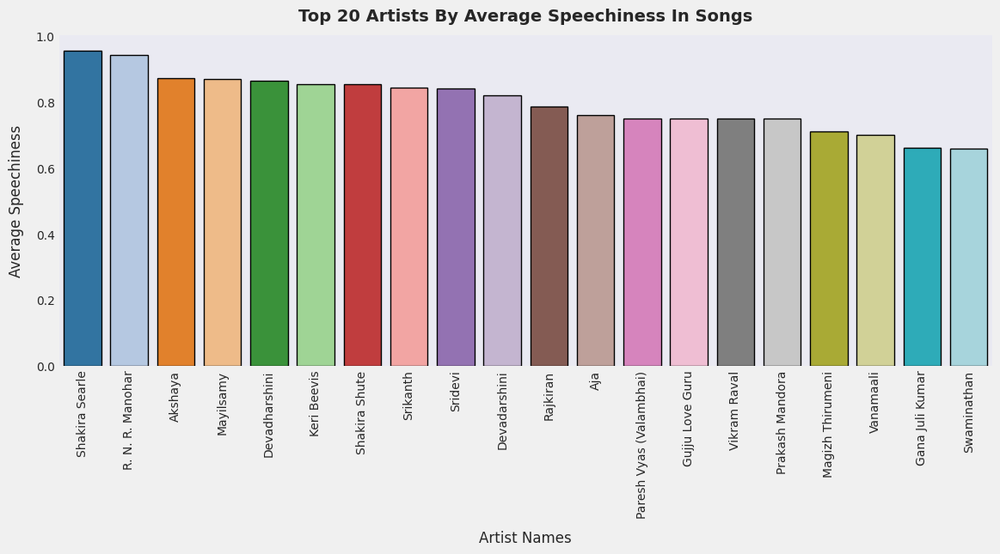

In [262]:
top20_artists = spotify_artists.groupby('artist_name')['speechiness'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(x=top20_artists.index, y=top20_artists.values, palette='tab20', edgecolor='black')
plt.title('Top 20 Artists By Average Speechiness In Songs',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Artist Names', fontsize = 12, labelpad = 10)
plt.ylabel('Average Speechiness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

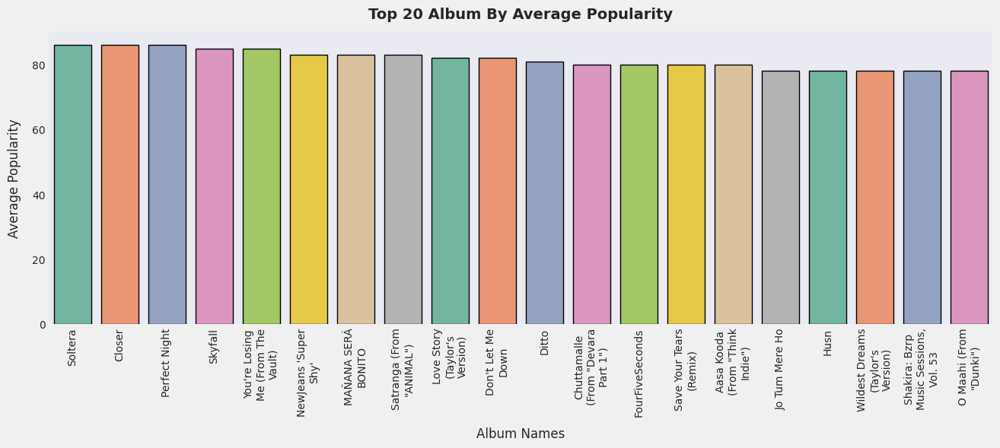

In [265]:
import textwrap

top20_albums = (spotify.groupby('album_name')['popularity'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=15)) for x in top20_albums.index]

plt.figure(figsize=(16,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Album By Average Popularity', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Popularity', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

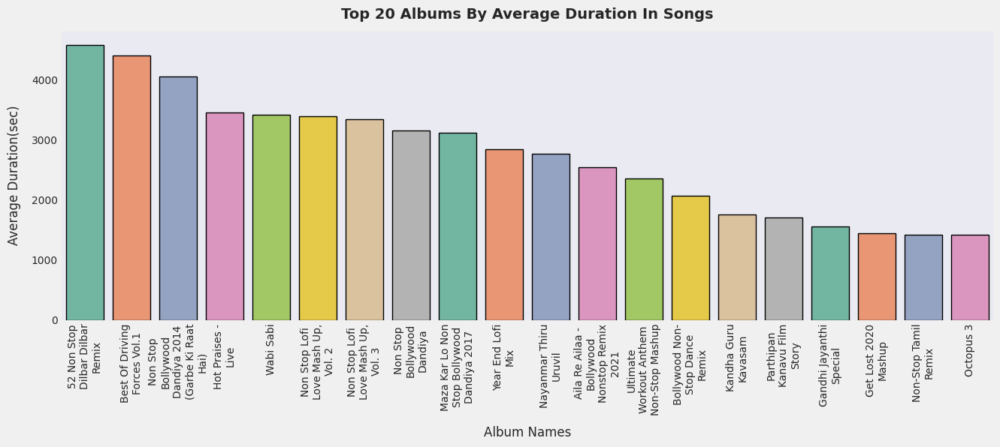

In [268]:
top20_albums = (spotify.groupby('album_name')['duration_sec'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=15)) for x in top20_albums.index]

plt.figure(figsize=(16,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Duration In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Duration(sec)', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()


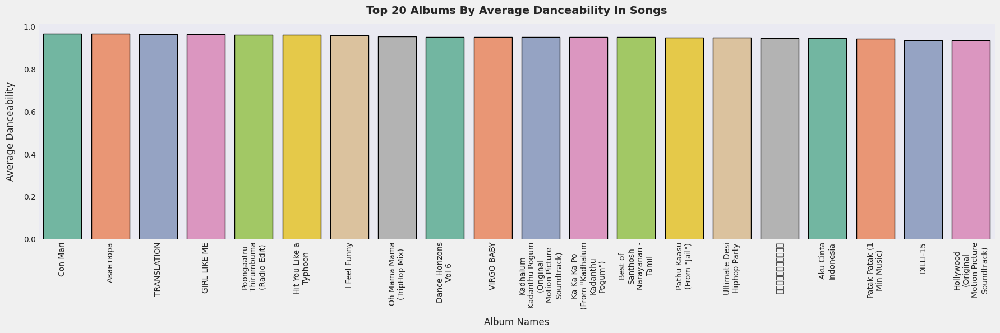

In [271]:
top20_albums = (spotify.groupby('album_name')['danceability'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=15)) for x in top20_albums.index]

plt.figure(figsize=(22,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Danceability In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Danceability', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()


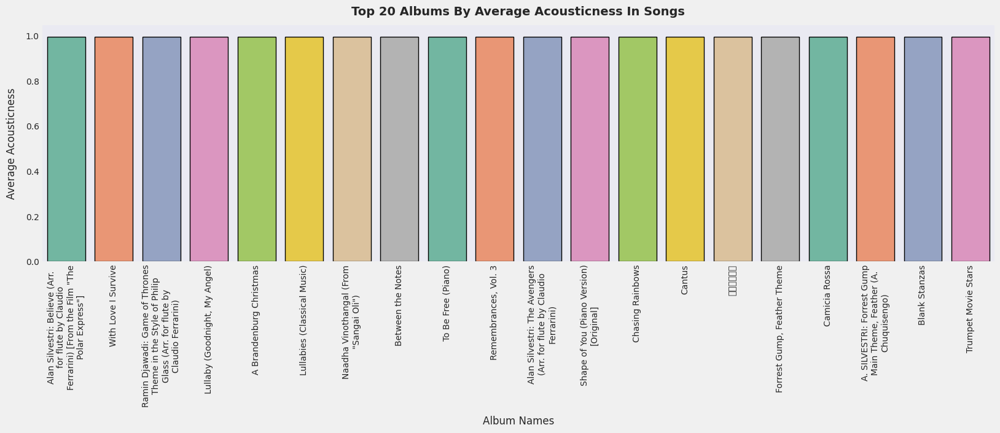

In [274]:
top20_albums = (spotify.groupby('album_name')['acousticness'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=30)) for x in top20_albums.index]

plt.figure(figsize=(20,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Acousticness In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Acousticness', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

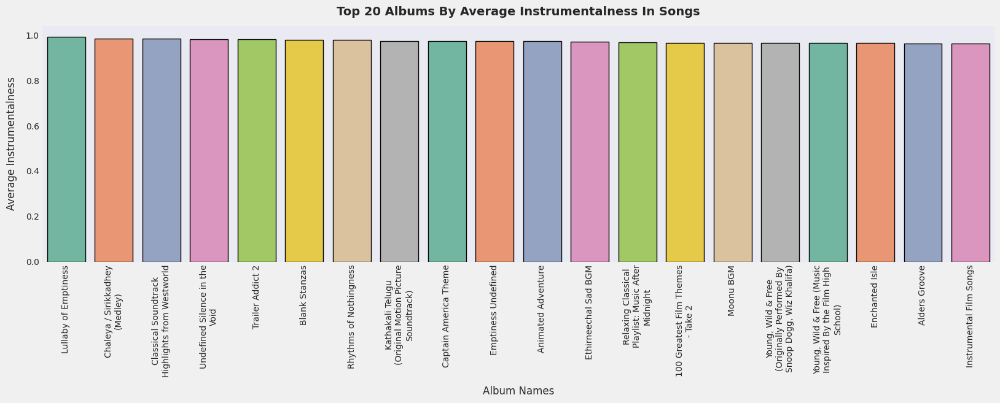

In [277]:
top20_albums = (spotify.groupby('album_name')['instrumentalness'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=25)) for x in top20_albums.index]

plt.figure(figsize=(20,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Instrumentalness In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Instrumentalness', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

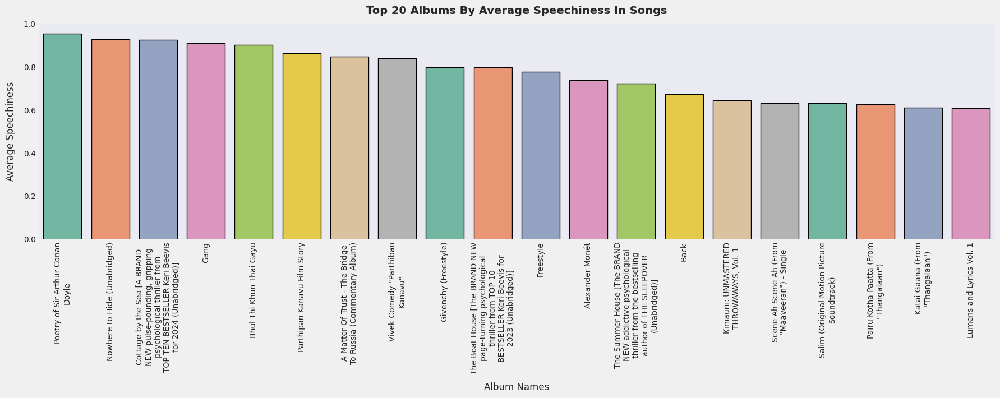

In [280]:
top20_albums = (spotify.groupby('album_name')['speechiness'].mean().sort_values(ascending=False).head(20))

labels = ["\n".join(textwrap.wrap(str(x), width=30)) for x in top20_albums.index]

plt.figure(figsize=(22,5), facecolor='#f0f0f0')
sns.barplot(x=labels, y=top20_albums.values, palette='Set2', edgecolor='black')
plt.title('Top 20 Albums By Average Speechiness In Songs', fontsize=14, pad=12, fontweight='bold')
plt.xlabel('Album Names', fontsize=12, labelpad=10)
plt.ylabel('Average Speechiness', fontsize=12, labelpad=10)
plt.xticks(rotation=90)
plt.grid(False)
plt.show()

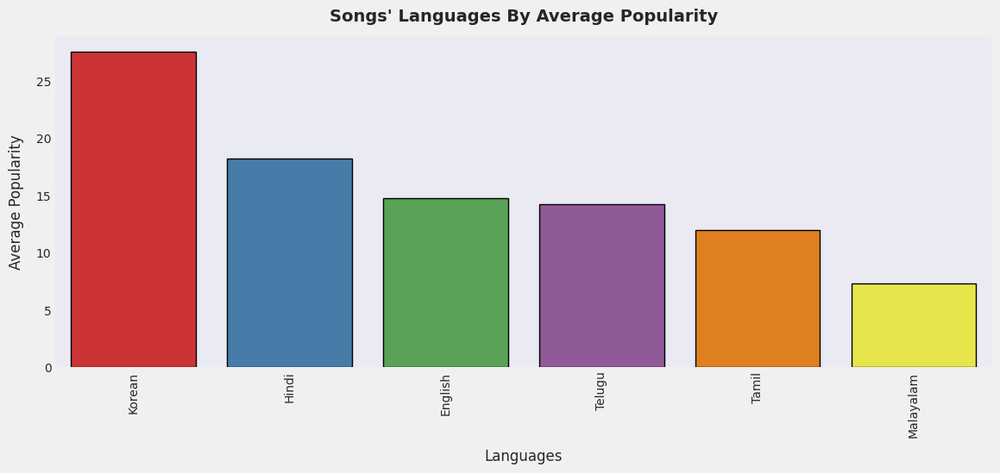

In [283]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['popularity'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Popularity',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Popularity', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

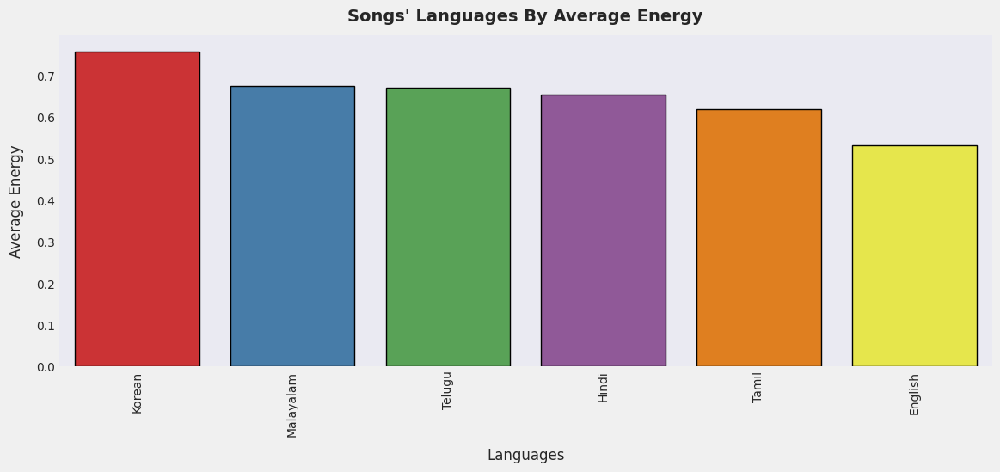

In [286]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['energy'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Energy',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Energy', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

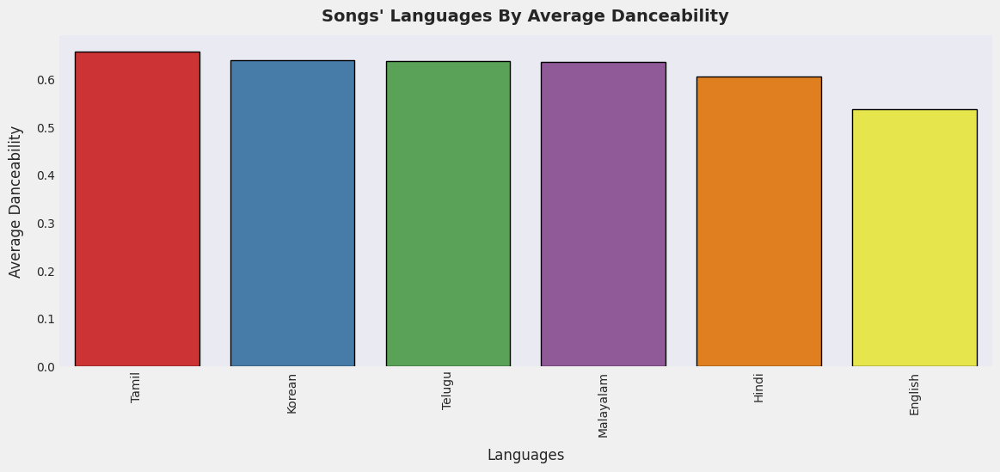

In [289]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['danceability'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Danceability',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Danceability', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

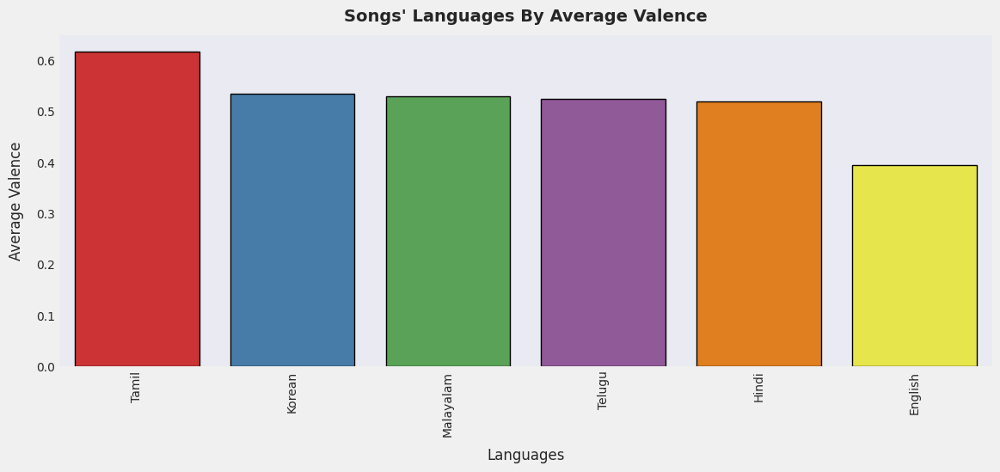

In [292]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['valence'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Valence',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Valence', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

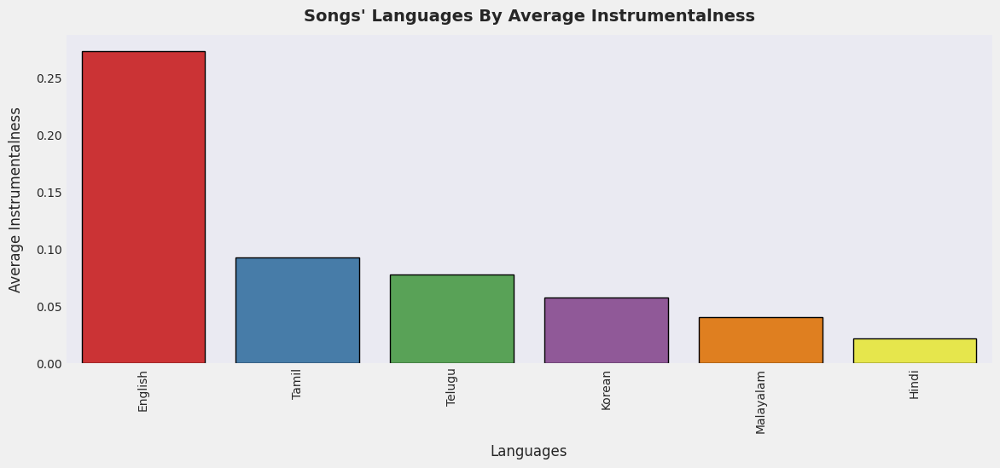

In [295]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['instrumentalness'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Instrumentalness',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Instrumentalness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

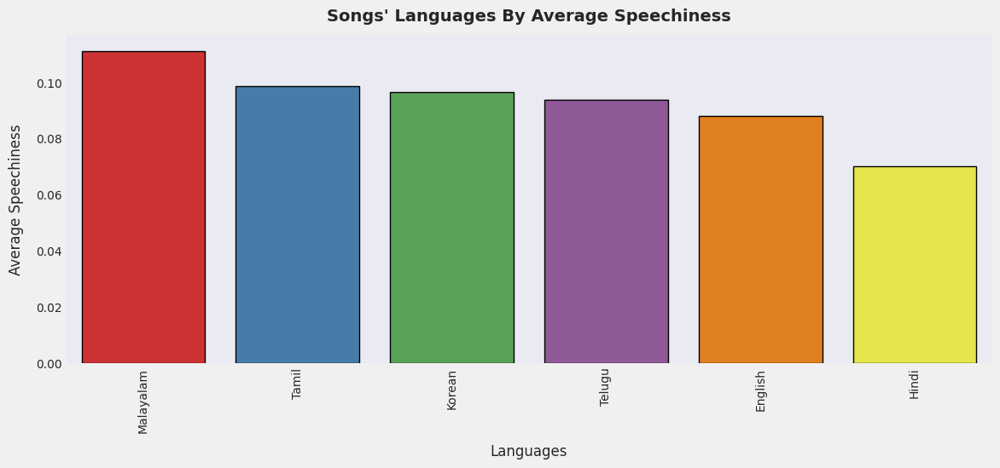

In [298]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('language')['speechiness'].mean().sort_values(ascending=False), palette='Set1', edgecolor='black')
plt.title('Songs\' Languages By Average Speechiness',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Languages', fontsize = 12, labelpad = 10)
plt.ylabel('Average Speechiness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

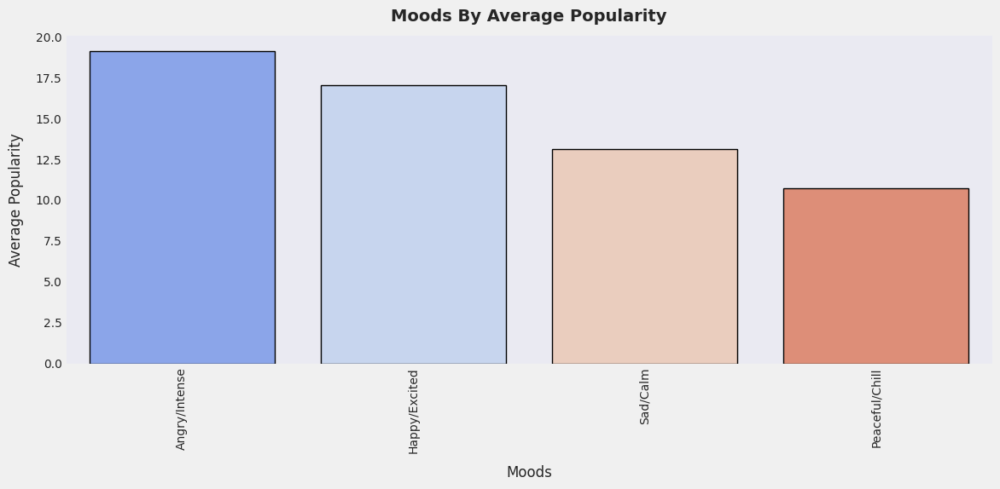

In [301]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['popularity'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Popularity',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Popularity', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

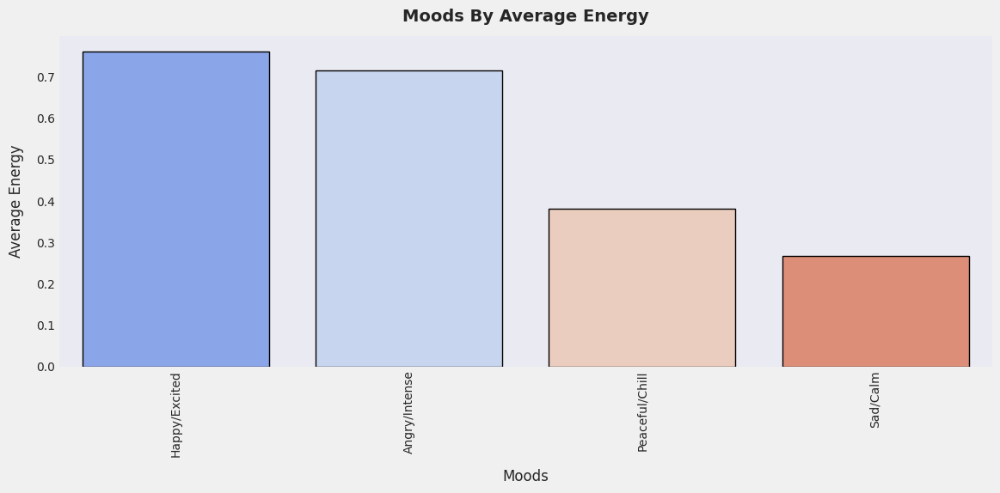

In [304]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['energy'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Energy',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Energy', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

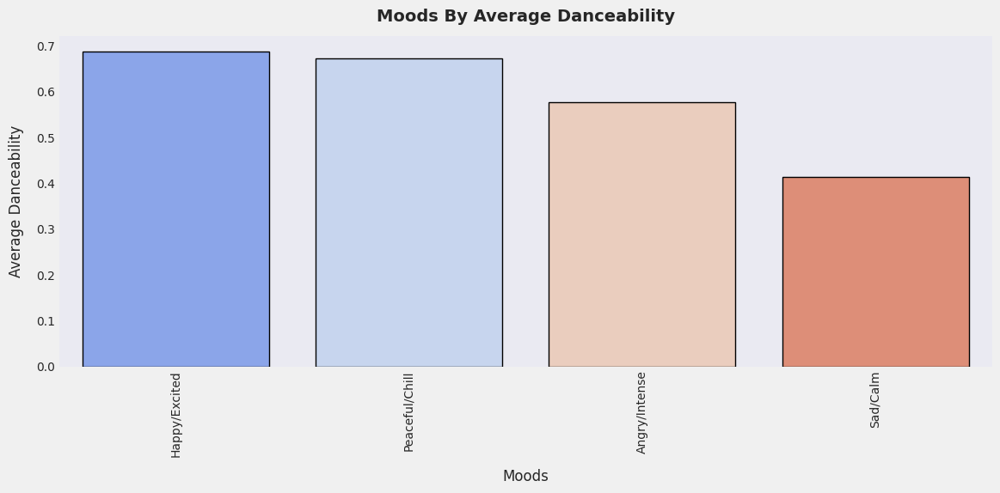

In [307]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['danceability'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Danceability',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Danceability', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

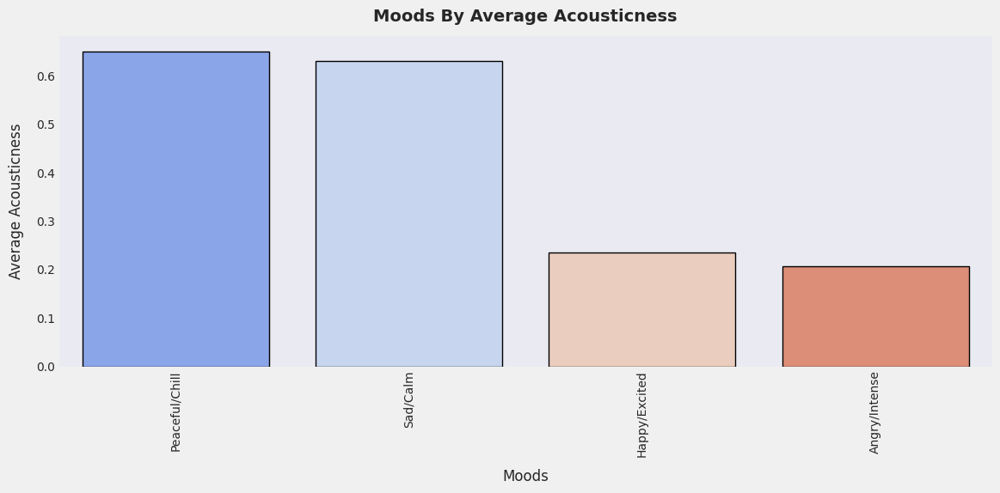

In [310]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['acousticness'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Acousticness',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Acousticness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

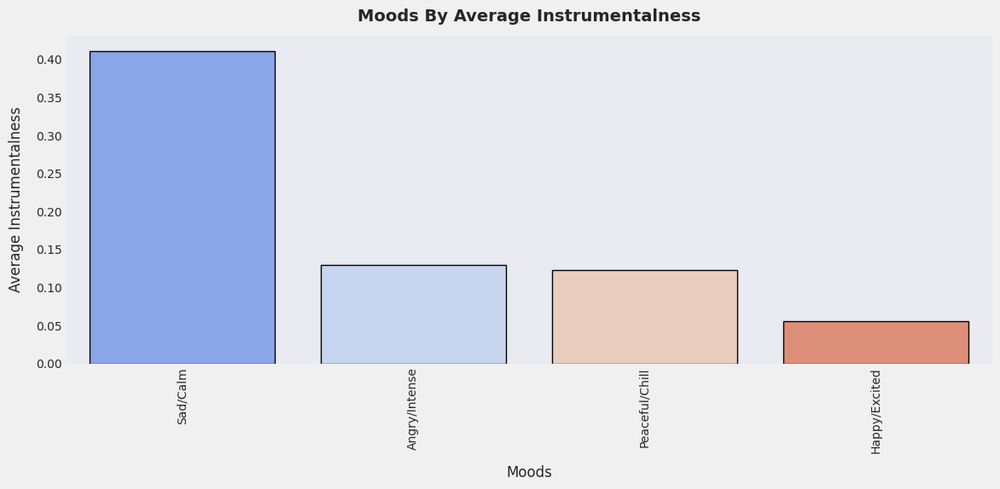

In [313]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['instrumentalness'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Instrumentalness',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Instrumentalness', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

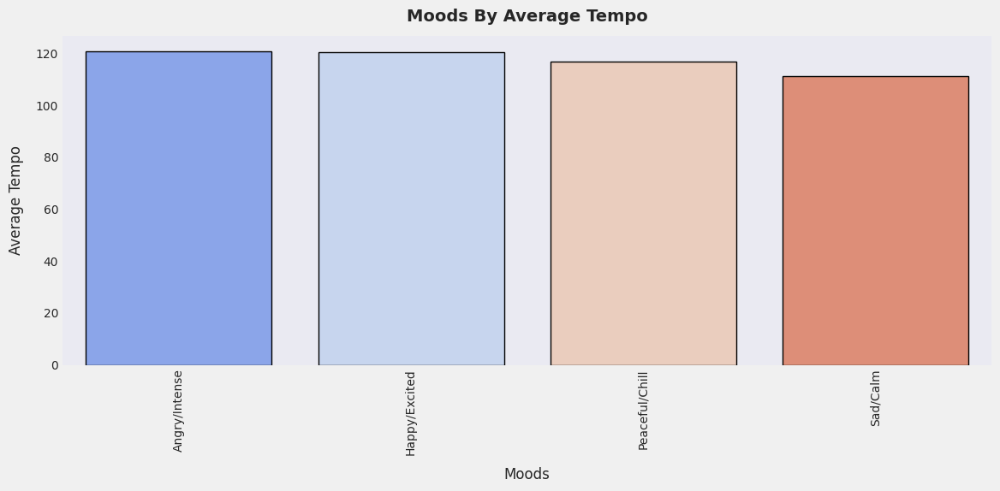

In [316]:
plt.figure(figsize=(14,5), facecolor='#f0f0f0')
sns.barplot(spotify.groupby('mood')['tempo'].mean().sort_values(ascending=False), palette='coolwarm', edgecolor='black')
plt.title('Moods By Average Tempo',fontsize = 14, pad = 12, fontweight='bold' )
plt.xlabel('Moods', fontsize = 12, labelpad = 10)
plt.ylabel('Average Tempo', fontsize = 12, labelpad = 10)
plt.xticks(rotation = 90)
plt.grid(False)
plt.show()

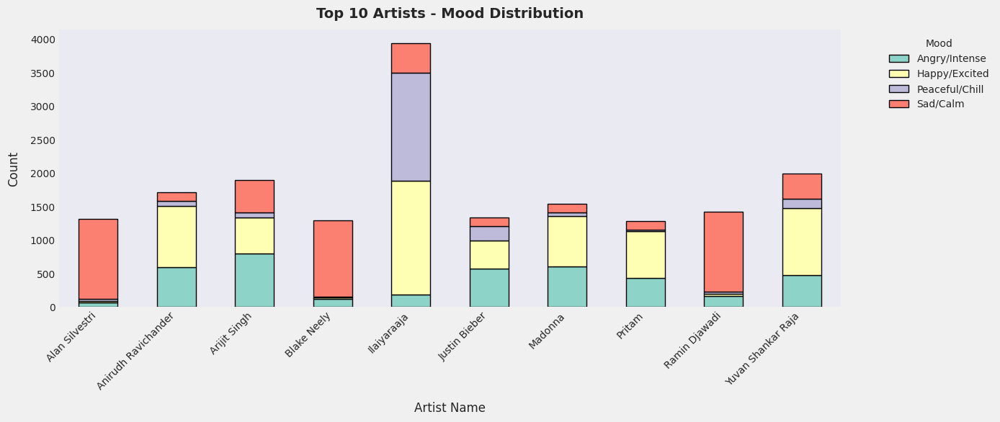

In [319]:
top_artists = spotify_artists['artist_name'].value_counts().head(10).index
artist_mood = spotify_artists[spotify_artists['artist_name'].isin(top_artists)]

# Create crosstab for stacked bar
artist_mood_ct = pd.crosstab(artist_mood['artist_name'], artist_mood['mood'])

# Plot stacked bar
artist_mood_ct.plot(kind='bar', stacked=True, figsize=(14,5), color=sns.color_palette("Set3", len(artist_mood_ct.columns)), edgecolor='black')

plt.title("Top 10 Artists - Mood Distribution", pad = 12, fontsize=14, fontweight='bold')
plt.xlabel("Artist Name", fontsize=12, labelpad = 10)
plt.ylabel("Count", fontsize=12, labelpad = 10)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Mood", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.gcf().set_facecolor('#f0f0f0')
plt.grid(False)
plt.show()

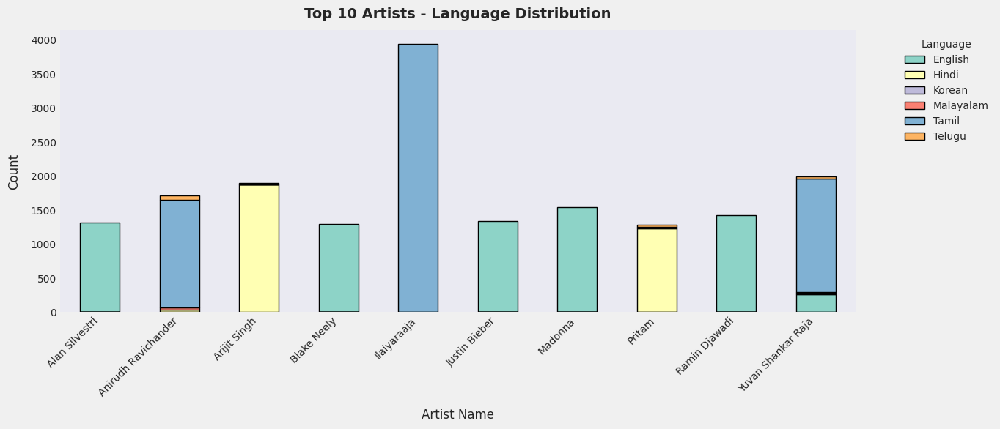

In [322]:
top_artists = spotify_artists['artist_name'].value_counts().head(10).index
artist_mood = spotify_artists[spotify_artists['artist_name'].isin(top_artists)]

# Create crosstab for stacked bar
artist_mood_ct = pd.crosstab(artist_mood['artist_name'], artist_mood['language'])

# Plot stacked bar
artist_mood_ct.plot(kind='bar', stacked=True, figsize=(14,5), color=sns.color_palette("Set3", len(artist_mood_ct.columns)), edgecolor='black')

plt.title("Top 10 Artists - Language Distribution", pad = 12, fontsize=14, fontweight='bold')
plt.xlabel("Artist Name", fontsize=12, labelpad = 10)
plt.ylabel("Count", fontsize=12, labelpad = 10)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Language", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.gcf().set_facecolor('#f0f0f0')
plt.grid(False)
plt.show()

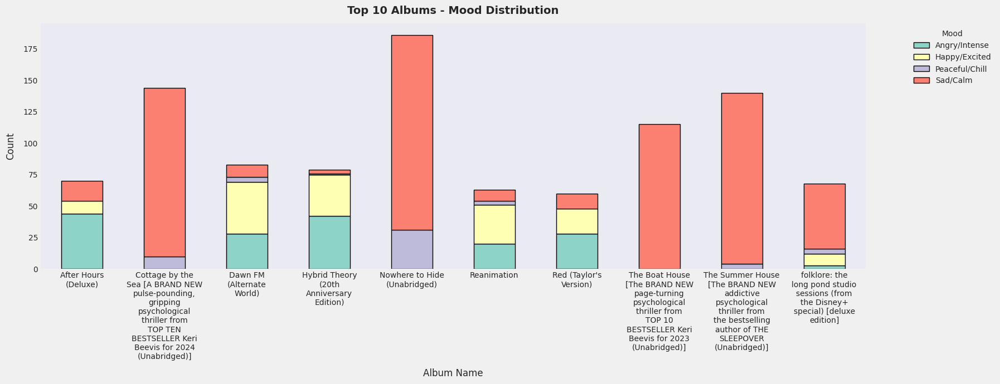

In [325]:
top_artists = spotify['album_name'].value_counts().head(10).index
artist_mood = spotify[spotify['album_name'].isin(top_artists)]
artist_mood_ct = pd.crosstab(artist_mood['album_name'], artist_mood['mood'])

# Wrap album names in the index (same style as the reference barplot)
wrap_width = 16.5
wrapped_idx = ["\n".join(textwrap.wrap(str(x), width=wrap_width)) for x in artist_mood_ct.index]

# Reindex with wrapped labels for plotting only
plot_df = artist_mood_ct.copy()
plot_df.index = wrapped_idx

# Plot stacked bar with wrapped labels
ax = plot_df.plot(
    kind='bar', stacked=True, figsize=(18,7),
    color=sns.color_palette("Set3", len(plot_df.columns)),
    edgecolor='black'
)

plt.title("Top 10 Albums - Mood Distribution", pad=12, fontsize=14, fontweight='bold')
plt.xlabel("Album Name", fontsize=12, labelpad=10)
plt.ylabel("Count", fontsize=12, labelpad=10)
plt.xticks(rotation=0, ha="center")
plt.legend(title="Mood", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.gcf().set_facecolor('#f0f0f0')
plt.grid(False)
plt.tight_layout()
plt.show()


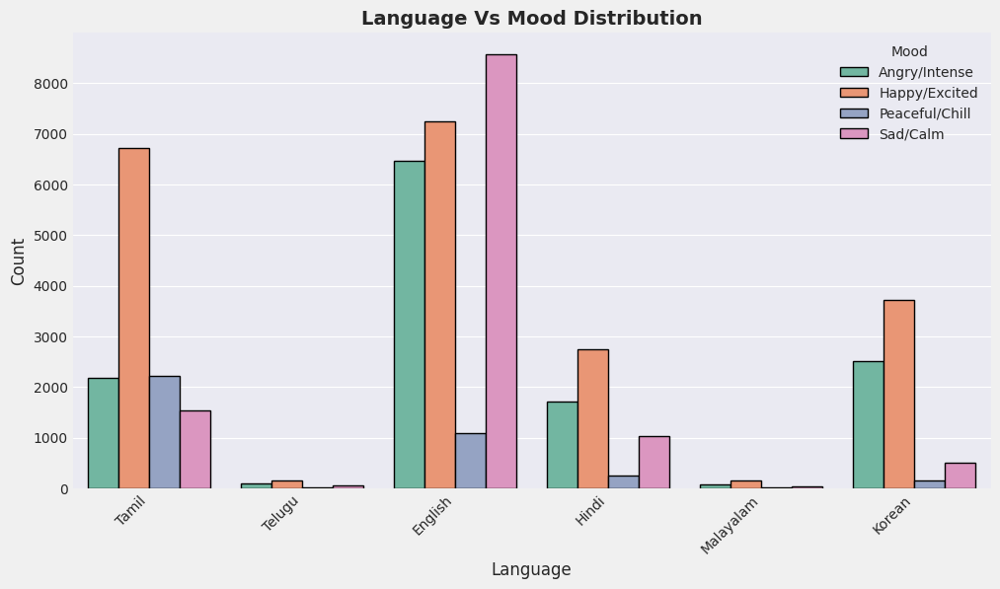

In [328]:
# Grouped bar: count of moods per artist
plt.figure(figsize=(12,6), facecolor='#f0f0f0')
sns.countplot(data=spotify, x='language', hue='mood', palette='Set2', edgecolor='black')

plt.title("Language Vs Mood Distribution", fontsize=14, fontweight='bold')
plt.xlabel("Language", fontsize=12)
plt.ylabel("Count", fontsize=12)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Mood")
plt.show()


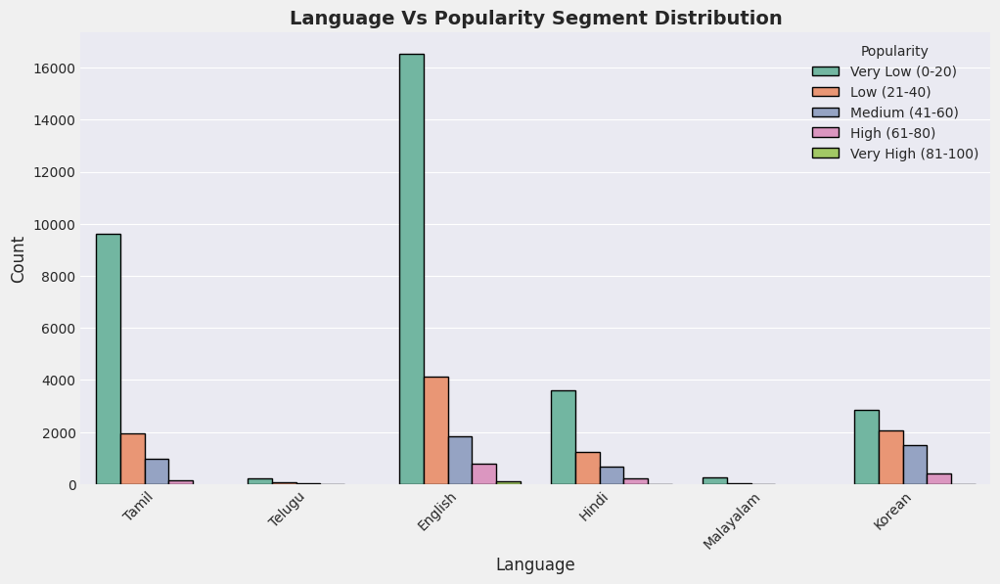

In [331]:
plt.figure(figsize=(12,6), facecolor='#f0f0f0')
sns.countplot(data=spotify, x='language', hue='popularity_segment', palette='Set2', edgecolor='black')

plt.title("Language Vs Popularity Segment Distribution", fontsize=14, fontweight='bold')
plt.xlabel("Language", fontsize=12)
plt.ylabel("Count", fontsize=12)
plt.xticks(rotation=45, ha="right")
plt.legend(title="Popularity")
plt.show()


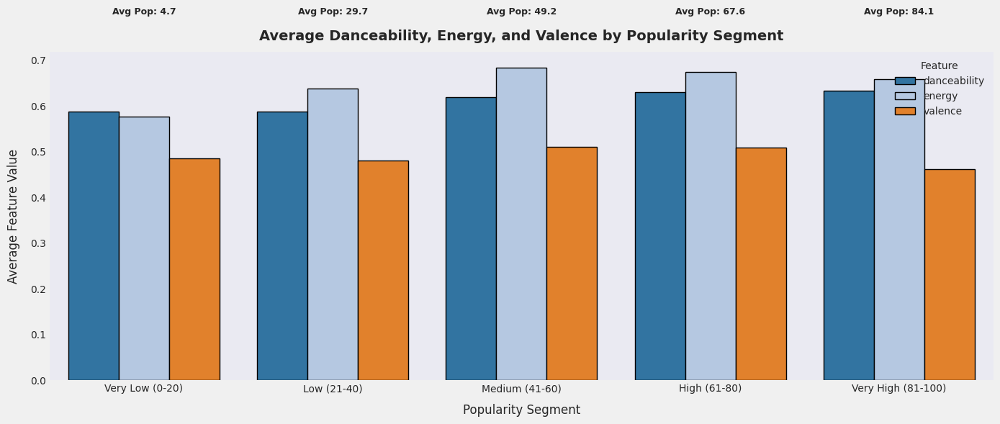

In [334]:
# Group by popularity segment and compute averages
avg_features = spotify.groupby("popularity_segment")[["danceability", "energy", "valence", "popularity"]].mean().reset_index()

# Melt for grouped bar plotting
avg_melted = avg_features.melt(id_vars=["popularity_segment", "popularity"],value_vars=["danceability", "energy", "valence"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted,x="popularity_segment",y="Average Value",hue="Feature",palette="tab20",edgecolor="black")

# Add average popularity annotations
for i, row in avg_features.iterrows():
    plt.text(x=i, y=.80, s=f"Avg Pop: {row['popularity']:.1f}", ha="center", fontsize=9, fontweight="bold")

plt.title("Average Danceability, Energy, and Valence by Popularity Segment", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Popularity Segment", fontsize = 12, labelpad =10)
plt.ylabel("Average Feature Value", fontsize = 12, labelpad = 10)
plt.legend(title="Feature")
plt.tight_layout()
plt.grid(False)
plt.show()


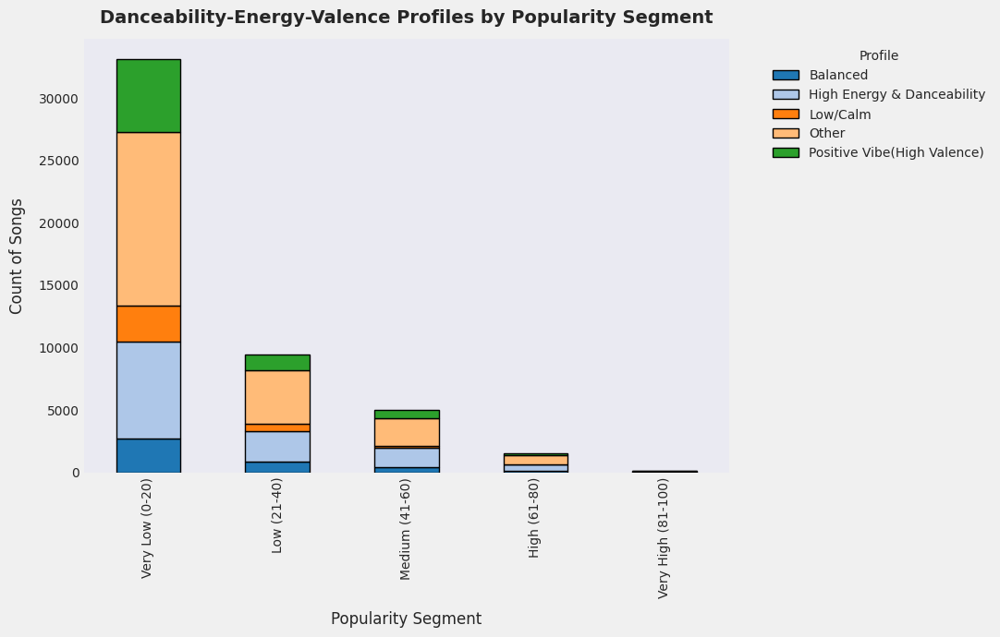

In [337]:
# Bin each variable into Low/Medium/High
spotify['danceability_bin'] = pd.cut(spotify['danceability'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['energy_bin']       = pd.cut(spotify['energy'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['valence_bin']      = pd.cut(spotify['valence'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def get_profile(row):
    if row['danceability_bin']=='Medium' and row['energy_bin']=='Medium' and row['valence_bin']=='Medium':
        return 'Balanced'
    elif row['energy_bin']=='High' and row['danceability_bin']=='High':
        return 'High Energy & Danceability'
    elif row['valence_bin']=='High':
        return 'Positive Vibe(High Valence)'
    elif row['danceability_bin']=='Low' and row['energy_bin']=='Low' and row['valence_bin']=='Low':
        return 'Low/Calm'
    else:
        return 'Other'

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("tab20", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Danceability-Energy-Valence Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()


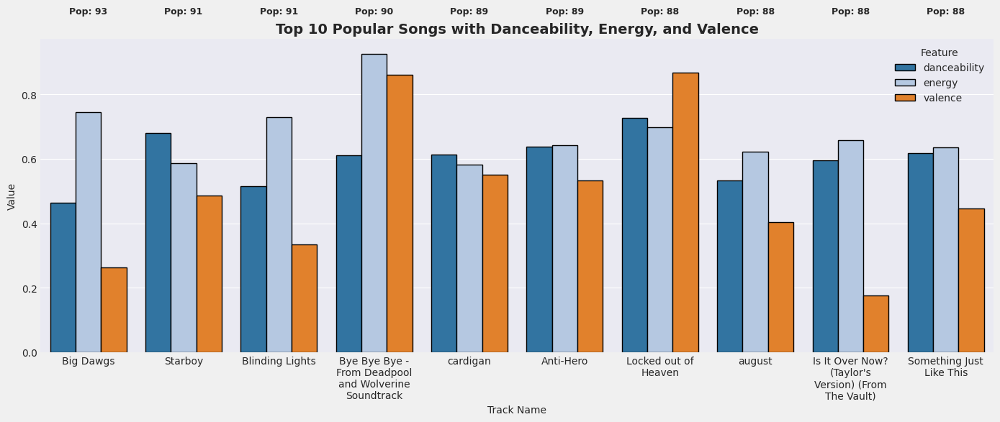

In [340]:
# Get top 10 popular songs
top10 = spotify.sort_values(by="popularity", ascending=False).head(10)

# Wrap long track names
top10["track_name_wrapped"] = top10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=15)))

# Select relevant columns for plotting
features = ["danceability", "energy", "valence"]
top10_melted = top10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=top10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="tab20",edgecolor="black")

# Rotate x labels (kept slight tilt for readability)
plt.xticks(rotation=0, ha="center")

# Add popularity annotations
for i, row in top10.iterrows():
    plt.text(x=top10.index.get_loc(i), y=1.05, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Top 10 Popular Songs with Danceability, Energy, and Valence", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()


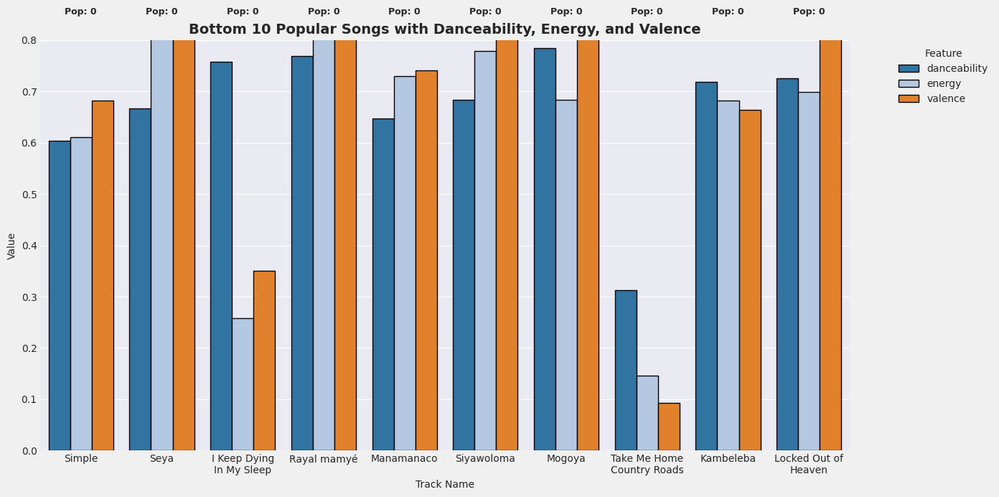

In [343]:
# Bottom 10 popular songs
bottom10 = spotify.sort_values(by="popularity", ascending=False).tail(10)

# Wrap long track names
bottom10["track_name_wrapped"] = bottom10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=13)))

# Select relevant columns for plotting
features = ["danceability", "energy", "valence"]
bottom10_melted = bottom10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,7), facecolor="#f0f0f0")
sns.barplot(data=bottom10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="tab20",edgecolor="black")

# Rotate x labels slightly for readability
plt.xticks(rotation=0, ha="center")

# Set y-axis limit higher so bars are visible
plt.ylim(0, .8)

# Add popularity annotations
for i, row in bottom10.iterrows():
    plt.text(x=bottom10.index.get_loc(i), y=.85, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Bottom 10 Popular Songs with Danceability, Energy, and Valence", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()


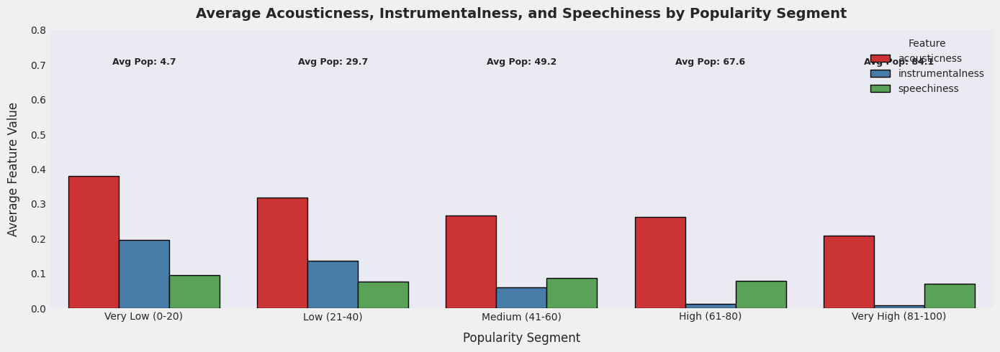

In [346]:
avg_features = spotify.groupby("popularity_segment")[["acousticness", "instrumentalness", "speechiness", "popularity"]].mean().reset_index()

# Melt for grouped bar plotting
avg_melted = avg_features.melt(id_vars=["popularity_segment", "popularity"],value_vars=["acousticness", "instrumentalness", "speechiness"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(14,5), facecolor="#f0f0f0")
sns.barplot(data=avg_melted,x="popularity_segment",y="Average Value",hue="Feature",palette="Set1",edgecolor="black")
plt.ylim(0, .8)
# Add average popularity annotations
for i, row in avg_features.iterrows():
    plt.text(x=i, y=.7, s=f"Avg Pop: {row['popularity']:.1f}", ha="center", fontsize=9, fontweight="bold")

plt.title("Average Acousticness, Instrumentalness, and Speechiness by Popularity Segment", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Popularity Segment", fontsize = 12, labelpad =10)
plt.ylabel("Average Feature Value", fontsize = 12, labelpad = 10)
plt.legend(title="Feature")
plt.tight_layout()
plt.grid(False)
plt.show()

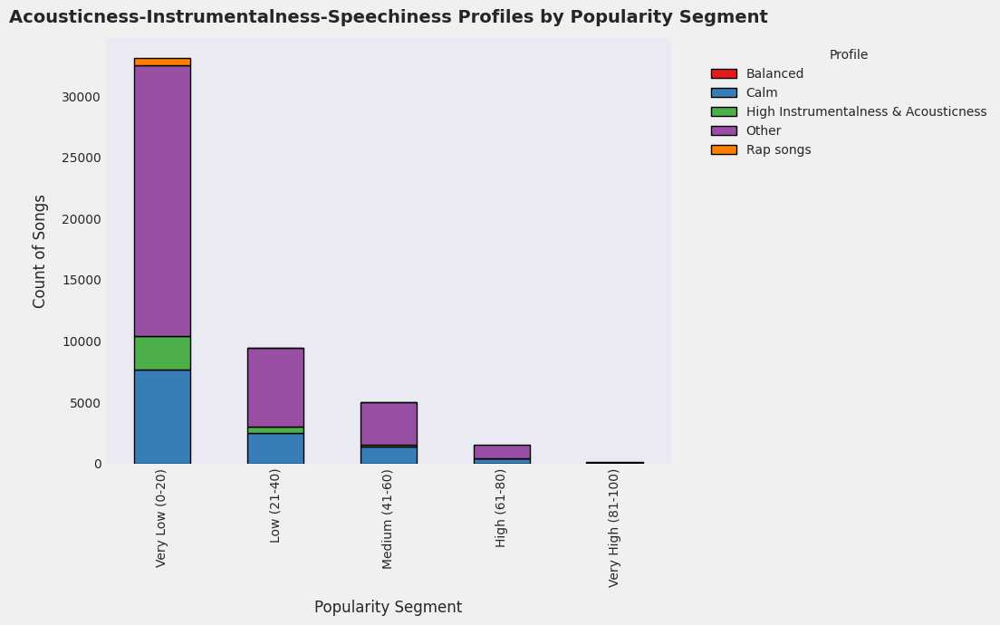

In [349]:
spotify['acousticness_bin'] = pd.cut(spotify['acousticness'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['instrumentalness_bin']       = pd.cut(spotify['instrumentalness'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['speechiness_bin']      = pd.cut(spotify['speechiness'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def get_profile(row):
    if row['acousticness_bin']=='Medium' and row['instrumentalness_bin']=='Medium' and row['speechiness_bin']=='Medium':
        return 'Balanced'
    elif row['instrumentalness_bin']=='High' and row['acousticness_bin']=='High':
        return 'High Instrumentalness & Acousticness'
    elif row['speechiness_bin']=='High':
        return 'Rap songs'
    elif row['acousticness_bin']=='Low' and row['instrumentalness_bin']=='Low' and row['speechiness_bin']=='Low':
        return 'Calm'
    else:
        return 'Other'

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("Set1", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Acousticness-Instrumentalness-Speechiness Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()


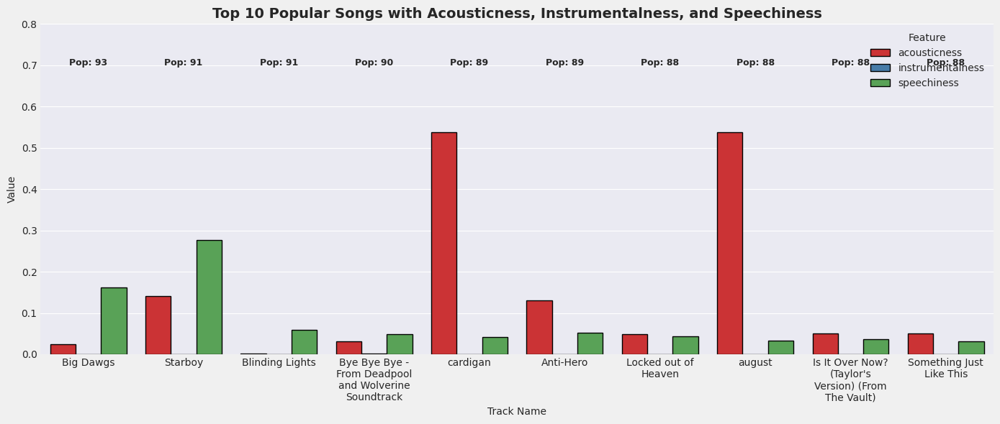

In [352]:
top10 = spotify.sort_values(by="popularity", ascending=False).head(10)

# Wrap long track names
top10["track_name_wrapped"] = top10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=15)))

# Select relevant columns for plotting
features = ["acousticness", "instrumentalness", "speechiness"]
top10_melted = top10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=top10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="Set1",edgecolor="black")
plt.ylim(0,0.8)
# Rotate x labels (kept slight tilt for readability)
plt.xticks(rotation=0, ha="center")

# Add popularity annotations
for i, row in top10.iterrows():
    plt.text(x=top10.index.get_loc(i), y=.7, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Top 10 Popular Songs with Acousticness, Instrumentalness, and Speechiness", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()


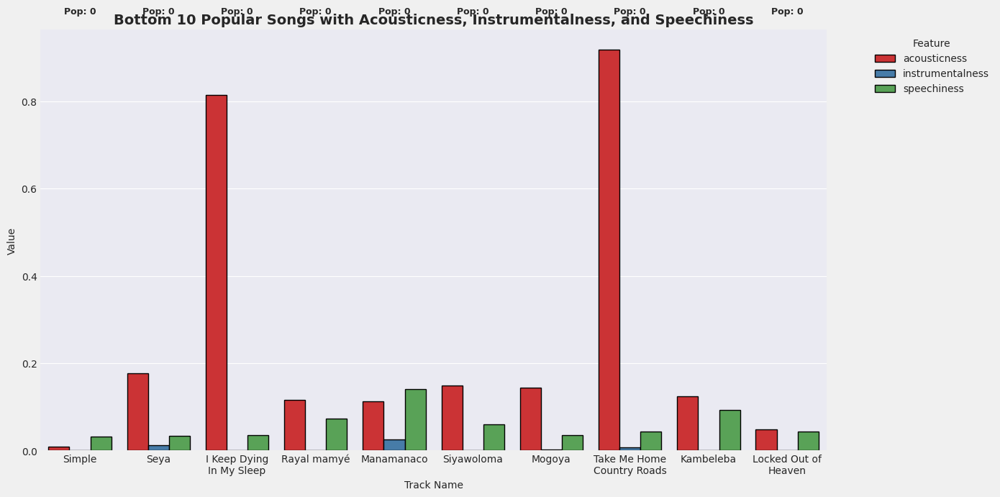

In [355]:
bottom10 = spotify.sort_values(by="popularity", ascending=False).tail(10)

# Wrap long track names
bottom10["track_name_wrapped"] = bottom10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=13)))

# Select relevant columns for plotting
features = ["acousticness", "instrumentalness", "speechiness"]
bottom10_melted = bottom10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,7), facecolor="#f0f0f0")
sns.barplot(data=bottom10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="Set1",edgecolor="black")

# Rotate x labels slightly for readability
plt.xticks(rotation=0, ha="center")

# Set y-axis limit higher so bars are visible
# plt.ylim(0, .8)

# Add popularity annotations
for i, row in bottom10.iterrows():
    plt.text(x=bottom10.index.get_loc(i), y=1, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Bottom 10 Popular Songs with Acousticness, Instrumentalness, and Speechiness", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()


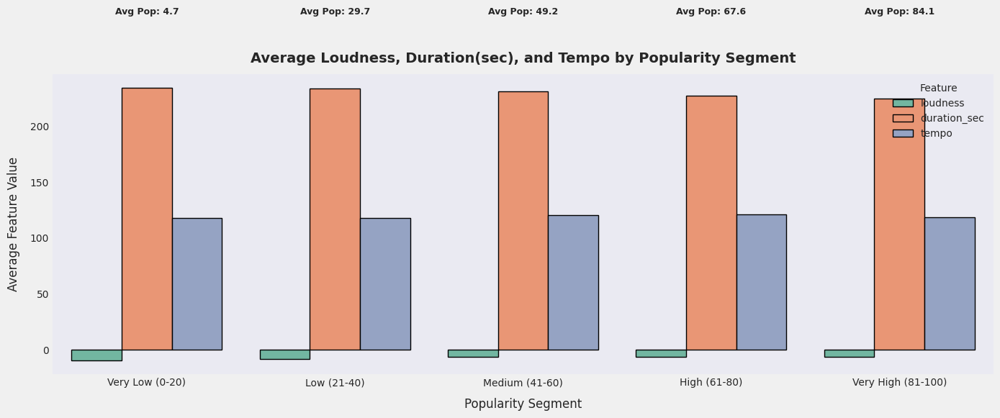

In [358]:
avg_features = spotify.groupby("popularity_segment")[["loudness", "duration_sec", "tempo", "popularity"]].mean().reset_index()

# Melt for grouped bar plotting
avg_melted = avg_features.melt(id_vars=["popularity_segment", "popularity"],value_vars=["loudness", "duration_sec", "tempo"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted,x="popularity_segment",y="Average Value",hue="Feature",palette="Set2",edgecolor="black")

# Add average popularity annotations
for i, row in avg_features.iterrows():
    plt.text(x=i, y=300, s=f"Avg Pop: {row['popularity']:.1f}", ha="center", fontsize=9, fontweight="bold")

plt.title("Average Loudness, Duration(sec), and Tempo by Popularity Segment", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Popularity Segment", fontsize = 12, labelpad =10)
plt.ylabel("Average Feature Value", fontsize = 12, labelpad = 10)
plt.legend(title="Feature")
plt.tight_layout()
plt.grid(False)
plt.show()


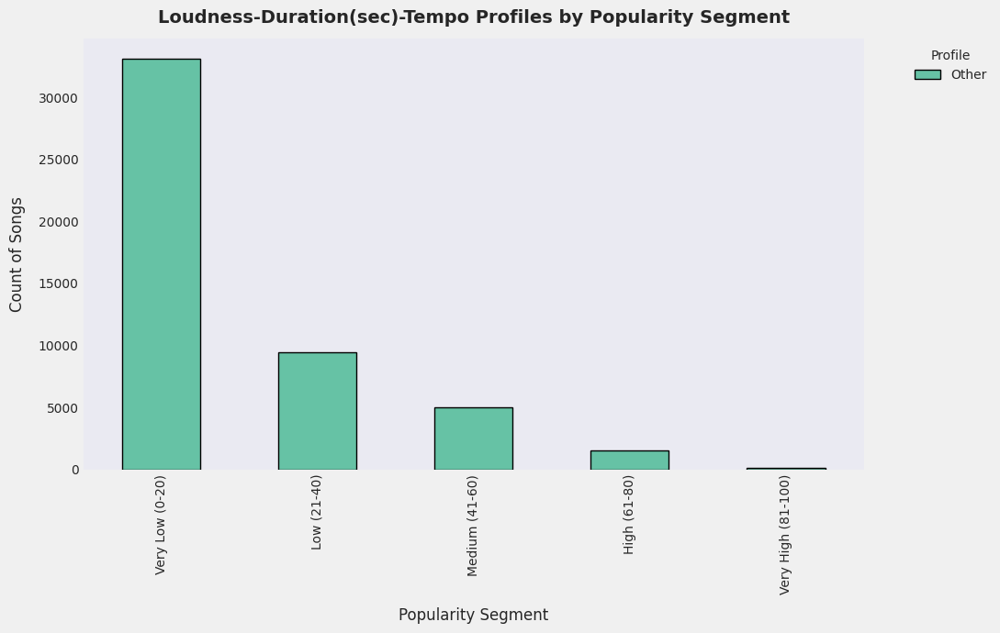

In [361]:
spotify['loudness_bin'] = pd.cut(spotify['loudness'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['duration_sec_bin']       = pd.cut(spotify['duration_sec'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['tempo_bin']      = pd.cut(spotify['tempo'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def get_profile(row):
    if row['loudness_bin']=='Medium' and row['duration_sec_bin']=='Medium' and row['tempo_bin']=='Medium':
        return 'Balanced'
    elif row['duration_sec_bin']=='High' and row['loudness_bin']=='High':
        return 'High Duration & Loudness'
    elif row['tempo_bin']=='High':
        return 'Fast'
    elif row['loudness_bin']=='Low' and row['duration_sec_bin']=='Low' and row['tempo_bin']=='Low':
        return 'Low/Calm'
    elif row['loudness_bin']=='Low' and row['duration_sec_bin']=='Low' and row['tempo_bin']=='Low':
        return 'Low/Calm'
    else:
        return 'Other'

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("Set2", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Loudness-Duration(sec)-Tempo Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()

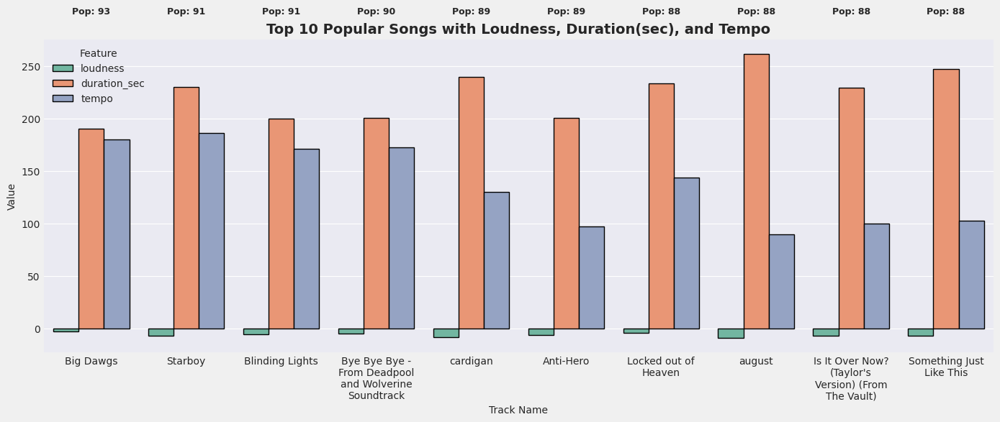

In [364]:
top10 = spotify.sort_values(by="popularity", ascending=False).head(10)

# Wrap long track names
top10["track_name_wrapped"] = top10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=15)))

# Select relevant columns for plotting
features = ["loudness", "duration_sec", "tempo"]
top10_melted = top10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=top10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="Set2",edgecolor="black")

# Rotate x labels (kept slight tilt for readability)
plt.xticks(rotation=0, ha="center")

# Add popularity annotations
for i, row in top10.iterrows():
    plt.text(x=top10.index.get_loc(i), y=300, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Top 10 Popular Songs with Loudness, Duration(sec), and Tempo", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()

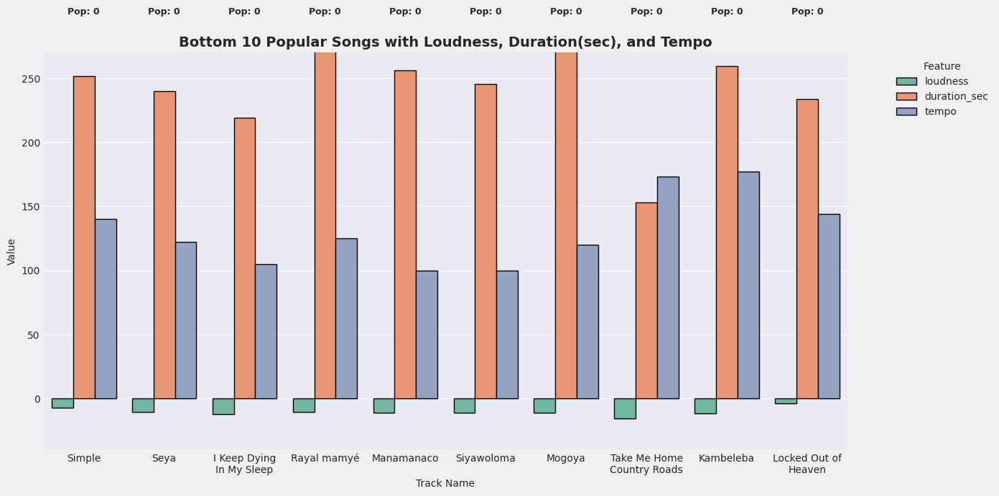

In [367]:
bottom10 = spotify.sort_values(by="popularity", ascending=False).tail(10)

# Wrap long track names
bottom10["track_name_wrapped"] = bottom10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=13)))

# Select relevant columns for plotting
features = ["loudness", "duration_sec", "tempo"]
bottom10_melted = bottom10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,7), facecolor="#f0f0f0")
sns.barplot(data=bottom10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="Set2",edgecolor="black")

# Rotate x labels slightly for readability
plt.xticks(rotation=0, ha="center")

# Set y-axis limit higher so bars are visible
plt.ylim(-40, 270)

# Add popularity annotations
for i, row in bottom10.iterrows():
    plt.text(x=bottom10.index.get_loc(i), y=300, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Bottom 10 Popular Songs with Loudness, Duration(sec), and Tempo", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()


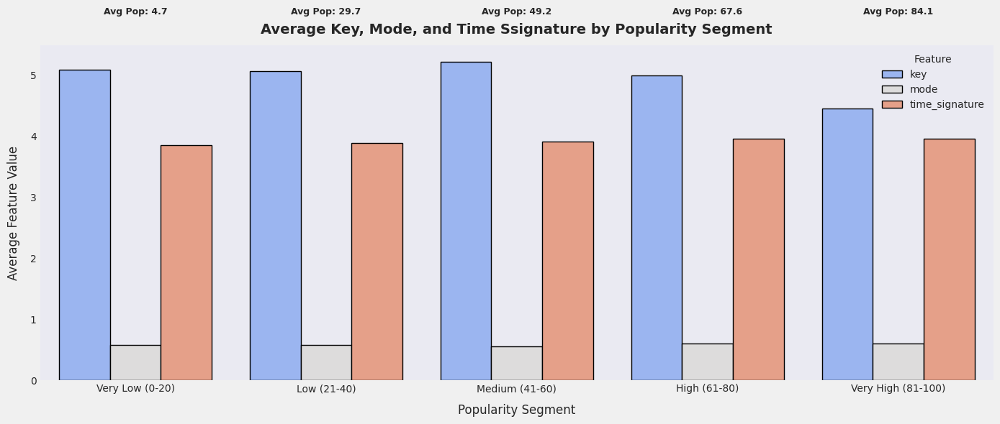

In [370]:
avg_features = spotify.groupby("popularity_segment")[["key", "mode", "time_signature", "popularity"]].mean().reset_index()

# Melt for grouped bar plotting
avg_melted = avg_features.melt(id_vars=["popularity_segment", "popularity"],value_vars=["key", "mode", "time_signature"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted,x="popularity_segment",y="Average Value",hue="Feature",palette="coolwarm",edgecolor="black")

# Add average popularity annotations
for i, row in avg_features.iterrows():
    plt.text(x=i, y=6, s=f"Avg Pop: {row['popularity']:.1f}", ha="center", fontsize=9, fontweight="bold")

plt.title("Average Key, Mode, and Time Ssignature by Popularity Segment", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Popularity Segment", fontsize = 12, labelpad =10)
plt.ylabel("Average Feature Value", fontsize = 12, labelpad = 10)
plt.legend(title="Feature")
plt.tight_layout()
plt.grid(False)
plt.show()

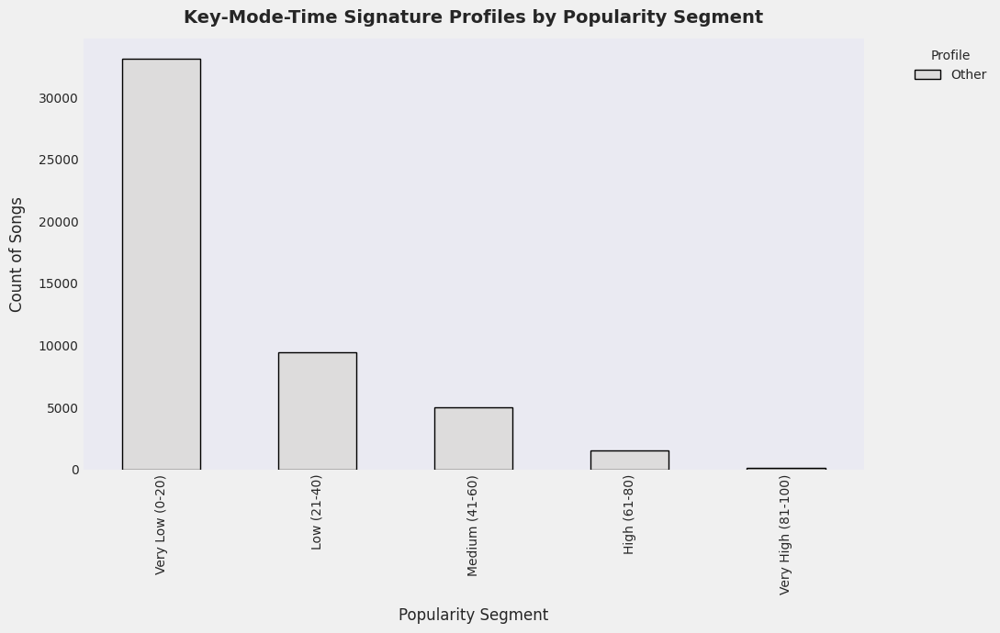

In [373]:
spotify['key_bin'] = pd.cut(spotify['key'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['mode_bin']       = pd.cut(spotify['mode'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['time_signature_bin']      = pd.cut(spotify['time_signature'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def classify_song(row):
    if row['key_bin'] == 'Medium' and row['mode_bin'] == 'Medium' and row['time_signature_bin'] == 'Medium':
        return f"Balanced ({row['key']}, {row['mode']}, {row['time_signature']})"
    elif row['mode_bin'] == 'High' and row['key_bin'] == 'High':
        return f"High mode & key ({row['key']}, {row['mode']})"
    elif row['time_signature_bin'] == 'High':
        return f"Positive Vibe (High time_signature: {row['time_signature']})"
    elif row['key_bin'] == 'Low' and row['mode_bin'] == 'Low' and row['time_signature_bin'] == 'Low':
        return f"Low/Calm ({row['key']}, {row['mode']}, {row['time_signature']})"
    else:
        return f"Other ({row['key']}, {row['mode']}, {row['time_signature']})"

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("coolwarm", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Key-Mode-Time Signature Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()


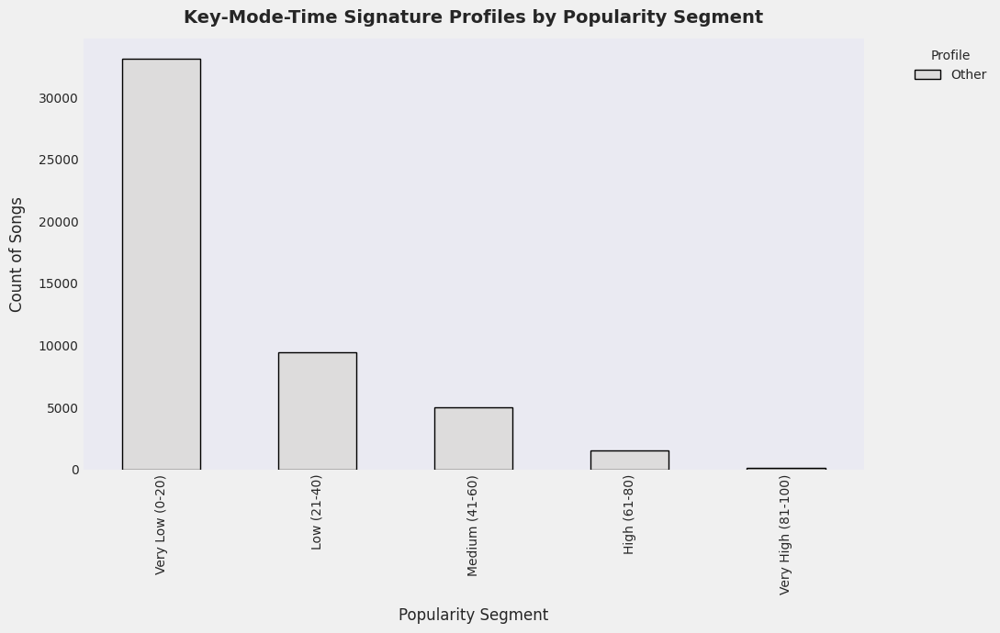

In [376]:
spotify['key_bin'] = pd.cut(spotify['key'], bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['mode_bin']       = pd.cut(spotify['mode'],       bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])
spotify['time_signature_bin']      = pd.cut(spotify['time_signature'],      bins=[0,0.33,0.66,1], labels=['Low','Medium','High'])

# Define collapsed profiles
def classify_song(row):
    if row['key_bin'] == 'Medium' and row['mode_bin'] == 'Medium' and row['time_signature_bin'] == 'Medium':
        return f"Balanced ({row['key']}, {row['mode']}, {row['time_signature']})"
    elif row['mode_bin'] == 'High' and row['key_bin'] == 'High':
        return f"High mode & key ({row['key']}, {row['mode']})"
    elif row['time_signature_bin'] == 'High':
        return f"Positive Vibe (High time_signature: {row['time_signature']})"
    elif row['key_bin'] == 'Low' and row['mode_bin'] == 'Low' and row['time_signature_bin'] == 'Low':
        return f"Low/Calm ({row['key']}, {row['mode']}, {row['time_signature']})"
    else:
        return f"Other ({row['key']}, {row['mode']}, {row['time_signature']})"

spotify['profile'] = spotify.apply(get_profile, axis=1)

# Crosstab popularity segment vs profile
crosstab = pd.crosstab(spotify['popularity_segment'], spotify['profile'])

# Plot stacked bar
plt.figure(figsize=(11,7), facecolor='#f0f0f0')
crosstab.plot(kind='bar', stacked=True, color=sns.color_palette("coolwarm", len(crosstab.columns)), edgecolor='black', ax=plt.gca())

plt.title("Key-Mode-Time Signature Profiles by Popularity Segment", fontsize=14,pad = 12, fontweight='bold')
plt.xlabel("Popularity Segment", fontsize=12, labelpad = 10)
plt.ylabel("Count of Songs", fontsize=12, labelpad = 10)
plt.legend(title="Profile", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.show()


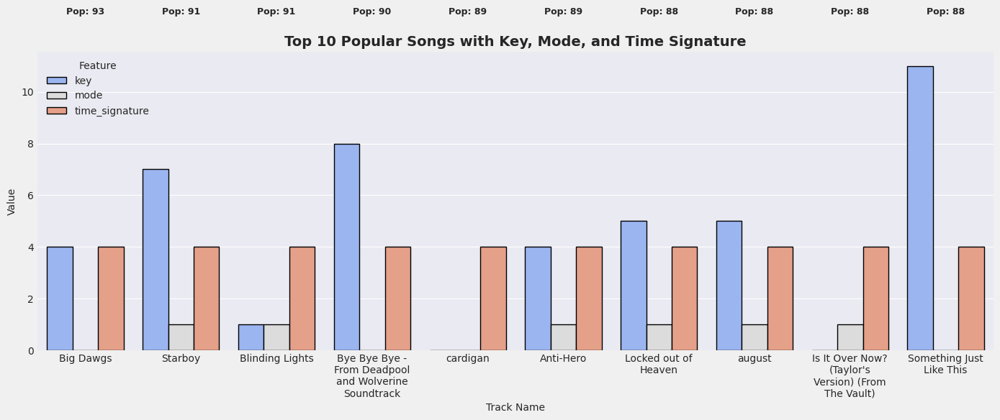

In [379]:
top10 = spotify.sort_values(by="popularity", ascending=False).head(10)

# Wrap long track names
top10["track_name_wrapped"] = top10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=15)))

# Select relevant columns for plotting
features = ["key", "mode", "time_signature"]
top10_melted = top10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.barplot(data=top10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="coolwarm",edgecolor="black")

# Rotate x labels (kept slight tilt for readability)
plt.xticks(rotation=0, ha="center")

# Add popularity annotations
for i, row in top10.iterrows():
    plt.text(x=top10.index.get_loc(i), y=13, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Top 10 Popular Songs with Key, Mode, and Time Signature", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")
plt.legend(title="Feature")
plt.tight_layout()
plt.show()


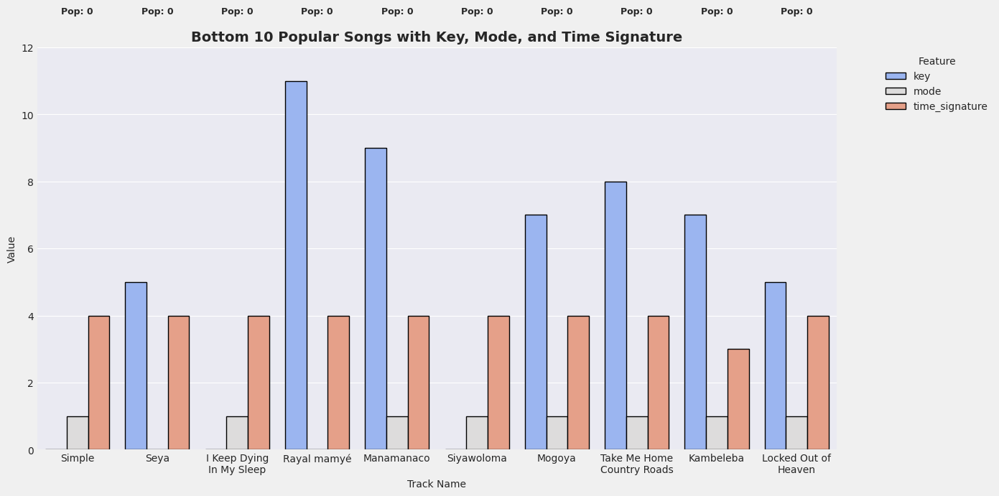

In [382]:
bottom10 = spotify.sort_values(by="popularity", ascending=False).tail(10)

# Wrap long track names
bottom10["track_name_wrapped"] = bottom10["track_name"].apply(lambda x: "\n".join(textwrap.wrap(x, width=13)))

# Select relevant columns for plotting
features = ["key", "mode", "time_signature"]
bottom10_melted = bottom10.melt(id_vars=["track_name_wrapped", "popularity"], value_vars=features,var_name="Feature",value_name="Value")

# Plot grouped bar chart
plt.figure(figsize=(14,7), facecolor="#f0f0f0")
sns.barplot(data=bottom10_melted,x="track_name_wrapped",y="Value",hue="Feature",palette="coolwarm",edgecolor="black")

# Rotate x labels slightly for readability
plt.xticks(rotation=0, ha="center")

# Set y-axis limit higher so bars are visible
plt.ylim(0, 12)

# Add popularity annotations
for i, row in bottom10.iterrows():
    plt.text(x=bottom10.index.get_loc(i), y=13, s=f"Pop: {row['popularity']}", ha="center", fontsize=9, fontweight="bold")

plt.title("Bottom 10 Popular Songs with Key, Mode, and Time Signature", fontsize=14, fontweight="bold")
plt.xlabel("Track Name")
plt.ylabel("Value")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()


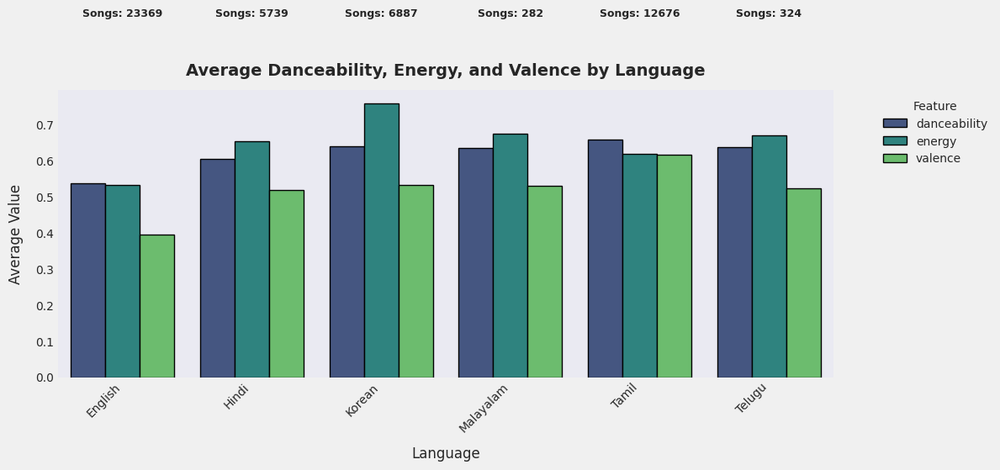

In [385]:
# Group by language and compute averages
avg_features_lang = spotify.groupby("language")[["danceability", "energy", "valence"]].mean()
song_counts = spotify["language"].value_counts()

# Merge song counts
avg_features_lang["song_count"] = song_counts
avg_features_lang = avg_features_lang.reset_index()

# Melt for grouped bar plotting
avg_melted_lang = avg_features_lang.melt(id_vars=["language", "song_count"],value_vars=["danceability", "energy", "valence"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted_lang,x="language",y="Average Value",hue="Feature",palette="viridis",edgecolor="black")

# Add total song count annotations
for i, row in avg_features_lang.iterrows():
    plt.text(x=i,y=1.00,s=f"Songs: {int(row['song_count'])}",ha="center",fontsize=9,fontweight="bold")

plt.title("Average Danceability, Energy, and Valence by Language", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Language", fontsize = 12, labelpad=10)
plt.ylabel("Average Value", fontsize = 12, labelpad =10)
plt.xticks(rotation=45, ha="right")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.grid(False)
plt.show()

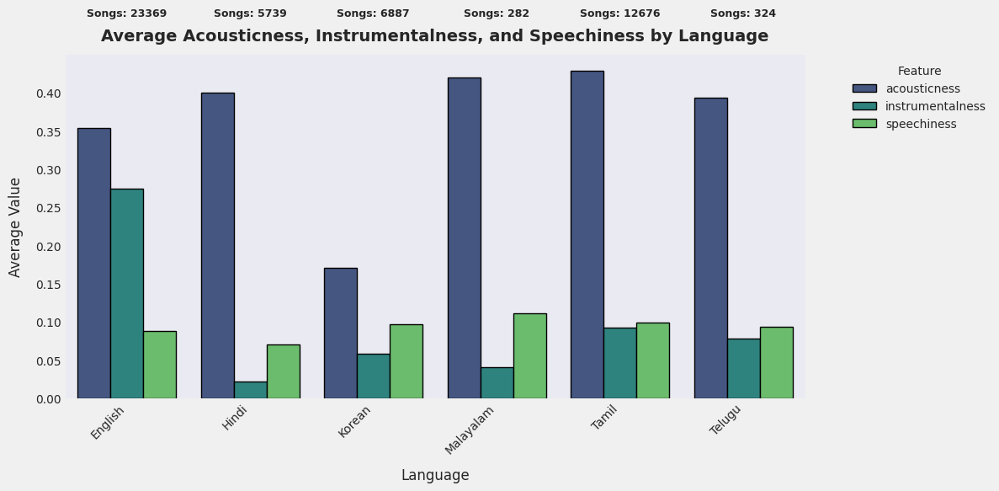

In [388]:
# Group by language and compute averages
avg_features_lang = spotify.groupby("language")[["acousticness", "instrumentalness", "speechiness"]].mean()
song_counts = spotify["language"].value_counts()

# Merge song counts
avg_features_lang["song_count"] = song_counts
avg_features_lang = avg_features_lang.reset_index()

# Melt for grouped bar plotting
avg_melted_lang = avg_features_lang.melt(id_vars=["language", "song_count"],value_vars=["acousticness", "instrumentalness", "speechiness"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted_lang,x="language",y="Average Value",hue="Feature",palette="viridis",edgecolor="black")

# Add total song count annotations
for i, row in avg_features_lang.iterrows():
    plt.text(x=i,y=.5,s=f"Songs: {int(row['song_count'])}",ha="center",fontsize=9,fontweight="bold")

plt.title("Average Acousticness, Instrumentalness, and Speechiness by Language", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Language", fontsize = 12, labelpad=10)
plt.ylabel("Average Value", fontsize = 12, labelpad =10)
plt.xticks(rotation=45, ha="right")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.grid(False)
plt.show()

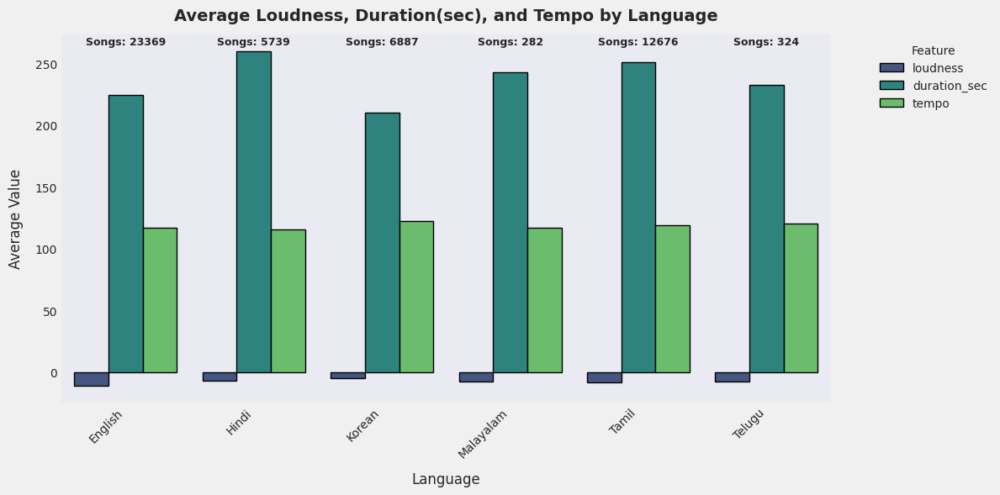

In [391]:
# Group by language and compute averages
avg_features_lang = spotify.groupby("language")[["loudness", "duration_sec", "tempo"]].mean()
song_counts = spotify["language"].value_counts()

# Merge song counts
avg_features_lang["song_count"] = song_counts
avg_features_lang = avg_features_lang.reset_index()

# Melt for grouped bar plotting
avg_melted_lang = avg_features_lang.melt(id_vars=["language", "song_count"],value_vars=["loudness", "duration_sec", "tempo"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted_lang,x="language",y="Average Value",hue="Feature",palette="viridis",edgecolor="black")

# Add total song count annotations
for i, row in avg_features_lang.iterrows():
    plt.text(x=i,y=265,s=f"Songs: {int(row['song_count'])}",ha="center",fontsize=9,fontweight="bold")

plt.title("Average Loudness, Duration(sec), and Tempo by Language", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Language", fontsize = 12, labelpad=10)
plt.ylabel("Average Value", fontsize = 12, labelpad =10)
plt.xticks(rotation=45, ha="right")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.grid(False)
plt.show()

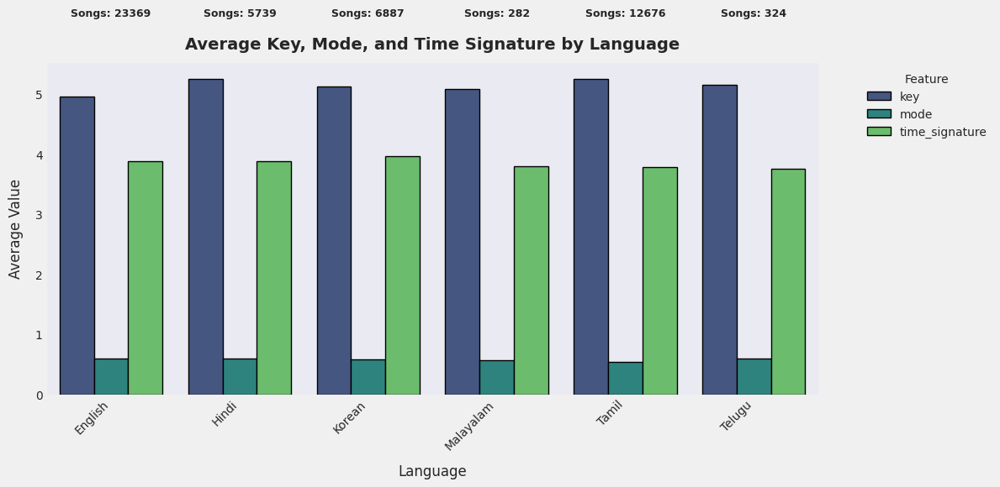

In [394]:
# Group by language and compute averages
avg_features_lang = spotify.groupby("language")[["key", "mode", "time_signature"]].mean()
song_counts = spotify["language"].value_counts()

# Merge song counts
avg_features_lang["song_count"] = song_counts
avg_features_lang = avg_features_lang.reset_index()

# Melt for grouped bar plotting
avg_melted_lang = avg_features_lang.melt(id_vars=["language", "song_count"],value_vars=["key", "mode", "time_signature"],var_name="Feature",value_name="Average Value")

# Plot grouped bar chart
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
sns.barplot(data=avg_melted_lang,x="language",y="Average Value",hue="Feature",palette="viridis",edgecolor="black")

# Add total song count annotations
for i, row in avg_features_lang.iterrows():
    plt.text(x=i,y=6.3,s=f"Songs: {int(row['song_count'])}",ha="center",fontsize=9,fontweight="bold")

plt.title("Average Key, Mode, and Time Signature by Language", fontsize=14, fontweight="bold", pad = 12)
plt.xlabel("Language", fontsize = 12, labelpad=10)
plt.ylabel("Average Value", fontsize = 12, labelpad =10)
plt.xticks(rotation=45, ha="right")

# Move legend to the right side
plt.legend(title="Feature", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.grid(False)
plt.show()

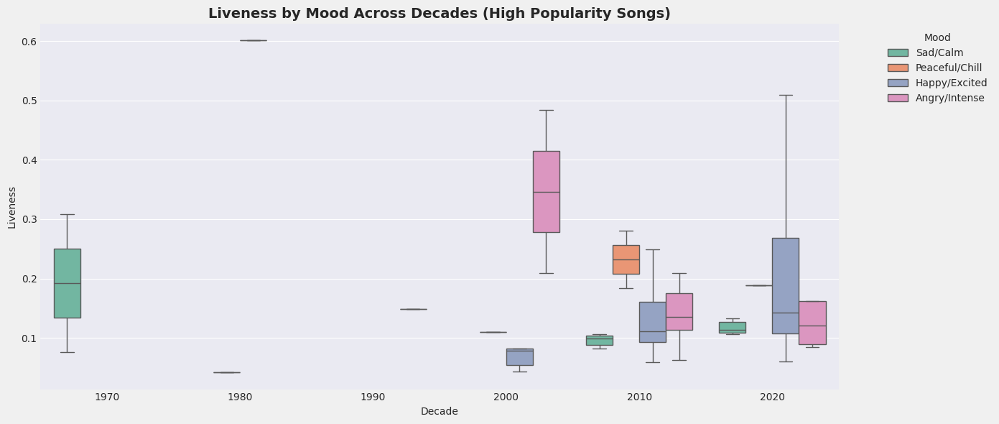

In [397]:
plt.figure(figsize=(14,6), facecolor="#f0f0f0")
sns.boxplot(
    data= spotify[spotify['popularity_segment'] == 'Very High (81-100)'],x="decade",y="liveness",hue="mood",palette="Set2",showfliers=False)
plt.title("Liveness by Mood Across Decades (High Popularity Songs)", fontsize=14, fontweight="bold")
plt.xlabel("Decade")
plt.ylabel("Liveness")
plt.legend(title="Mood", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()


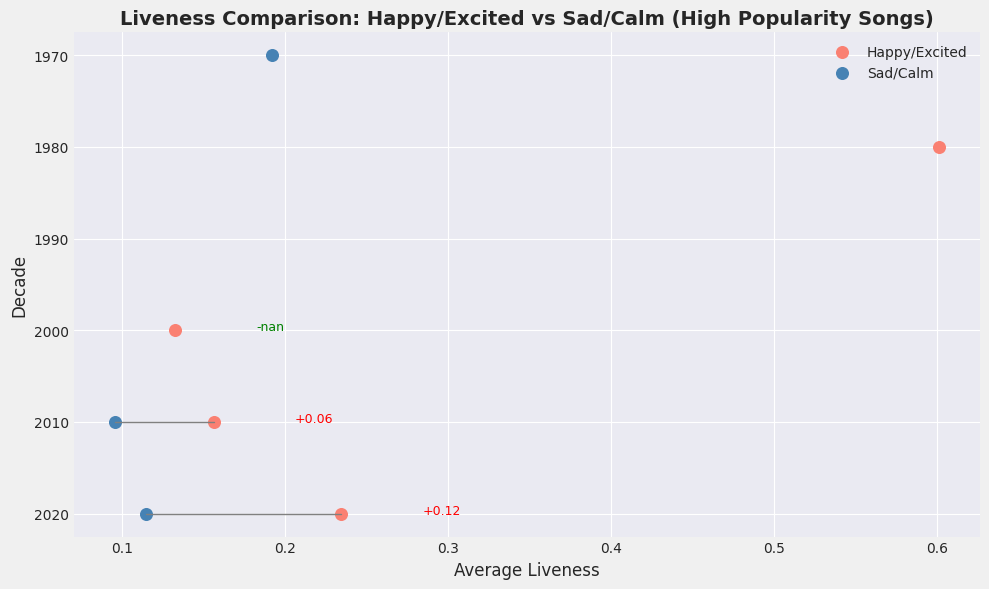

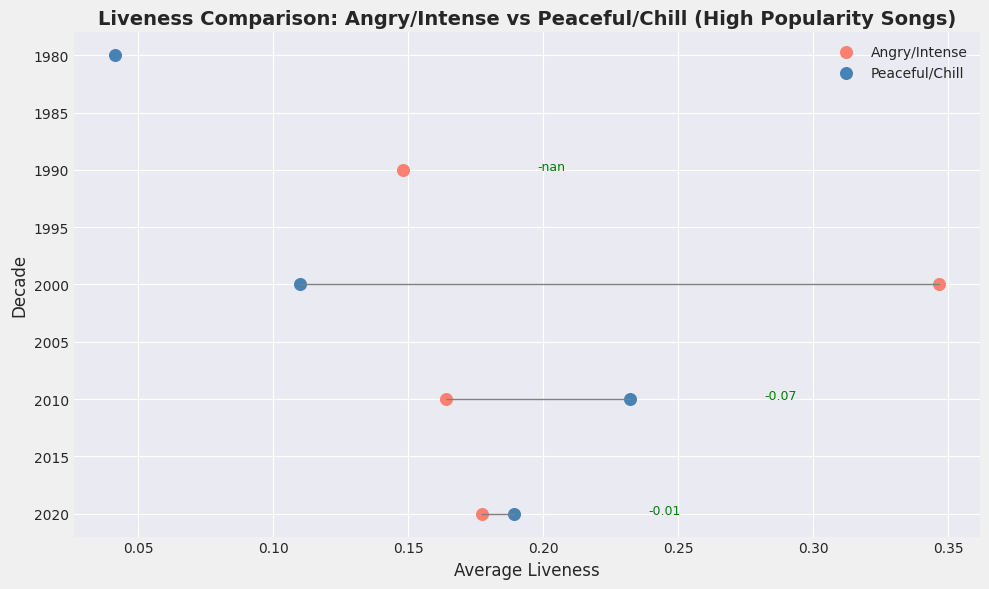

In [400]:
def plot_mood_comparison(spotify, moods, title_suffix):
    # Filter high popularity + selected moods
    subset = spotify[(spotify["popularity_segment"] == "Very High (81-100)") & (spotify["mood"].isin(moods))]

    # Aggregate average liveness
    agg = subset.groupby(["decade", "mood"])["liveness"].mean().reset_index()

    # Pivot into slope plot format
    df = agg.pivot(index="decade", columns="mood", values="liveness").reset_index()
    df["Difference"] = df[moods[0]] - df[moods[1]]

    # --- Plot ---
    fig, ax = plt.subplots(figsize=(10, 6))
    fig.patch.set_facecolor('#f0f0f0')

    # Scatter points
    ax.scatter(df[moods[0]], df["decade"], color="salmon", label=moods[0], s=70)
    ax.scatter(df[moods[1]], df["decade"], color="steelblue", label=moods[1], s=70)

    # Lines connecting moods
    for _, row in df.iterrows():
        ax.plot([row[moods[0]], row[moods[1]]],
                [row["decade"], row["decade"]],
                color="gray", linestyle="-", linewidth=1)

    # Annotate difference
    for _, row in df.iterrows():
        diff = row["Difference"]
        x_pos = max(row[moods[0]], row[moods[1]]) + 0.05
        color = "red" if diff > 0 else "green"
        sign = "+" if diff > 0 else "-"
        ax.annotate(f"{sign}{abs(diff):.2f}", (x_pos, row["decade"]),
                    color=color, fontsize=9)

    # Labels & styling
    ax.set_xlabel("Average Liveness", fontsize=12)
    ax.set_ylabel("Decade", fontsize=12)
    ax.set_title(f"Liveness Comparison: {moods[0]} vs {moods[1]} ({title_suffix})",
                 fontsize=14, fontweight="bold")

    ax.invert_yaxis()
    ax.legend(loc="upper right", frameon=False)

    # Remove spines
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["left"].set_visible(False)

    plt.tight_layout()
    plt.show()


# --- Run for both cases ---
plot_mood_comparison(spotify, ["Happy/Excited", "Sad/Calm"], "High Popularity Songs")
plot_mood_comparison(spotify, ["Angry/Intense", "Peaceful/Chill"], "High Popularity Songs")


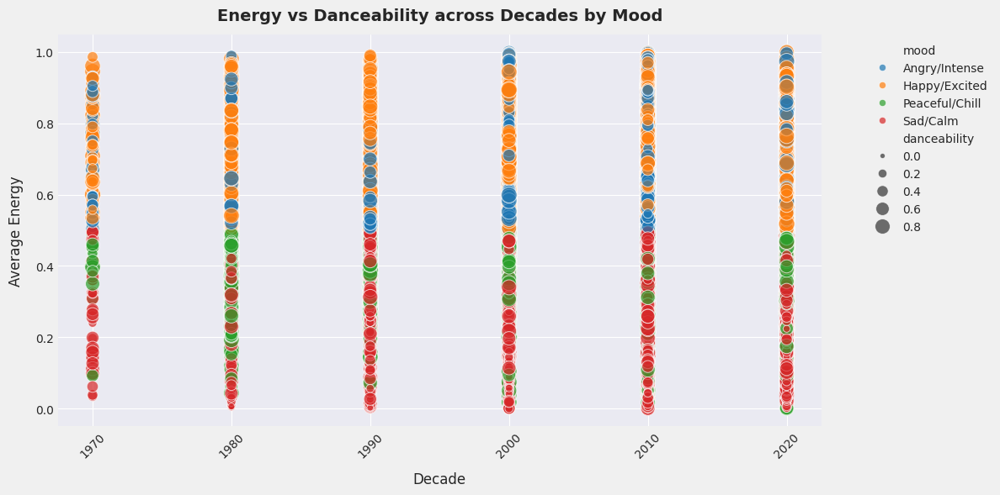

In [403]:
# Energy vs Danceability across Decades by Mood
plt.figure(figsize=(12, 6), facecolor="#f0f0f0")
sns.scatterplot(data=spotify,x="decade",y="energy",hue="mood",size="danceability",sizes=(20, 200),alpha=0.7)
plt.title("Energy vs Danceability across Decades by Mood", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Average Energy", fontsize = 12, labelpad = 10)
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

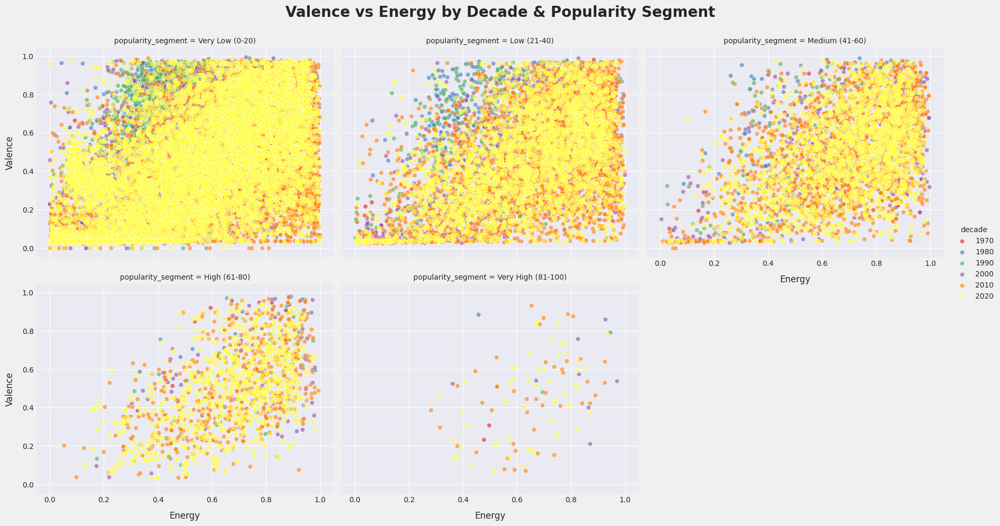

In [406]:
# Valence vs Energy by Decade & Popularity Segment
g = sns.FacetGrid(spotify, col="popularity_segment", hue="decade", height=5, aspect=1.2, palette= "Set1", col_wrap=3)
g.map(sns.scatterplot, "energy", "valence", alpha=0.6)
g.add_legend()
g.set_axis_labels("Energy", "Valence", fontsize = 12, labelpad = 10)
plt.subplots_adjust(top=0.9)
g.fig.suptitle("Valence vs Energy by Decade & Popularity Segment", fontsize=20, weight="bold")
g.fig.patch.set_facecolor("#f0f0f0")
plt.show()


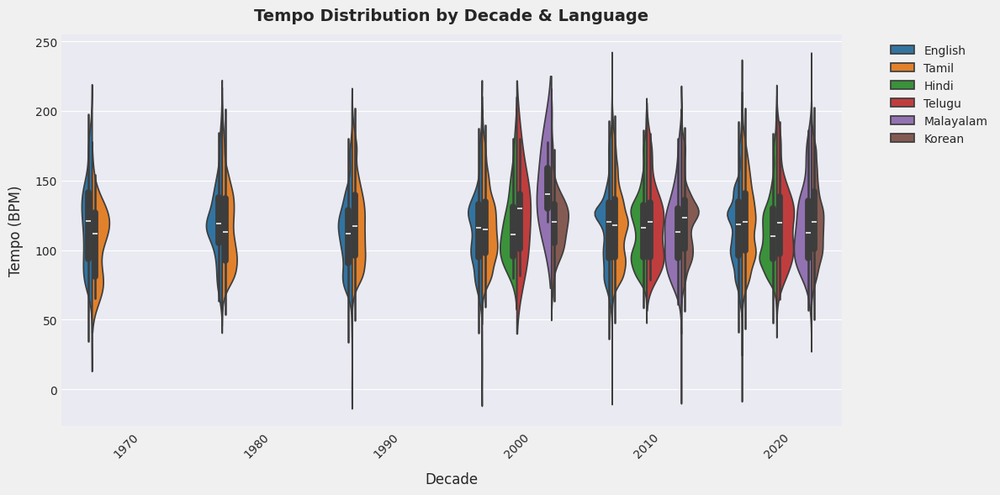

In [409]:
# Tempo Distribution by Decade & Language
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.violinplot(data=spotify,x="decade",y="tempo",hue="language",split=True)
plt.title("Tempo Distribution by Decade & Language", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Tempo (BPM)", fontsize = 12, labelpad =10)
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

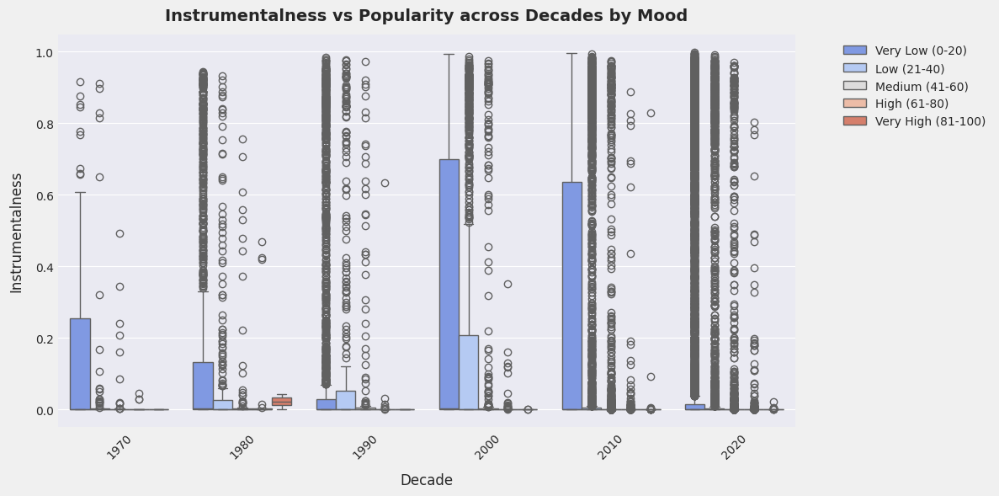

In [412]:
# Instrumentalness vs Popularity across Decades by Mood
plt.figure(figsize=(12, 6), facecolor = ("#f0f0f0"))
sns.boxplot(data=spotify,x="decade",y="instrumentalness",hue="popularity_segment", palette = "coolwarm")
plt.title("Instrumentalness vs Popularity across Decades by Mood", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Decade", fontsize = 12, labelpad = 10)
plt.ylabel("Instrumentalness", fontsize = 12, labelpad = 10)
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

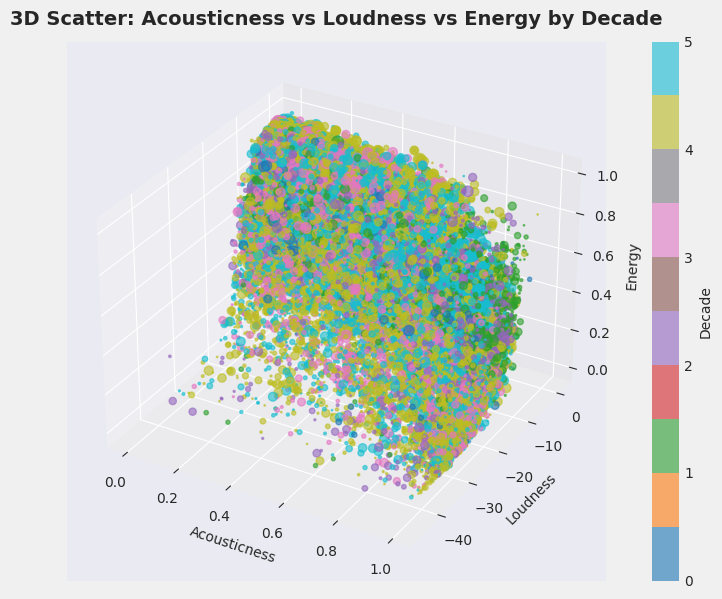

In [415]:
# 3D Scatter Acousticness vs Loudness vs Energy by Decade
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(12, 7), facecolor  =("#f0f0f0"))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(spotify['acousticness'],spotify['loudness'],spotify['energy'],c=spotify['decade'].astype('category').cat.codes,s=spotify['popularity'],alpha=0.6,cmap="tab10")
ax.set_xlabel("Acousticness")
ax.set_ylabel("Loudness")
ax.set_zlabel("Energy")
plt.title("3D Scatter: Acousticness vs Loudness vs Energy by Decade", fontsize=14, weight="bold", pad = 12)
plt.colorbar(sc, label="Decade")
plt.show()

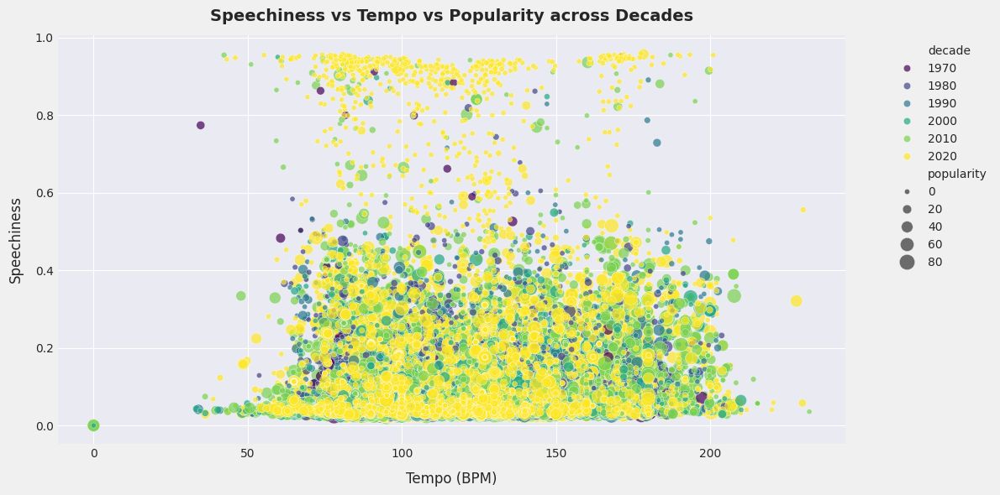

In [418]:
# Speechiness vs Tempo vs Popularity across Decades
plt.figure(figsize=(12, 6), facecolor = ("#f0f0f0"))
sns.scatterplot(data=spotify,x="tempo",y="speechiness",hue="decade",size="popularity",sizes=(20, 200),alpha=0.7, palette = "viridis")
plt.title("Speechiness vs Tempo vs Popularity across Decades", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Tempo (BPM)", fontsize = 12, labelpad = 10)
plt.ylabel("Speechiness", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

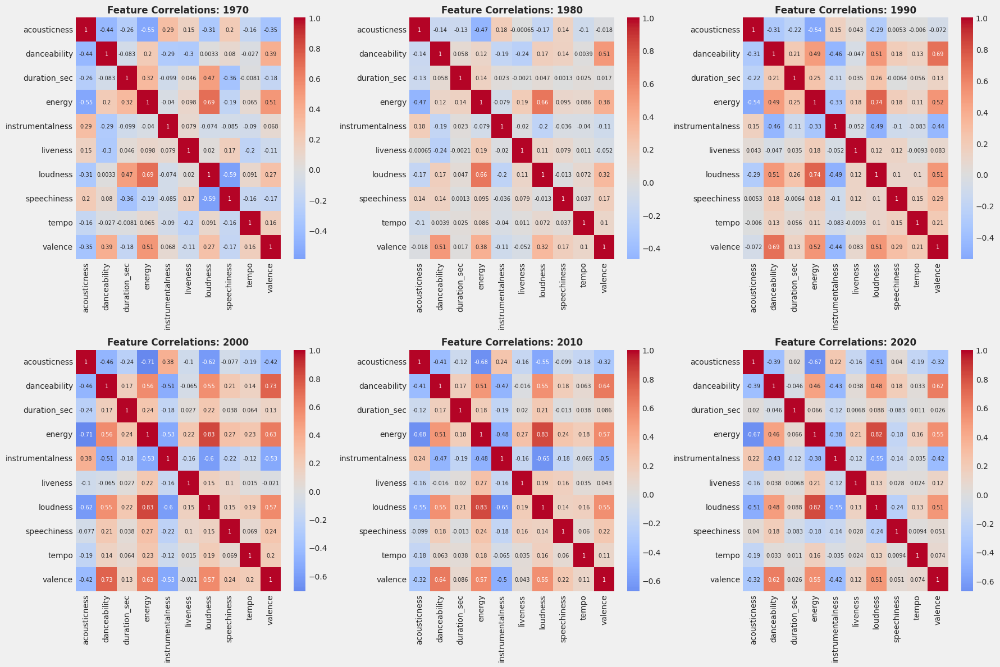

In [421]:
# Heatmap of Feature Correlations per Decade

# Features to correlate
features = ["acousticness", "danceability", "duration_sec", "energy",
            "instrumentalness", "liveness", "loudness", "speechiness",
            "tempo", "valence"]

# Example: take the first 6 decades (or unique subsets)
decades = sorted(spotify['decade'].unique())[:6]

# Create 2x3 grid
fig, axes = plt.subplots(2, 3, figsize=(18, 12), facecolor="#f0f0f0")
axes = axes.flatten()

# Loop through each decade and plot correlation heatmap
for ax, decade in zip(axes, decades):
    subset = spotify[spotify['decade'] == decade]
    corr = subset[features].corr()
    sns.heatmap(corr, annot=True, cmap="coolwarm", center=0, ax=ax, annot_kws={"size": 7})
    ax.set_title(f"Feature Correlations: {decade}", fontsize=12, weight="bold")

# Remove any unused axes
for i in range(len(decades), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

<Figure size 1200x700 with 0 Axes>

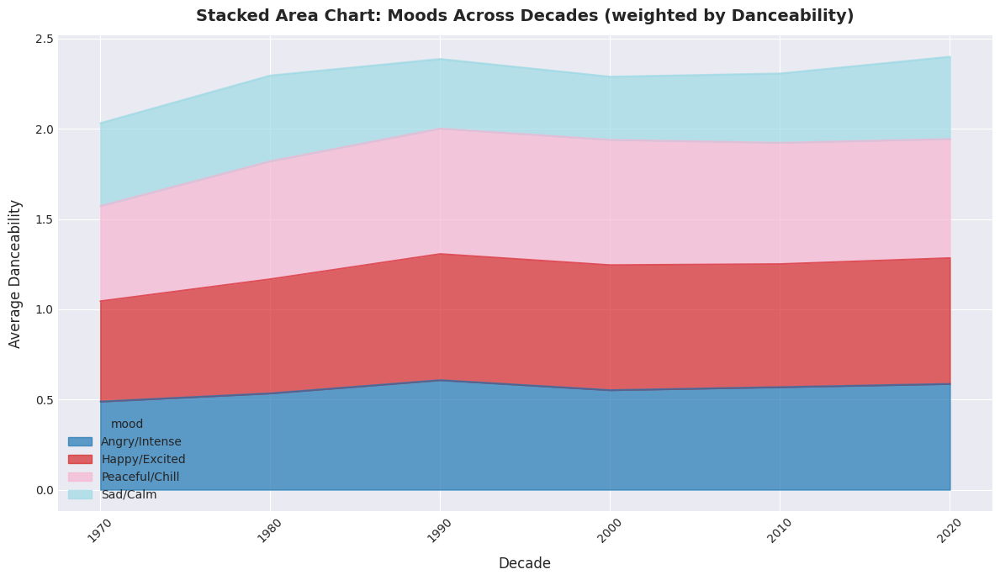

In [424]:
# Stacked Area Chart of Moods Across Decades (weighted by Danceability)
mood_trends = spotify.groupby(["decade", "mood"]).danceability.mean().reset_index()
mood_pivot = mood_trends.pivot(index="decade", columns="mood", values="danceability").fillna(0)

plt.figure(figsize=(12, 7), facecolor = ("#f0f0f0"))
mood_pivot.plot(kind='area', alpha=0.7, figsize=(12,7), cmap="tab20")
plt.title("Stacked Area Chart: Moods Across Decades (weighted by Danceability)", fontsize=14, weight="bold", pad = 12)
plt.xlabel("Decade", labelpad = 10, fontsize = 12)
plt.ylabel("Average Danceability", labelpad = 10, fontsize = 12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

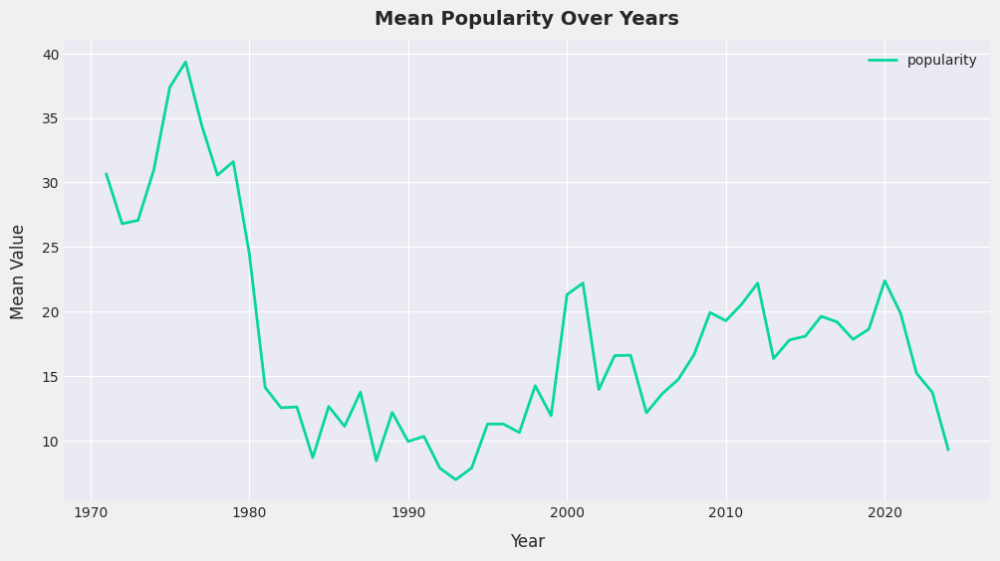

In [427]:
# Aggregate mean values by year
features = ['popularity']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'popularity': '#06D6A0'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Mean Popularity Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


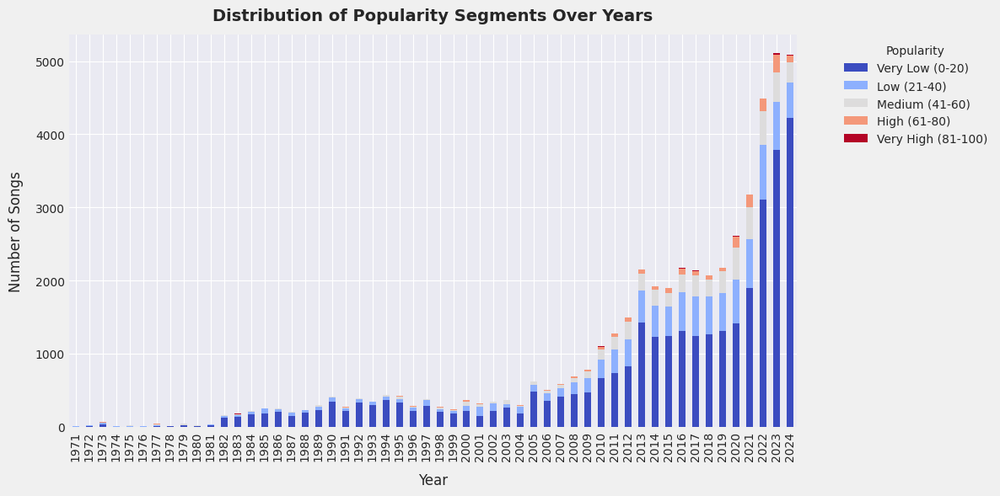

In [430]:
spotify['year_only'] = spotify['year'].dt.year
spotify_counts = spotify.groupby(['year_only', 'popularity_segment']).size().unstack(fill_value=0)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12,6))
fig.patch.set_facecolor('#f0f0f0')
spotify_counts.plot(kind='bar',  stacked=True, colormap='coolwarm', ax=ax)
plt.title('Distribution of Popularity Segments Over Years', fontsize = 14, fontweight = 'bold', pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Number of Songs', labelpad = 10, fontsize = 12)
plt.legend(title='Popularity', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

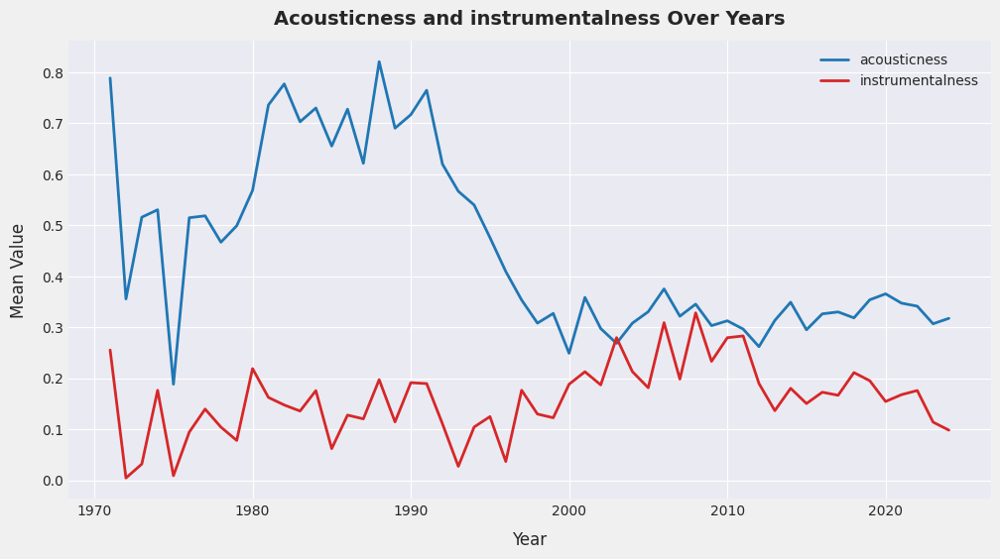

In [433]:
# Aggregate mean values by year
features = ['acousticness', 'instrumentalness']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'acousticness': '#1f77b4', 'instrumentalness': '#d62728'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Acousticness and instrumentalness Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


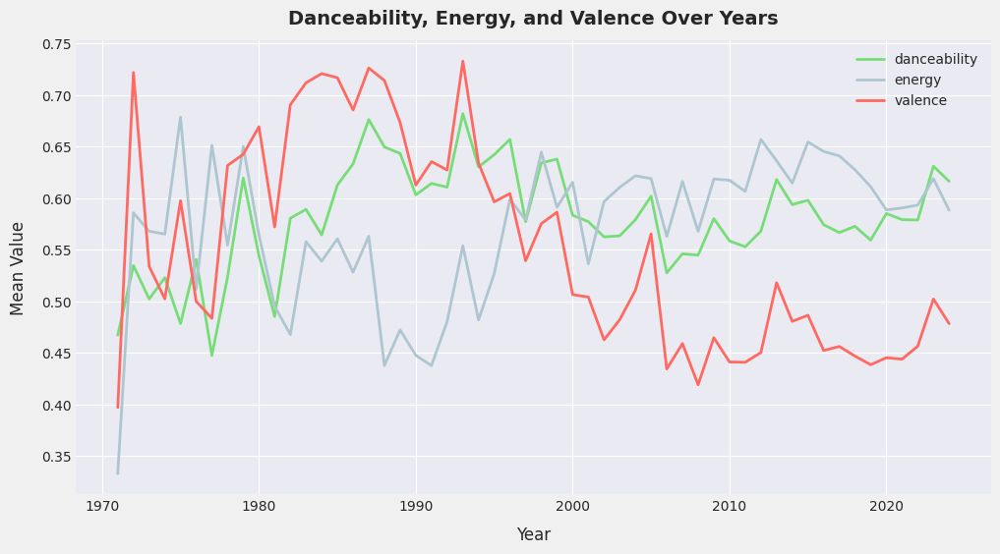

In [436]:
# Aggregate mean values by year
features = ['danceability', 'energy', 'valence']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'danceability': '#77DD77', 'energy': '#AEC6CF', 'valence': '#FF6961'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Danceability, Energy, and Valence Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


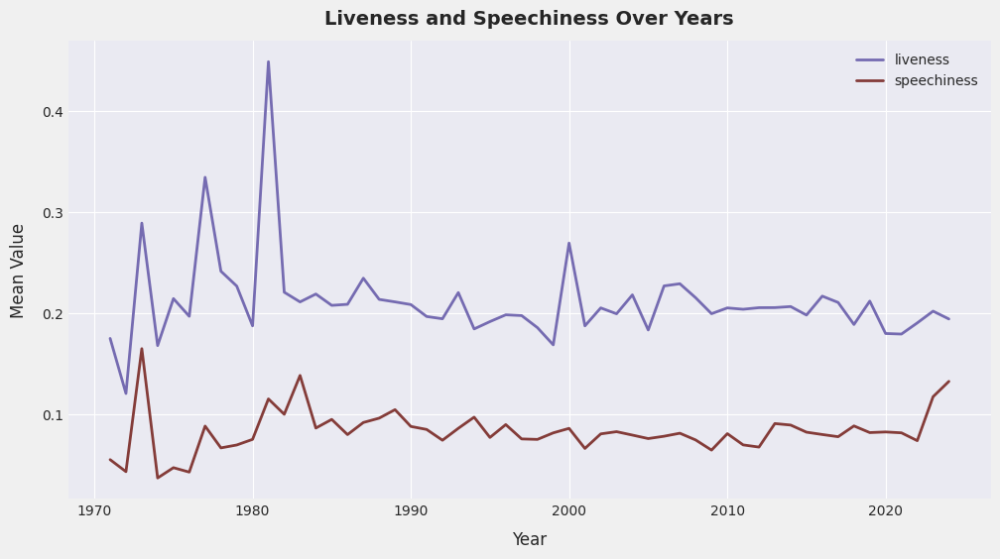

In [439]:
# Aggregate mean values by year
features = ['liveness', 'speechiness']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'liveness': '#756bb1', 'speechiness': '#843c39'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Liveness and Speechiness Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


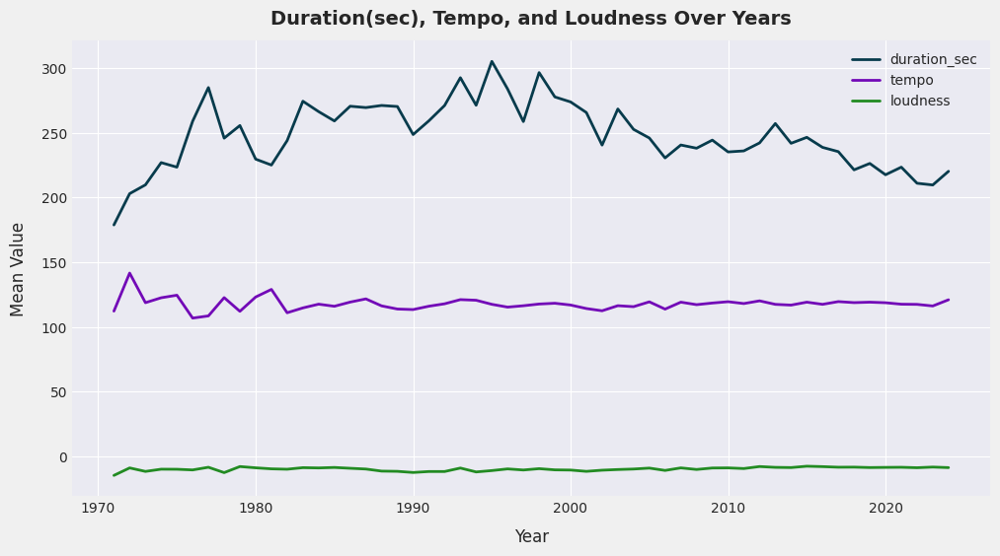

In [442]:
# Aggregate mean values by year
features = ['duration_sec', 'tempo', 'loudness']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'duration_sec': '#073B4C', 'tempo': '#7209b7', 'loudness': '#228b22'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Duration(sec), Tempo, and Loudness Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()


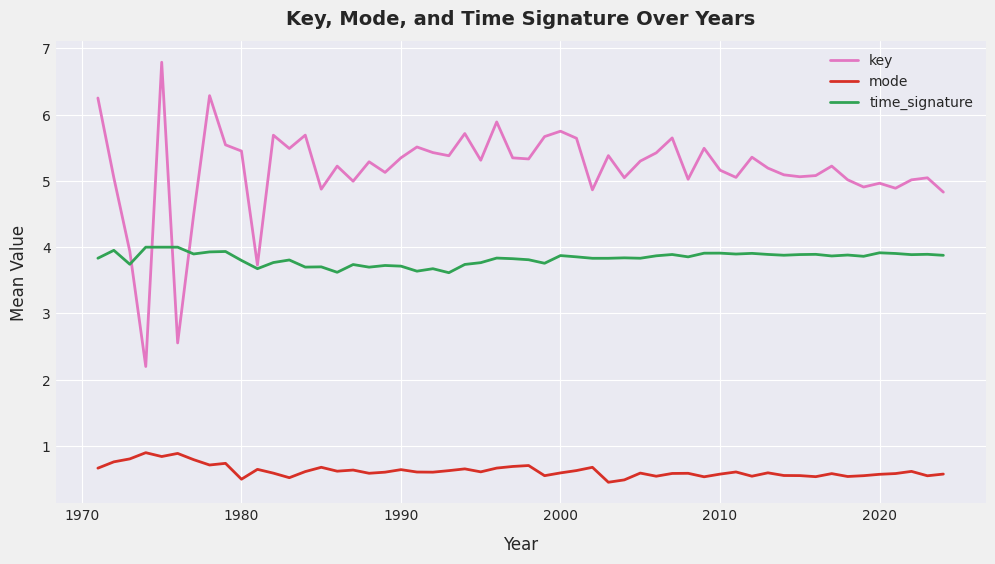

In [445]:
# Aggregate mean values by year
features = ['key', 'mode', 'time_signature']
spotify_mean = spotify.groupby('year')[features].mean().reset_index()

# Set custom colors
colors = {'key': '#e377c2', 'mode': '#d73027', 'time_signature': '#31a354'}

# Plot
plt.figure(figsize=(12,6), facecolor=("#f0f0f0"))
for feature in features:
    plt.plot(spotify_mean['year'], spotify_mean[feature], label=feature, color=colors[feature], linewidth=2)

plt.title('Key, Mode, and Time Signature Over Years', fontweight = 'bold', fontsize = 14, pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Mean Value', labelpad = 10, fontsize = 12)
plt.legend()
plt.grid(True)
plt.show()

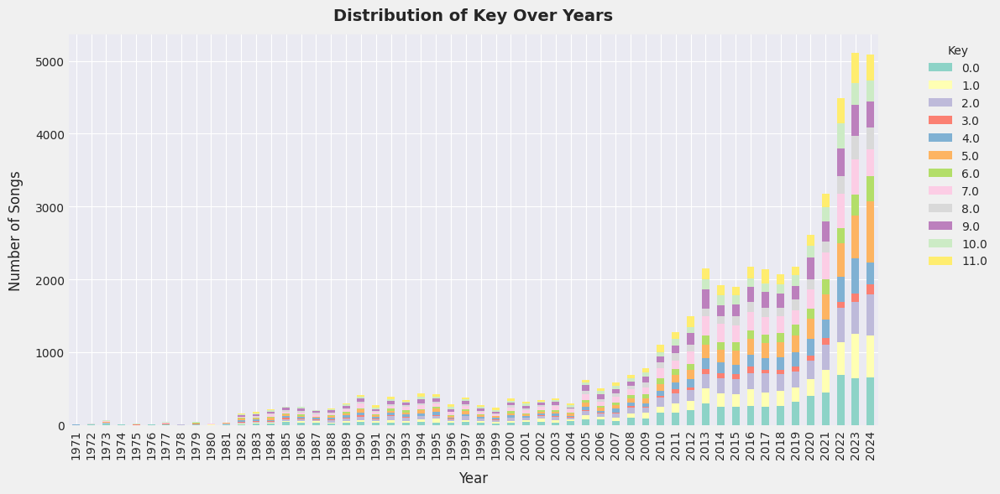

In [448]:
spotify['year_only'] = spotify['year'].dt.year
spotify_counts = spotify.groupby(['year_only', 'key']).size().unstack(fill_value=0)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12,6))
fig.patch.set_facecolor('#f0f0f0')
spotify_counts.plot(kind='bar',  stacked=True, colormap='Set3', ax=ax)
plt.title('Distribution of Key Over Years', fontsize = 14, fontweight = 'bold', pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Number of Songs', labelpad = 10, fontsize = 12)
plt.legend(title='Key', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

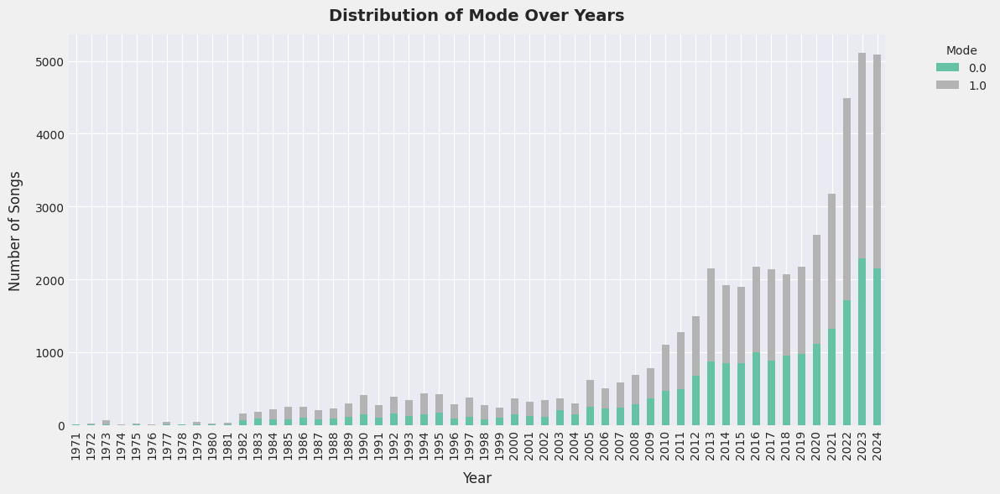

In [451]:
spotify['year_only'] = spotify['year'].dt.year
spotify_counts = spotify.groupby(['year_only', 'mode']).size().unstack(fill_value=0)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12,6))
fig.patch.set_facecolor('#f0f0f0')
spotify_counts.plot(kind='bar',  stacked=True, colormap='Set2', ax=ax)
plt.title('Distribution of Mode Over Years', fontsize = 14, fontweight = 'bold', pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Number of Songs', labelpad = 10, fontsize = 12)
plt.legend(title='Mode', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

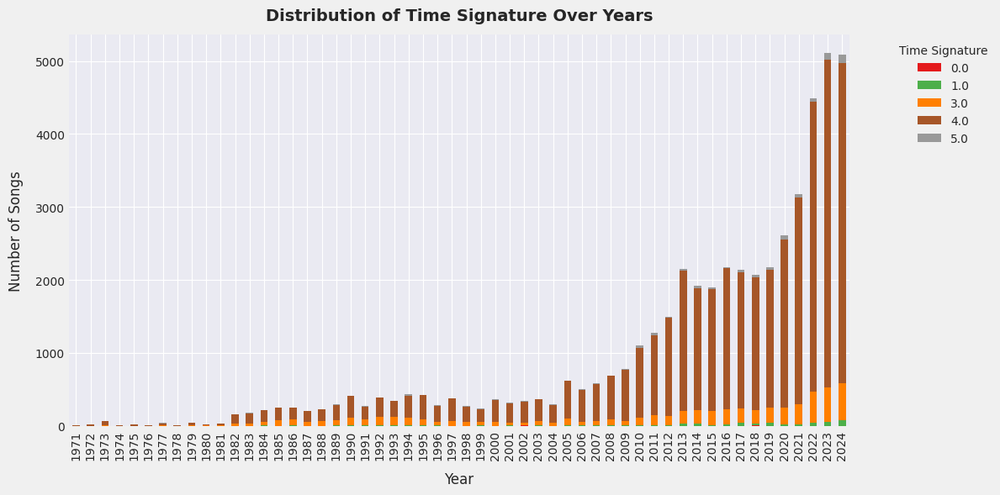

In [454]:
spotify['year_only'] = spotify['year'].dt.year
spotify_counts = spotify.groupby(['year_only', 'time_signature']).size().unstack(fill_value=0)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(12,6))
fig.patch.set_facecolor('#f0f0f0')
spotify_counts.plot(kind='bar',  stacked=True, colormap='Set1', ax=ax)
plt.title('Distribution of Time Signature Over Years', fontsize = 14, fontweight = 'bold', pad = 12)
plt.xlabel('Year', labelpad = 10, fontsize = 12)
plt.ylabel('Number of Songs', labelpad = 10, fontsize = 12)
plt.legend(title='Time Signature', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

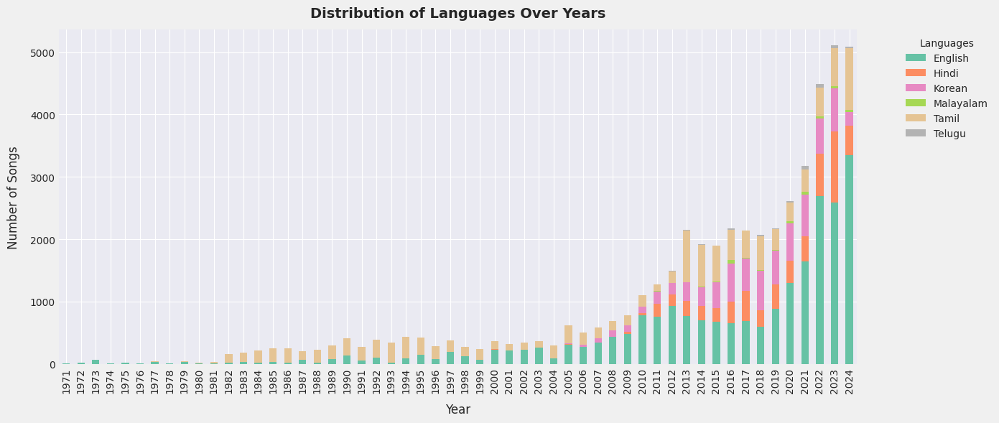

In [457]:
spotify['year_only'] = spotify['year'].dt.year

# Count number of songs per language each year
language_counts = (spotify.groupby(['year_only', 'language']).size().unstack(fill_value=0))

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(14,6), facecolor = ("#f0f0f0"))
language_counts.plot(kind='bar', stacked=True, ax=ax, colormap='Set2')

# Titles and labels
plt.title('Distribution of Languages Over Years', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Number of Songs', fontsize=12, labelpad=10)

# Legend outside the plot
plt.legend(title='Languages', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

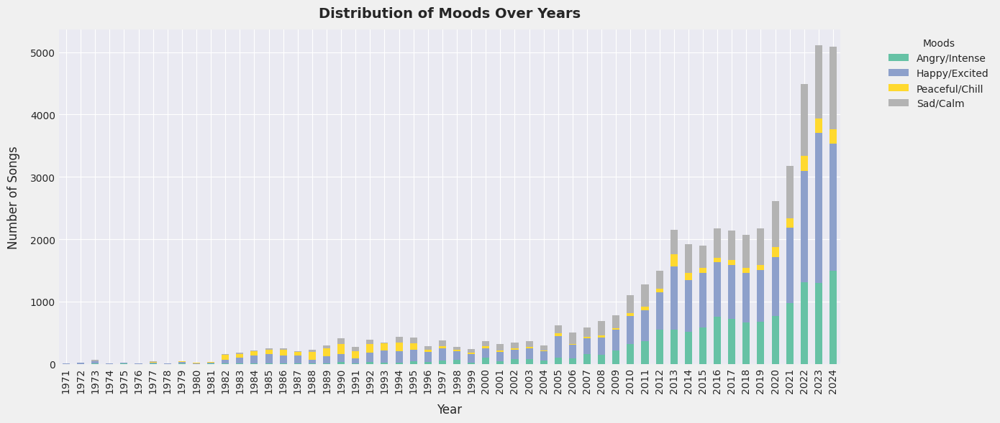

In [460]:
spotify['year_only'] = spotify['year'].dt.year

# Count number of songs per mood each year
mood_counts = (spotify.groupby(['year_only', 'mood']).size().unstack(fill_value=0))

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(14,6), facecolor = ("#f0f0f0"))
mood_counts.plot(kind='bar', stacked=True, ax=ax, colormap='Set2')

# Titles and labels
plt.title('Distribution of Moods Over Years', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Number of Songs', fontsize=12, labelpad=10)

# Legend outside the plot
plt.legend(title='Moods', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

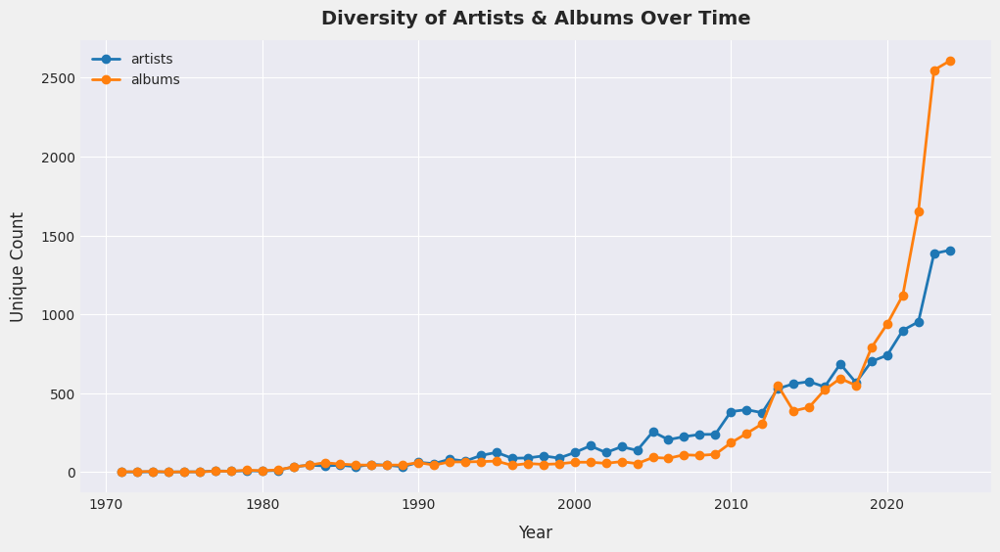

In [463]:
spotify['year_only'] = spotify['year'].dt.year
spotify_artists['year_only'] = spotify_artists['year'].dt.year

# Unique counts per year
diversity = pd.DataFrame({'artists': spotify_artists.groupby('year_only')['artist_name'].nunique(),'albums': spotify.groupby('year_only')['album_name'].nunique(),}).reset_index()

# Plot diversity over time
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
for col in ['artists', 'albums']:
    plt.plot(diversity['year_only'], diversity[col], marker='o', linewidth=2, label=col)

plt.title('Diversity of Artists & Albums Over Time', fontsize=14, fontweight='bold', pad = 12)
plt.xlabel('Year', fontsize=12, labelpad = 10)
plt.ylabel('Unique Count', fontsize=12, labelpad = 10)
plt.legend()
plt.grid(True)
plt.show()


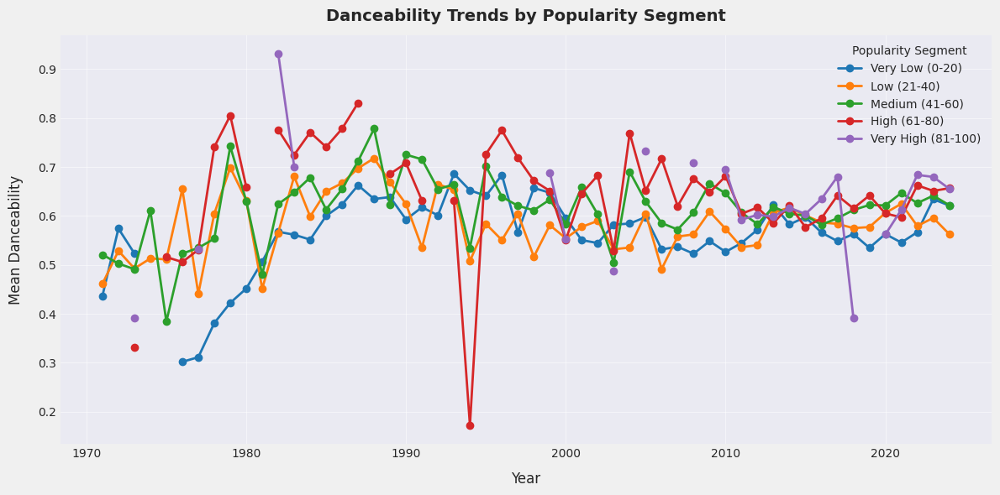

In [466]:
# Aggregate mean danceability by year and popularity segment
danceability_trend = (spotify.groupby(['year_only', 'popularity_segment'])['danceability'].mean().reset_index())

# Plot
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
for segment in danceability_trend['popularity_segment'].unique():
    data = danceability_trend[danceability_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['danceability'], marker='o', linewidth=2, label=segment)

plt.title('Danceability Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12,labelpad = 10)
plt.ylabel('Mean Danceability', fontsize=12, labelpad = 12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()


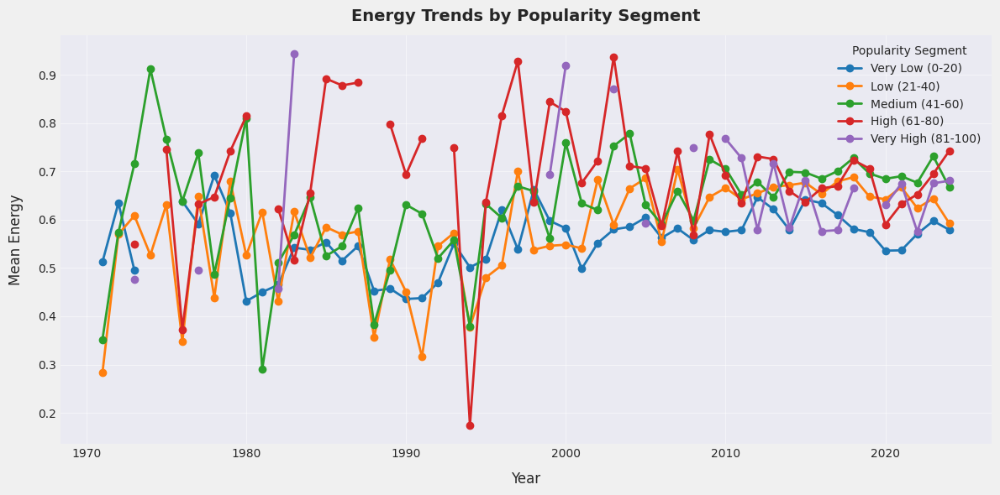

In [469]:
# Aggregate mean energy by year and popularity segment
energy_trend = (spotify.groupby(['year_only', 'popularity_segment'])['energy'].mean().reset_index())

# Plot
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
for segment in energy_trend['popularity_segment'].unique():
    data = energy_trend[energy_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['energy'], marker='o', linewidth=2, label=segment)

plt.title('Energy Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12,labelpad = 10)
plt.ylabel('Mean Energy', fontsize=12, labelpad = 12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()


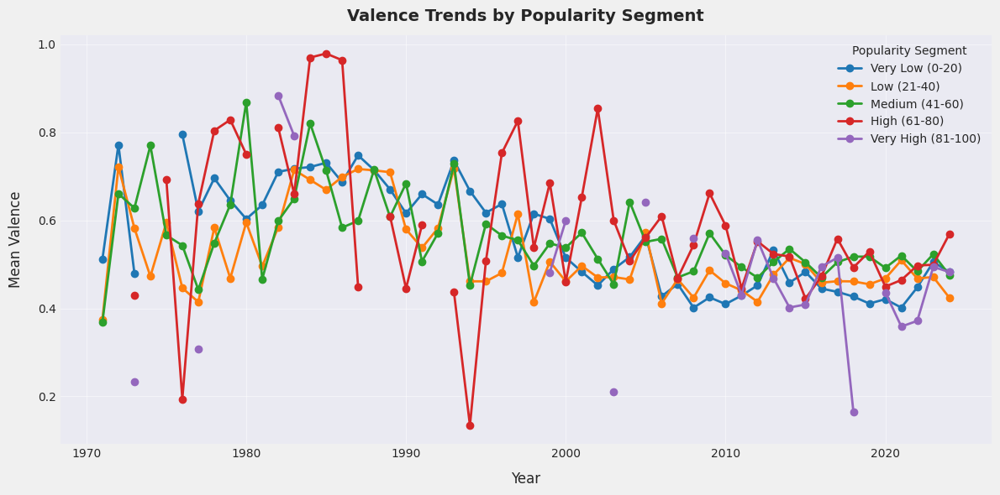

In [472]:
# Aggregate mean valence by year and popularity segment
valence_trend = (spotify.groupby(['year_only', 'popularity_segment'])['valence'].mean().reset_index())

# Plot
plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
for segment in valence_trend['popularity_segment'].unique():
    data = valence_trend[valence_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['valence'], marker='o', linewidth=2, label=segment)

plt.title('Valence Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12,labelpad = 10)
plt.ylabel('Mean Valence', fontsize=12, labelpad = 12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()


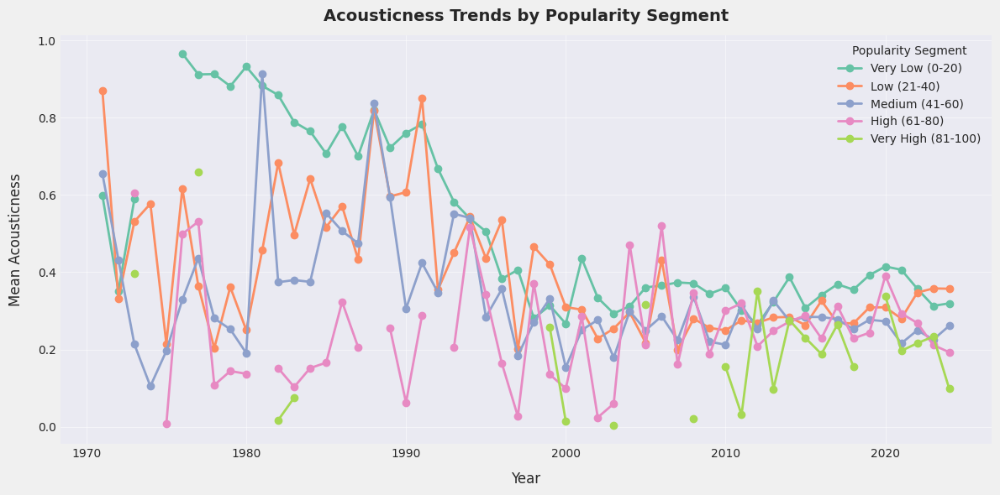

In [475]:
acousticness_trend = (spotify.groupby(['year_only', 'popularity_segment'])['acousticness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=acousticness_trend['popularity_segment'].nunique())

# Map each segment to a color from the palette
segments = acousticness_trend['popularity_segment'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = acousticness_trend[acousticness_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['acousticness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Acousticness Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Acousticness', fontsize=12, labelpad=12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

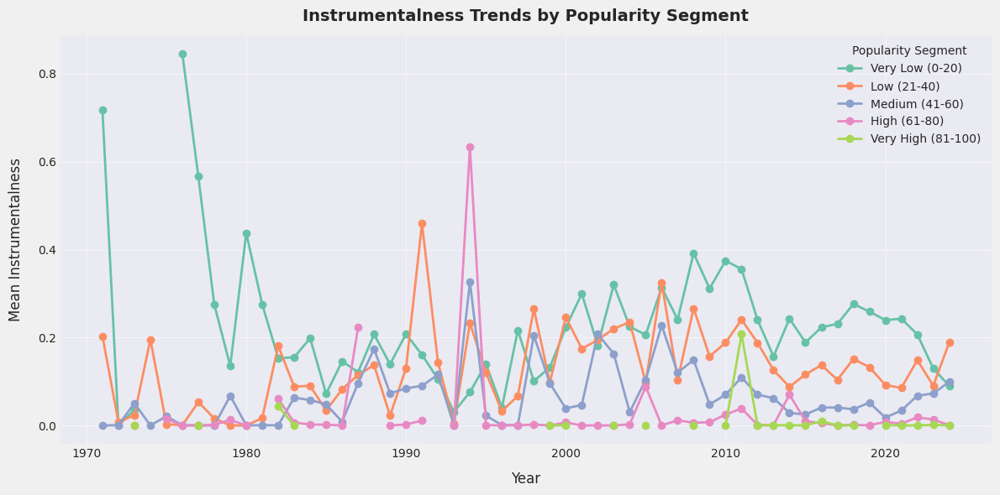

In [478]:
instrumentalness_trend = (spotify.groupby(['year_only', 'popularity_segment'])['instrumentalness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=instrumentalness_trend['popularity_segment'].nunique())

# Map each segment to a color from the palette
segments = instrumentalness_trend['popularity_segment'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = instrumentalness_trend[instrumentalness_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['instrumentalness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Instrumentalness Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Instrumentalness', fontsize=12, labelpad=12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

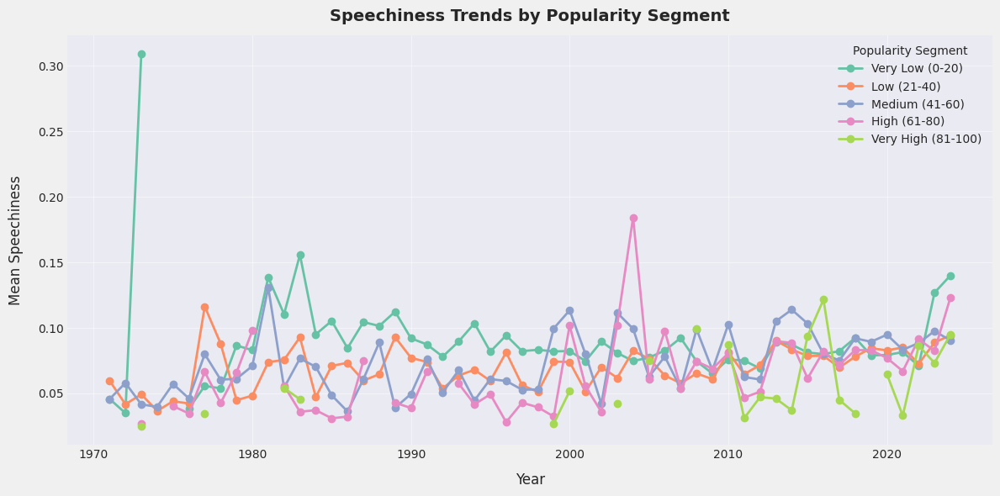

In [481]:
speechiness_trend = (spotify.groupby(['year_only', 'popularity_segment'])['speechiness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=speechiness_trend['popularity_segment'].nunique())

# Map each segment to a color from the palette
segments = speechiness_trend['popularity_segment'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = speechiness_trend[speechiness_trend['popularity_segment'] == segment]
    plt.plot(data['year_only'], data['speechiness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Speechiness Trends by Popularity Segment', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Speechiness', fontsize=12, labelpad=12)
plt.legend(title='Popularity Segment')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

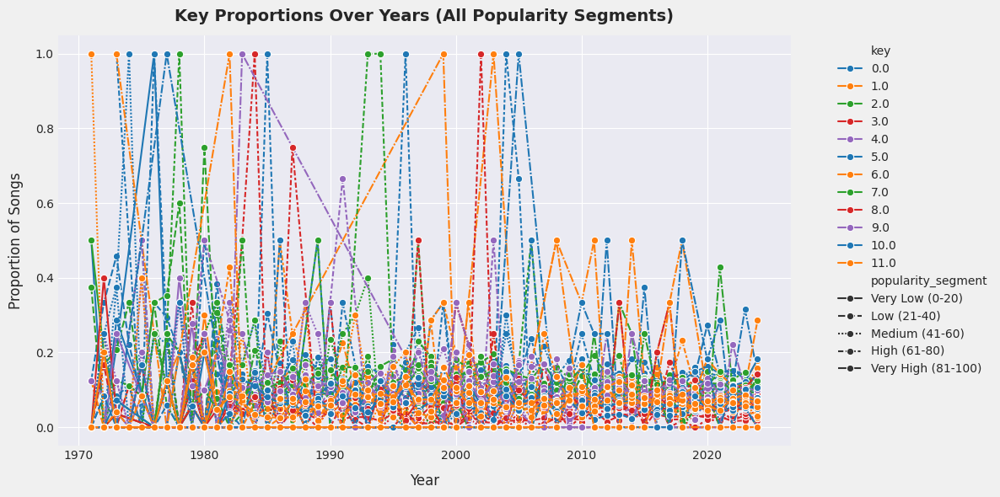

In [484]:
# Count songs per year, popularity_segment, and key
key_counts = (spotify.groupby(['year_only', 'popularity_segment', 'key']).size().reset_index(name='count'))
# Normalize counts within each year/popularity_segment
key_counts['proportion'] = key_counts.groupby(['year_only','popularity_segment'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=key_counts,x="year_only", y="proportion",hue="key", style="popularity_segment", marker="o",palette=colors)
plt.title("Key Proportions Over Years (All Popularity Segments)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

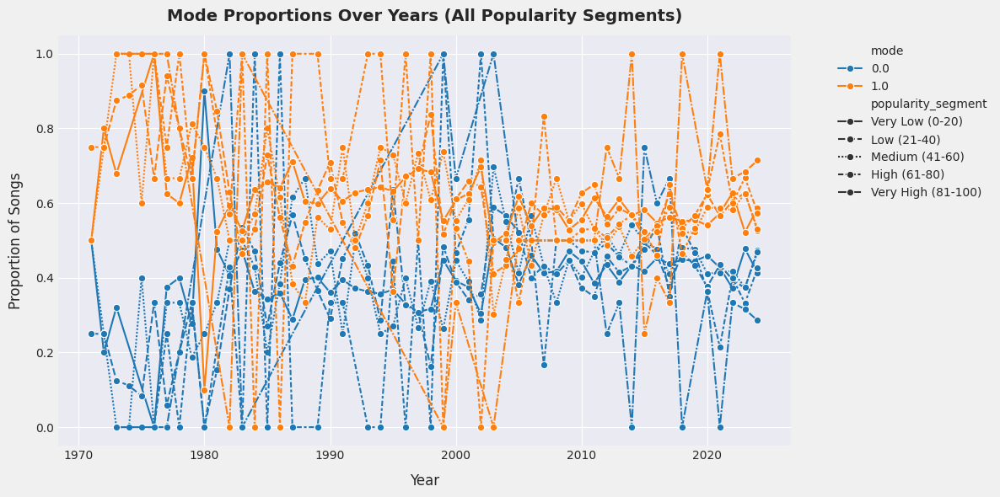

In [487]:
# Count songs per year, popularity_segment, and mode
mode_counts = (spotify.groupby(['year_only', 'popularity_segment', 'mode']).size().reset_index(name='count'))
# Normalize counts within each year/popularity_segment
mode_counts['proportion'] = mode_counts.groupby(['year_only','popularity_segment'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=mode_counts,x="year_only", y="proportion",hue="mode", style="popularity_segment", marker="o",palette=colors)
plt.title("Mode Proportions Over Years (All Popularity Segments)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

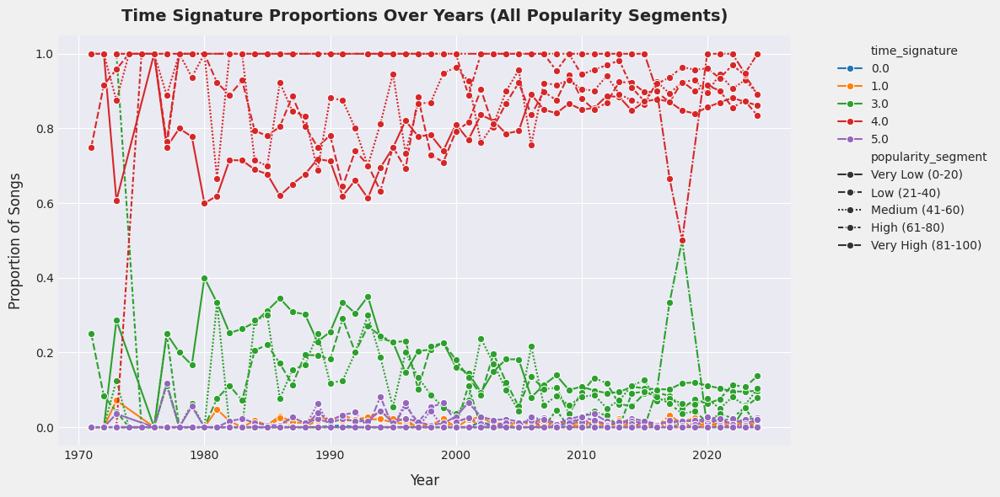

In [490]:
# Count songs per year, popularity_segment, and time_signature
time_signature_counts = (spotify.groupby(['year_only', 'popularity_segment', 'time_signature']).size().reset_index(name='count'))
# Normalize counts within each year/popularity_segment
time_signature_counts['proportion'] = time_signature_counts.groupby(['year_only','popularity_segment'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=time_signature_counts,x="year_only", y="proportion",hue="time_signature", style="popularity_segment", marker="o",palette=colors)
plt.title("Time Signature Proportions Over Years (All Popularity Segments)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

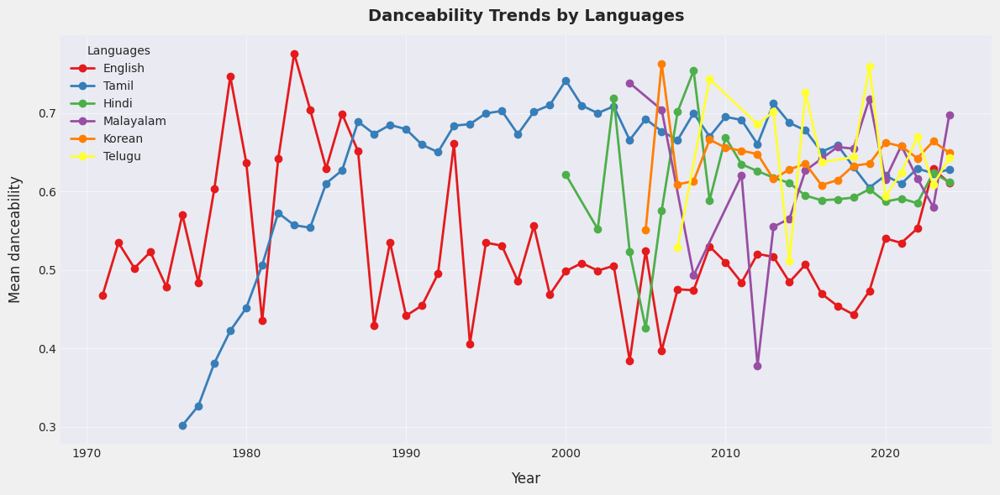

In [493]:
danceability_trend = (spotify.groupby(['year_only', 'language'])['danceability'].mean().reset_index())
palette = sns.color_palette("Set1", n_colors=danceability_trend['language'].nunique())

# Map each segment to a color from the palette
segments = danceability_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = danceability_trend[danceability_trend['language'] == segment]
    plt.plot(data['year_only'], data['danceability'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Danceability Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean danceability', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

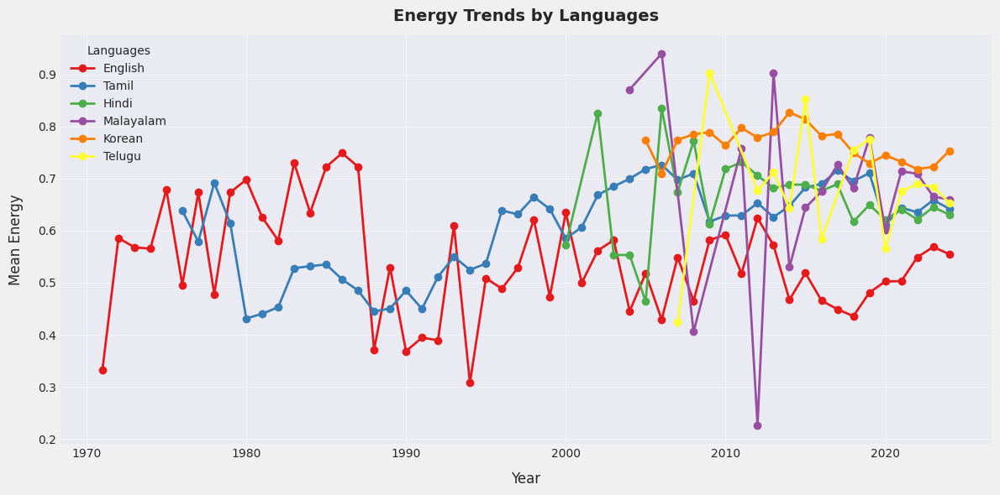

In [496]:
energy_trend = (spotify.groupby(['year_only', 'language'])['energy'].mean().reset_index())
palette = sns.color_palette("Set1", n_colors=energy_trend['language'].nunique())

# Map each segment to a color from the palette
segments = energy_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = energy_trend[energy_trend['language'] == segment]
    plt.plot(data['year_only'], data['energy'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Energy Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Energy', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

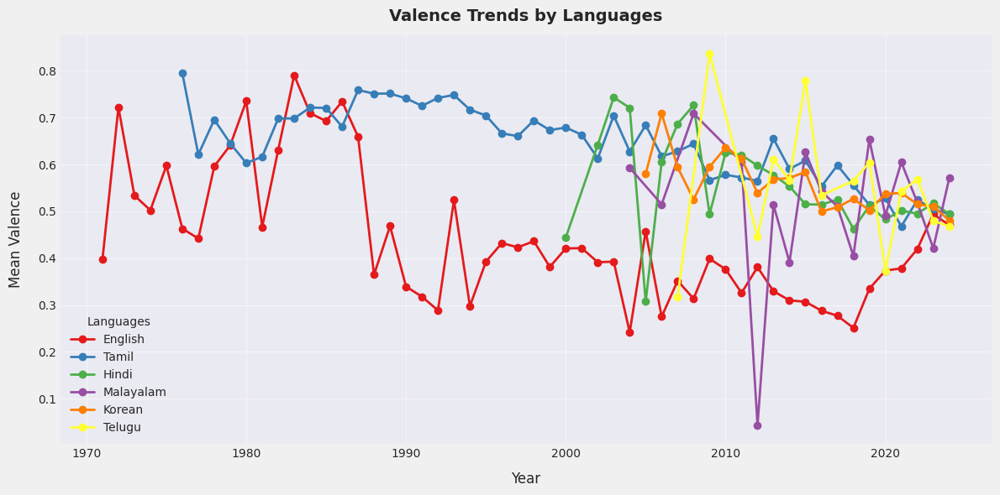

In [499]:
valence_trend = (spotify.groupby(['year_only', 'language'])['valence'].mean().reset_index())
palette = sns.color_palette("Set1", n_colors=valence_trend['language'].nunique())

# Map each segment to a color from the palette
segments = valence_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = valence_trend[valence_trend['language'] == segment]
    plt.plot(data['year_only'], data['valence'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Valence Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Valence', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

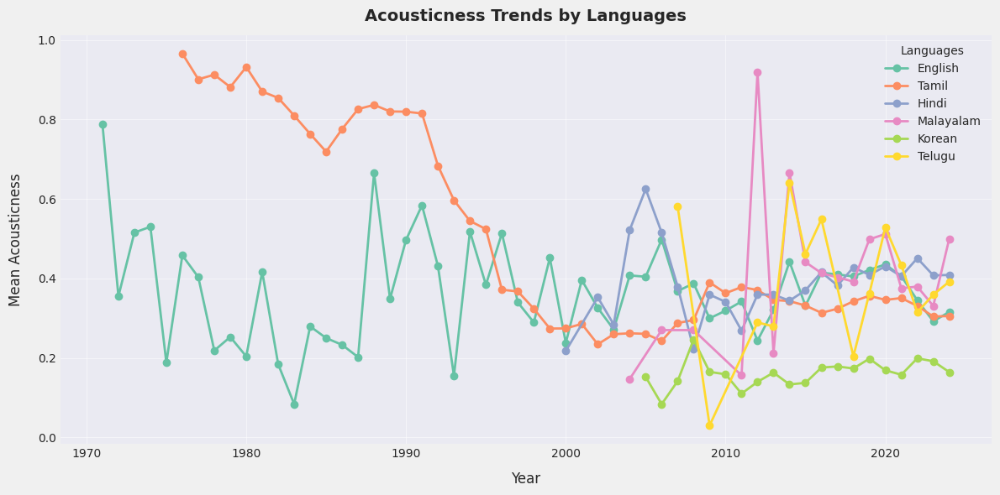

In [502]:
acousticness_trend = (spotify.groupby(['year_only', 'language'])['acousticness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=acousticness_trend['language'].nunique())

# Map each segment to a color from the palette
segments = acousticness_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = acousticness_trend[acousticness_trend['language'] == segment]
    plt.plot(data['year_only'], data['acousticness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Acousticness Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Acousticness', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

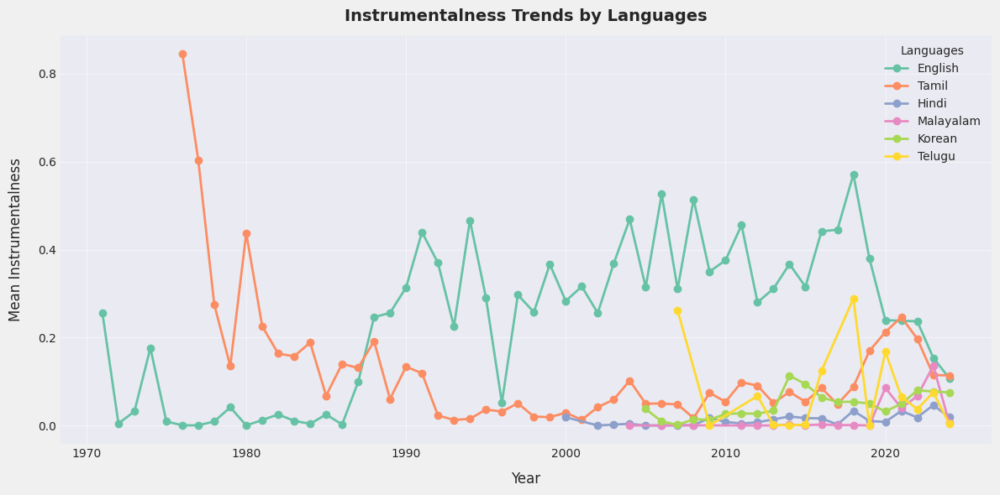

In [505]:
instrumentalness_trend = (spotify.groupby(['year_only', 'language'])['instrumentalness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=instrumentalness_trend['language'].nunique())

# Map each segment to a color from the palette
segments = instrumentalness_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = instrumentalness_trend[instrumentalness_trend['language'] == segment]
    plt.plot(data['year_only'], data['instrumentalness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Instrumentalness Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Instrumentalness', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

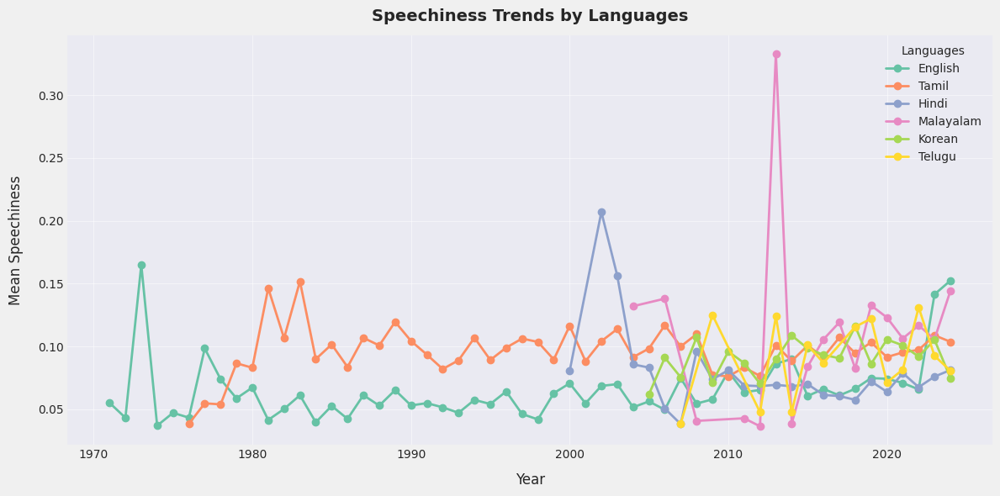

In [508]:
speechiness_trend = (spotify.groupby(['year_only', 'language'])['speechiness'].mean().reset_index())
palette = sns.color_palette("Set2", n_colors=speechiness_trend['language'].nunique())

# Map each segment to a color from the palette
segments = speechiness_trend['language'].unique()
segment_colors = dict(zip(segments, palette))

# Plot
plt.figure(figsize=(12,6), facecolor="#f0f0f0")
for segment in segments:
    data = speechiness_trend[speechiness_trend['language'] == segment]
    plt.plot(data['year_only'], data['speechiness'], marker='o', linewidth=2, label=segment, color=segment_colors[segment])

plt.title('Speechiness Trends by Languages', fontsize=14, fontweight='bold', pad=12)
plt.xlabel('Year', fontsize=12, labelpad=10)
plt.ylabel('Mean Speechiness', fontsize=12, labelpad=12)
plt.legend(title='Languages')
plt.grid(True, alpha=0.5)
plt.tight_layout()
plt.show()

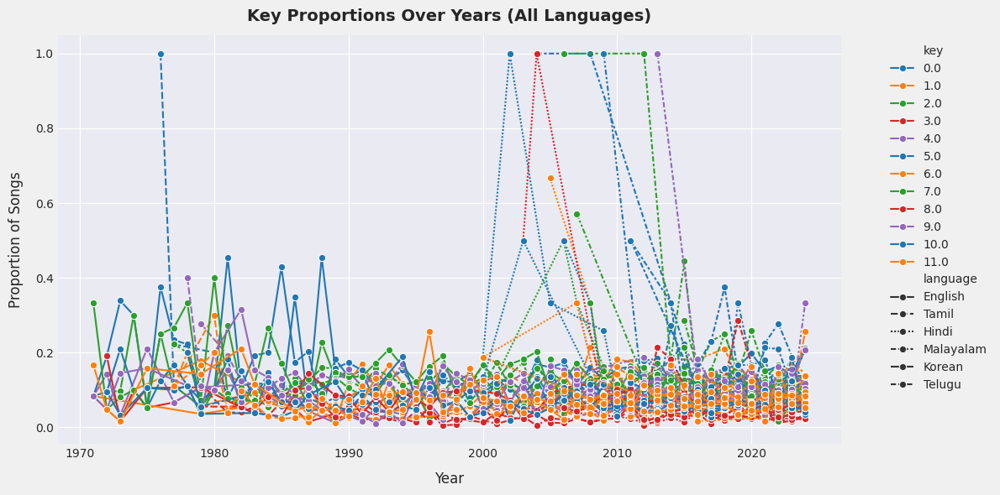

In [511]:
# Count songs per year, language, and key
key_counts = (spotify.groupby(['year_only', 'language', 'key']).size().reset_index(name='count'))
# Normalize counts within each year/language
key_counts['proportion'] = key_counts.groupby(['year_only','language'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=key_counts,x="year_only", y="proportion",hue="key", style="language", marker="o",palette=colors)
plt.title("Key Proportions Over Years (All Languages)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

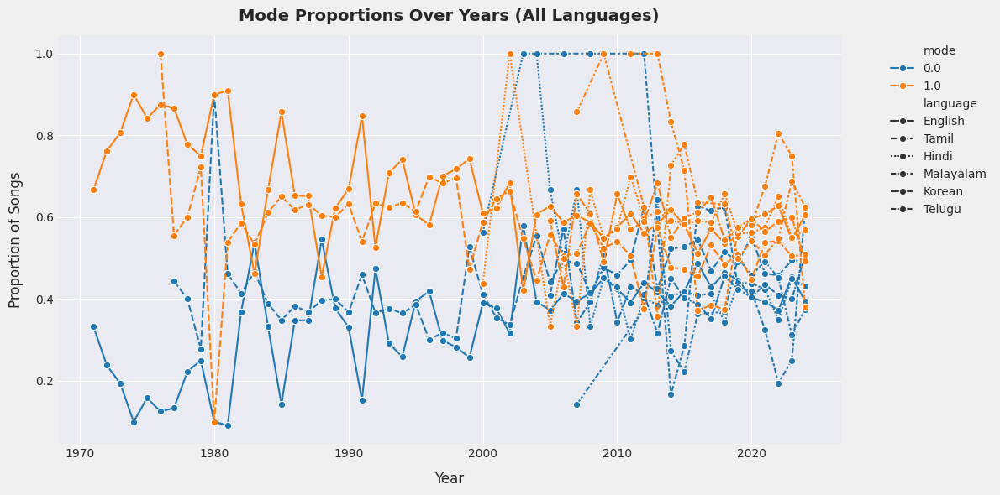

In [514]:
# Count songs per year, language, and mode
mode_counts = (spotify.groupby(['year_only', 'language', 'mode']).size().reset_index(name='count'))
# Normalize counts within each year/language
mode_counts['proportion'] = mode_counts.groupby(['year_only','language'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=mode_counts,x="year_only", y="proportion",hue="mode", style="language", marker="o",palette=colors)
plt.title("Mode Proportions Over Years (All Languages)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

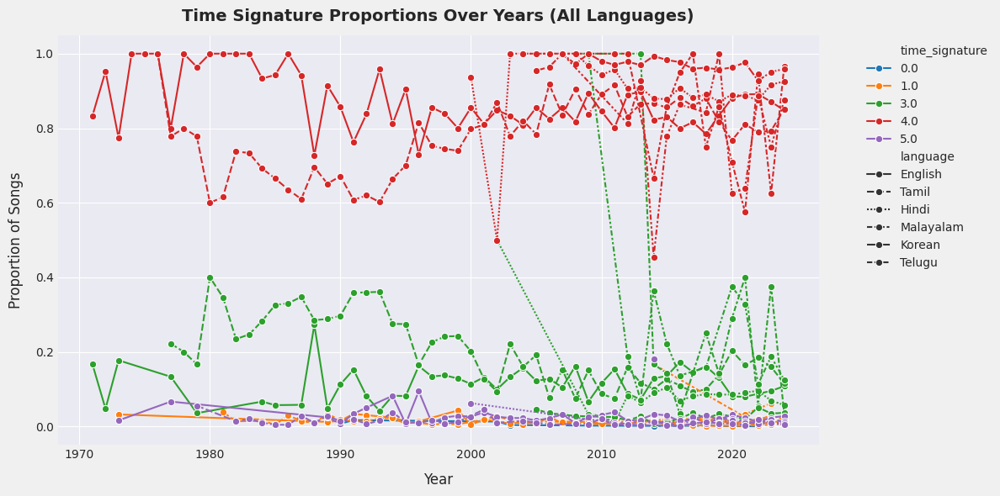

In [517]:
# Count songs per year, language, and time_signature
time_signature_counts = (spotify.groupby(['year_only', 'language', 'time_signature']).size().reset_index(name='count'))
# Normalize counts within each year/language
time_signature_counts['proportion'] = time_signature_counts.groupby(['year_only','language'])['count'].transform(lambda x: x / x.sum())

colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd"]  # customize as many as needed

plt.figure(figsize=(12,6), facecolor = ("#f0f0f0"))
sns.lineplot(data=time_signature_counts,x="year_only", y="proportion",hue="time_signature", style="language", marker="o",palette=colors)
plt.title("Time Signature Proportions Over Years (All Languages)", fontsize=14, fontweight="bold",pad = 12)
plt.xlabel("Year", fontsize = 12, labelpad = 10)
plt.ylabel("Proportion of Songs", fontsize = 12, labelpad = 10)
plt.legend(bbox_to_anchor=(1.05,1), loc="upper left")
plt.tight_layout()
plt.show()

In [520]:
# -----------------------------
# Function to plot Top/Bottom 10 with custom wrap width
# -----------------------------
def plot_top_bottom(df, column, top=True, n=10, wrap_width=25):
    """
    Plot Top or Bottom tracks based on a given column.
    Allows custom text wrapping for long track names.

    Parameters:
    df : DataFrame
    column : str -> numerical column to rank
    top : bool -> True = Top n, False = Bottom n
    n : int -> number of tracks to show
    wrap_width : int -> max characters per line in track names
    """
    # Sorting
    if top:
        result = df.sort_values(by=column, ascending=False).head(n)
        title = f"Top {n} Tracks by {column.capitalize()}"
    else:
        result = df.sort_values(by=column, ascending=True).head(n)
        title = f"Bottom {n} Tracks by {column.capitalize()}"

    # Wrap track names
    result = result.copy()
    result["track_name_wrapped"] = result["track_name"].apply(lambda x: "\n".join(textwrap.wrap(str(x), wrap_width)))

    # Plot
    plt.figure(figsize=(12,6), facecolor="#f0f0f0")
    sns.barplot(data=result,y="track_name_wrapped",x=column,hue="artist_name",dodge=False,palette="Set1")
    plt.title(title, fontsize=14, pad=12, fontweight='bold')
    plt.xlabel(column.capitalize(), labelpad=10, fontsize=12)
    plt.ylabel("Track Name", labelpad=10, fontsize=12)
    plt.legend([], [], frameon=False)  # remove cluttered legend
    plt.tight_layout()
    plt.show()

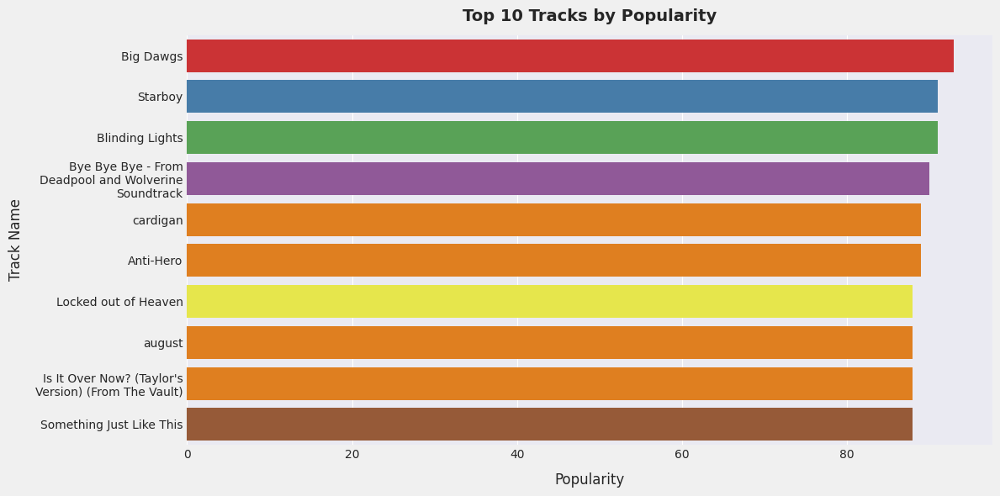

In [523]:
# Popularity
plot_top_bottom(spotify, "popularity", top=True)

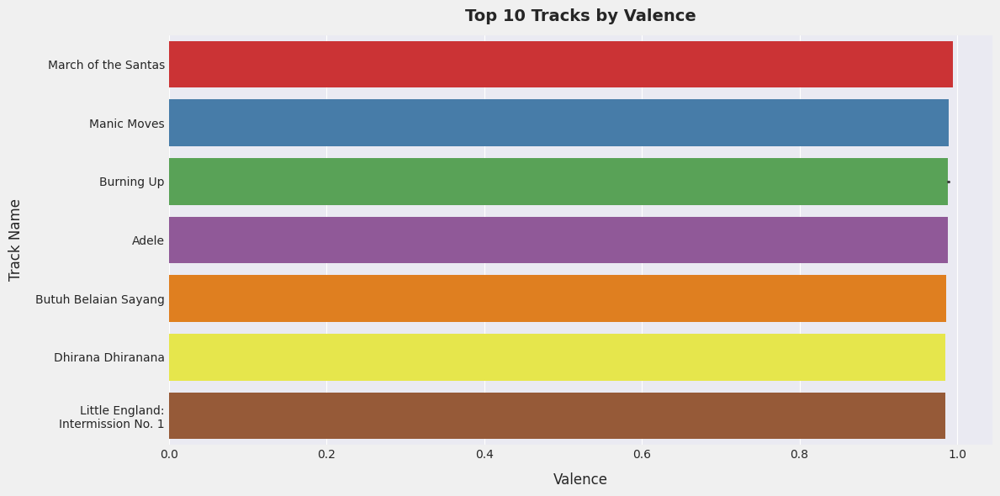

In [526]:
plot_top_bottom(spotify, "valence", top=True)

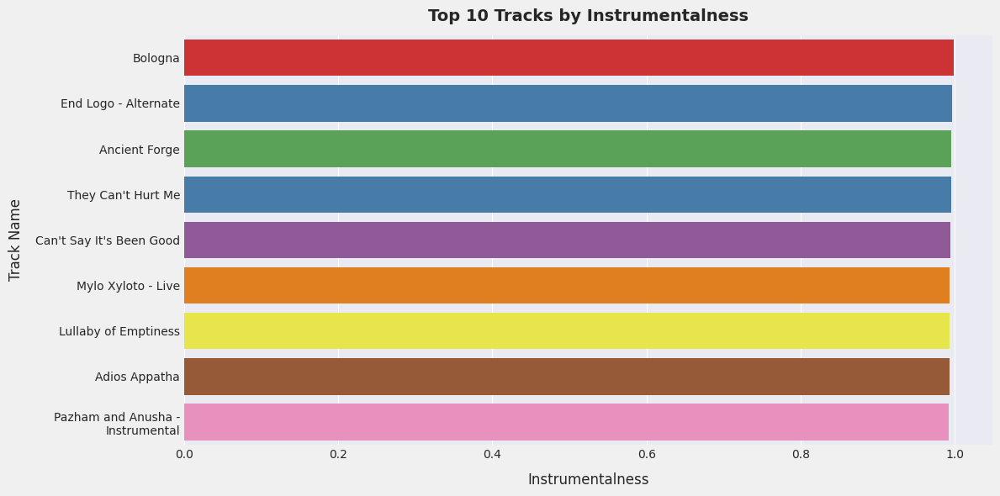

In [529]:
plot_top_bottom(spotify, "instrumentalness", top=True)

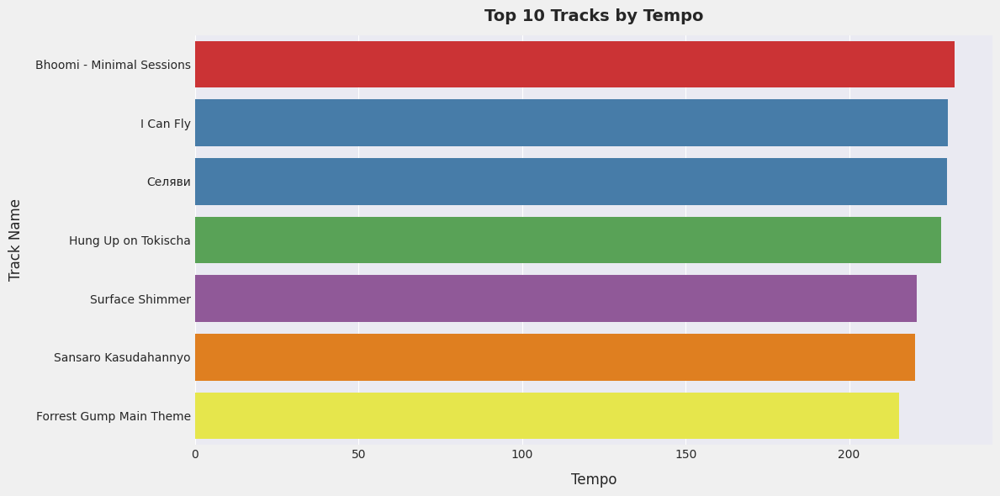

In [532]:
plot_top_bottom(spotify, "tempo", top=True)


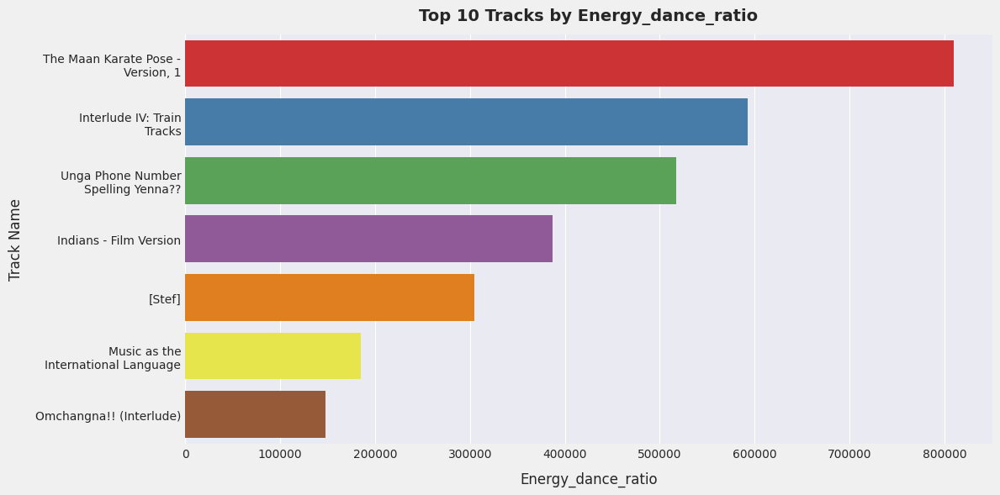

In [535]:
# Energy/Dance Ratio
plot_top_bottom(spotify, "energy_dance_ratio", top=True)

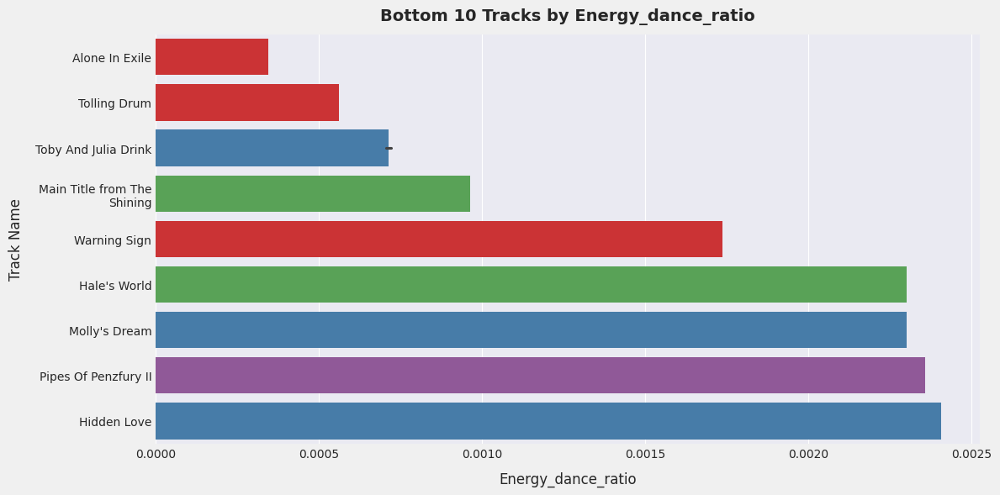

In [538]:
plot_top_bottom(spotify, "energy_dance_ratio", top=False)

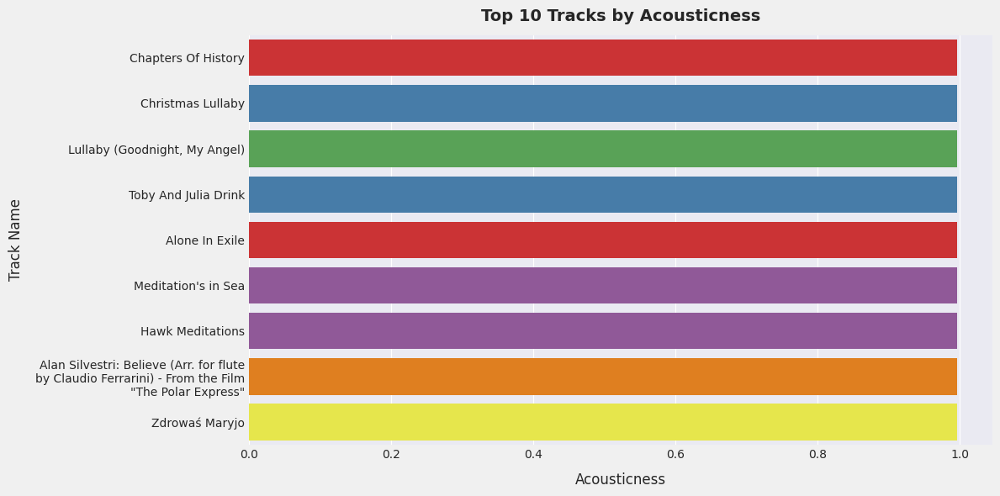

In [541]:
# Acousticness
plot_top_bottom(spotify, "acousticness", top=True, wrap_width=40)

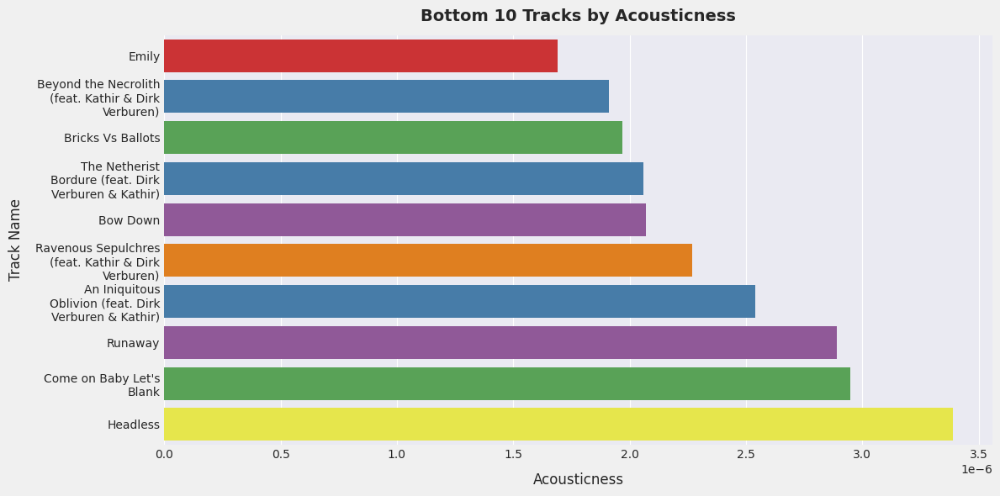

In [544]:
plot_top_bottom(spotify, "acousticness", top=False, wrap_width = 20)

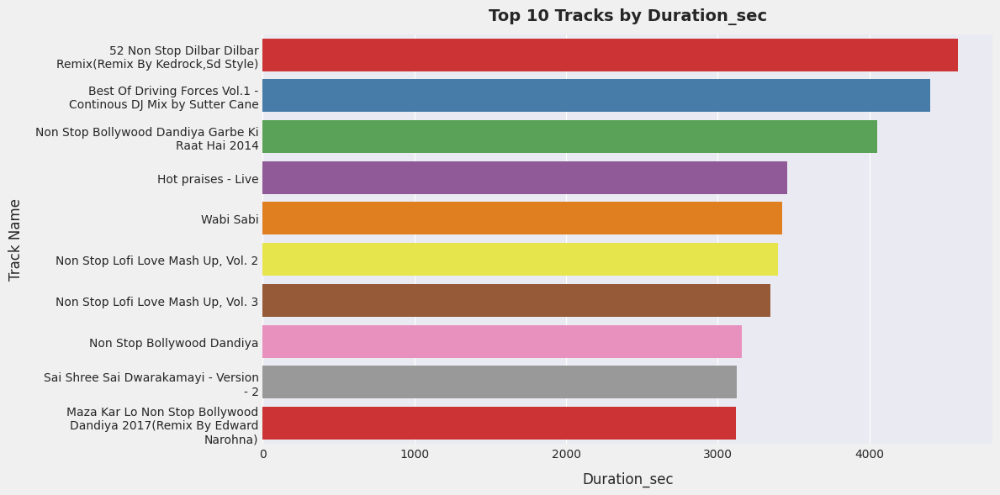

In [547]:
plot_top_bottom(spotify, "duration_sec", top=True, wrap_width=35)

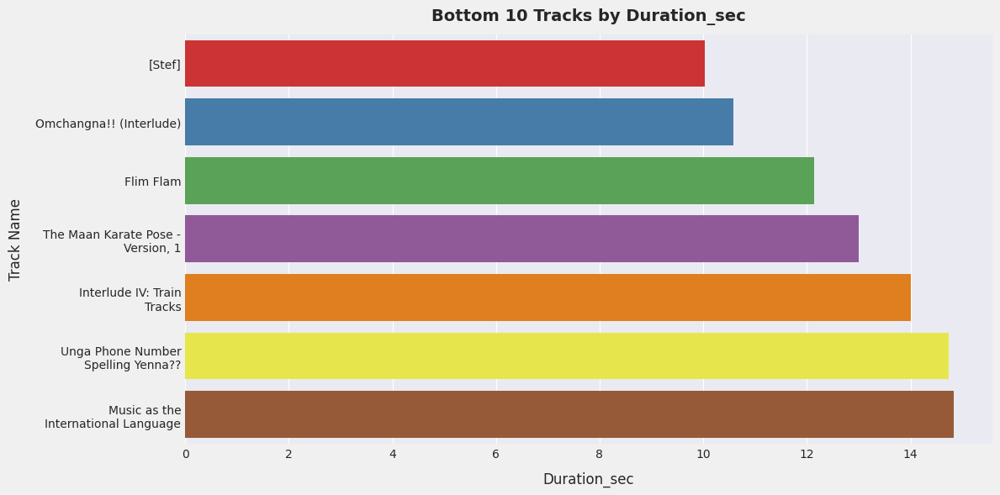

In [550]:
plot_top_bottom(spotify, "duration_sec", top=False)

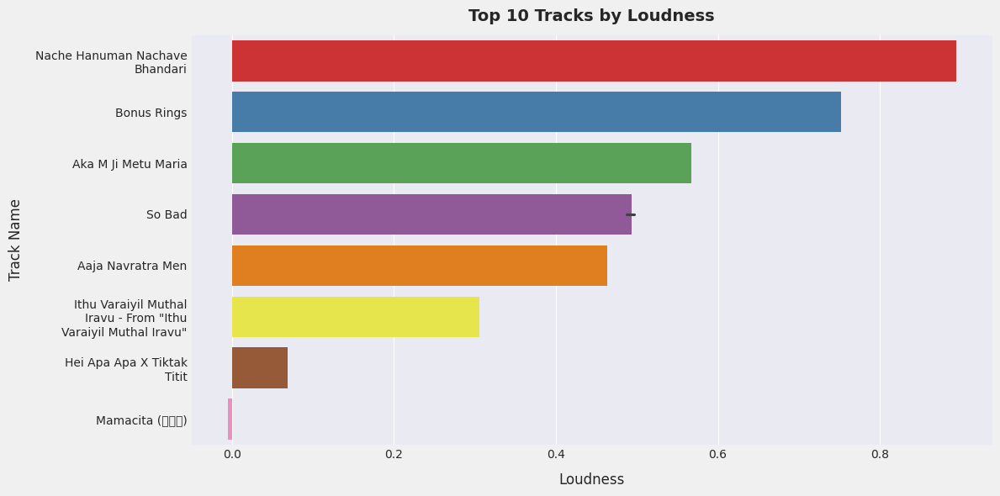

In [553]:
plot_top_bottom(spotify, "loudness", top=True)

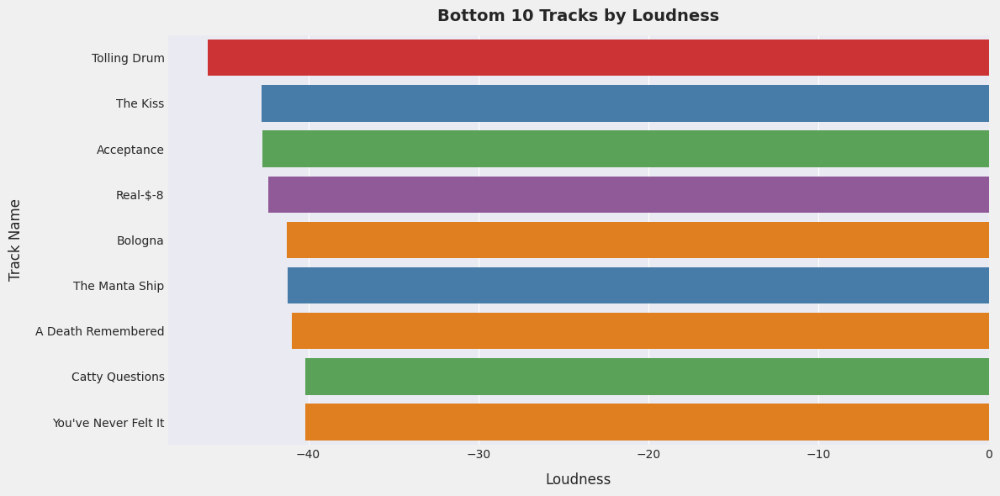

In [556]:
plot_top_bottom(spotify, "loudness", top=False)

In [559]:
# 1. Mood/Vibe Profiling (Energy vs Valence Scatterplot)
def plot_energy_valence_scatter(df):
    plt.figure(figsize=(8,6), facecolor="#f0f0f0")
    sns.scatterplot(data=df, x="energy", y="valence", size="popularity", hue="danceability", palette="coolwarm", alpha=0.7, edgecolor="k", linewidth=0.5)
    plt.title("Mood Profiling: Energy vs Valence", fontsize=14, fontweight='bold', pad = 12)
    plt.xlabel("Energy", labelpad = 10, fontweight = 12)
    plt.ylabel("Valence (Happiness)", labelpad = 10, fontweight = 12)
    plt.legend(title="Danceability", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# 2. Longest vs Shortest Popular Tracks (Duration vs Popularity)
def plot_duration_vs_popularity(df):
    plt.figure(figsize=(10,6), facecolor="#f0f0f0")
    sns.scatterplot(data=df, x="duration_sec", y="popularity", hue="artist_name", alpha=0.7, legend=False)
    plt.title("Do Longer Songs Stay Popular?", fontsize=14, fontweight='bold', pad = 12)
    plt.xlabel("Duration (sec)", fontsize= 12, labelpad = 10)
    plt.ylabel("Popularity", fontsize =12, labelpad = 10)
    plt.tight_layout()
    plt.show()

# 3. Popularity vs Features (Valence Example)
def plot_popularity_vs_valence(df):
    plt.figure(figsize=(9,6), facecolor="#f0f0f0")
    sns.regplot(data=df, x="valence", y="popularity", scatter_kws={"alpha":0.6}, line_kws={"color":"red"})
    plt.title("Do Happier Songs Get Popular?", fontsize=14, fontweight='bold', pad = 12)
    plt.xlabel("Valence (Happiness)", fontsize = 12, labelpad = 10)
    plt.ylabel("Popularity", fontsize =12, labelpad = 10)
    plt.tight_layout()
    plt.show()

# 4. Audio Fingerprint Radar Chart (Top 1 vs Bottom 1 Popularity)
def plot_radar_chart(df):
    # pick top and bottom
    top_track = df.sort_values("popularity", ascending=False).iloc[0]
    bottom_track = df.sort_values("popularity", ascending=True).iloc[0]

    # features to include
    features = ["energy", "danceability", "valence", "acousticness", "speechiness"]
    top_values = [top_track[f] for f in features]
    bottom_values = [bottom_track[f] for f in features]

    # radar setup
    N = len(features)
    angles = np.linspace(0, 2*np.pi, N, endpoint=False).tolist()
    top_values += top_values[:1]  # close the loop
    bottom_values += bottom_values[:1]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(7,7), subplot_kw=dict(polar=True), facecolor = ("#f0f0f0"))
    ax.set_theta_offset(np.pi/2)
    ax.set_theta_direction(-1)

    # draw labels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(features, fontsize=11)

    # plot top
    ax.plot(angles, top_values, color="green", linewidth=2, label=f"Top Track: {top_track['track_name']}")
    ax.fill(angles, top_values, color="green", alpha=0.25)

    # plot bottom
    ax.plot(angles, bottom_values, color="red", linewidth=2, label=f"Bottom Track: {bottom_track['track_name']}")
    ax.fill(angles, bottom_values, color="red", alpha=0.25)

    plt.title("Audio Fingerprint: Top vs Bottom Popular Track", fontsize=14, fontweight="bold", pad=40)
    plt.legend(loc="upper right", bbox_to_anchor=(1.3, 1.1))
    plt.show()

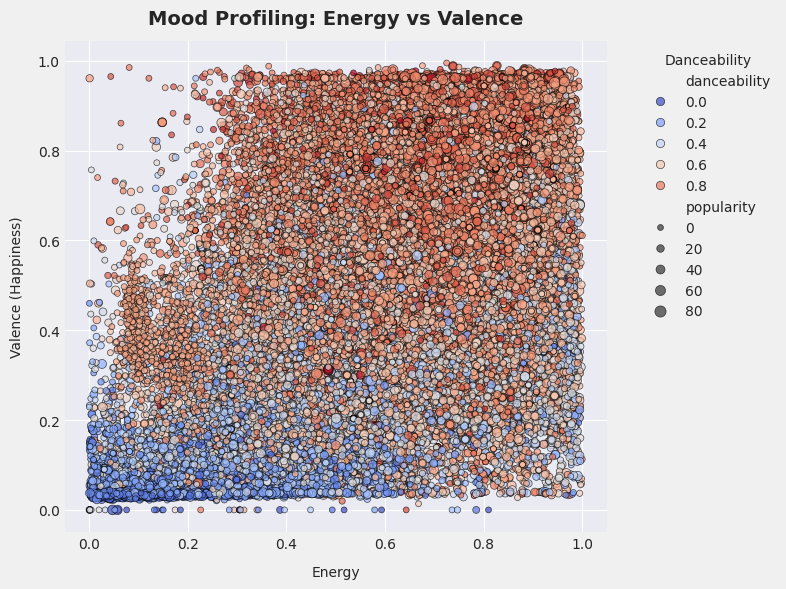

In [562]:
plot_energy_valence_scatter(spotify)

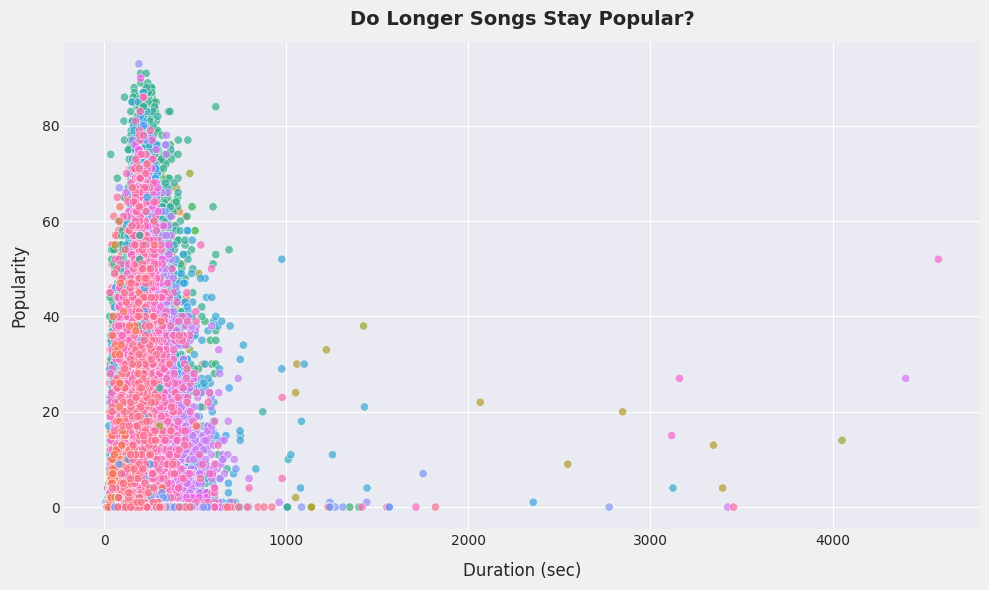

In [565]:
plot_duration_vs_popularity(spotify)

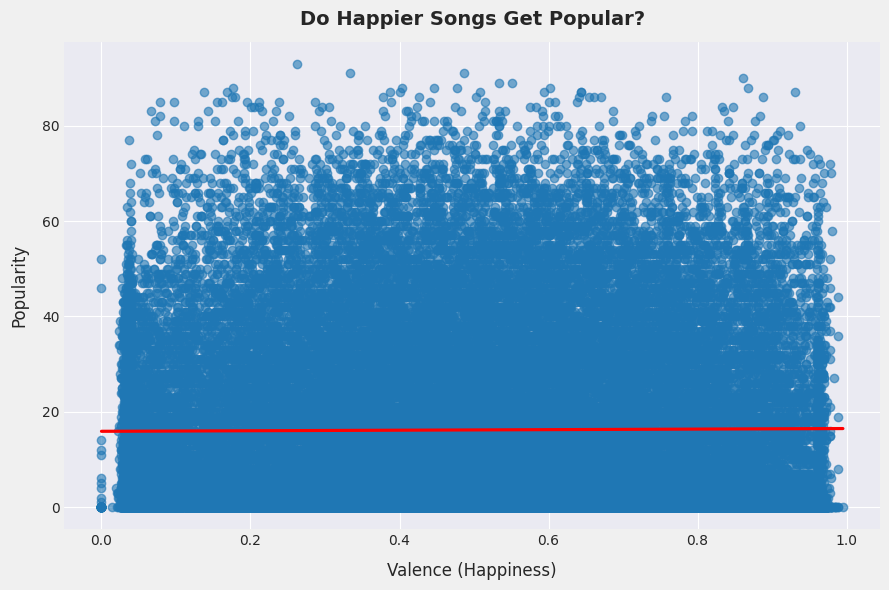

In [568]:
plot_popularity_vs_valence(spotify)

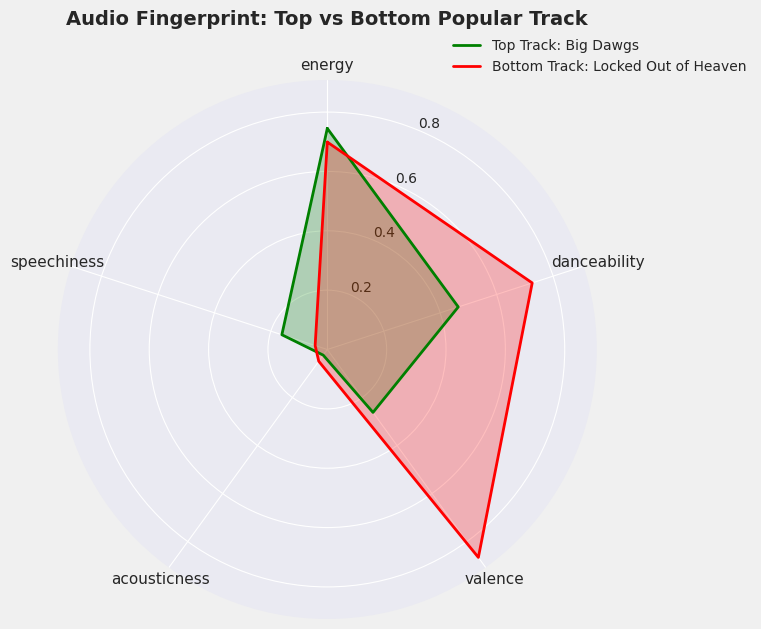

In [571]:
plot_radar_chart(spotify)

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=c08ae31d-812d-4c44-919e-60206e5c1672' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>